In [1]:
# import numpy as np
# import pandas as pd
# import matplotlib.pyplot as plt
# from matplotlib.gridspec import GridSpec
# from scipy.optimize import curve_fit
# from scipy.stats import linregress
# import astropy.modeling
# from scipy.stats import gamma, lognorm
# from scipy import interpolate
# from scipy.interpolate import CubicSpline
# from sklearn.gaussian_process import GaussianProcessRegressor
# from sklearn.gaussian_process.kernels import RBF, ConstantKernel as C
from funs_CTA102masterCodev4 import *


# Calculation of PDS, PDF and models fitting of the original LC:

LINEAR REGRESSION:
------------------------
Fitted Linear Regression Parameters:
Slope (a) = -1.3093484246164047
Intercept (b) = -11.5477781886884
Chi-squared: 2.8852792986


POWER LAW:
------------------------
Best-fit parameters: a = -3.677425583089386e-11, b = 0.89
Chi-squared: 6.7444457401


BROKEN POWER LAW:
------------------------
Best-fit parameters: alpha1 = 0.88712, alpha2 = 20.03170, Amplitude =  5.002e-10, x_break = 0.05492
Chi-squared: 5.1760059797


CURVED BROKEN POWER LAW:
------------------------
Best-fit parameters: alpha1 = -0.11380261746392802, Alpha2 = -1.558629698683597, Beta = 4.29343050536069e-12
Chi-squared: 4.12800
Kappa, loc, theta 0.06776246804370306 2.2999999999999998e-08 1


/home/loramaya/funs_CTA102masterCodev4.py:40: RuntimeWarning: divide by zero encountered in log10
  freq = np.array(np.log10(frqj))
/home/loramaya/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/loramaya/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/loramaya/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/loramaya/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:226: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/home/loramaya/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:261: RuntimeWarning: invalid value encountered in scalar divide


,Number Points,LC/LC section,Kappa,Theta,lnmu,lnsig,dPDF,dPDFlog,PDF,PDFlog
0,727,Original,0.067762,1,-0.715743,1.196448,"[0.0, 1.3113113113113113e-08, 2.62262262262262...","[0.0, 1.3113113113113113e-08, 2.62262262262262...","[0.0, 0.0, 5784969.197796982, 1274978.07720552...","[0.0, 1013483.697252679, 1864857.459270747, 22..."


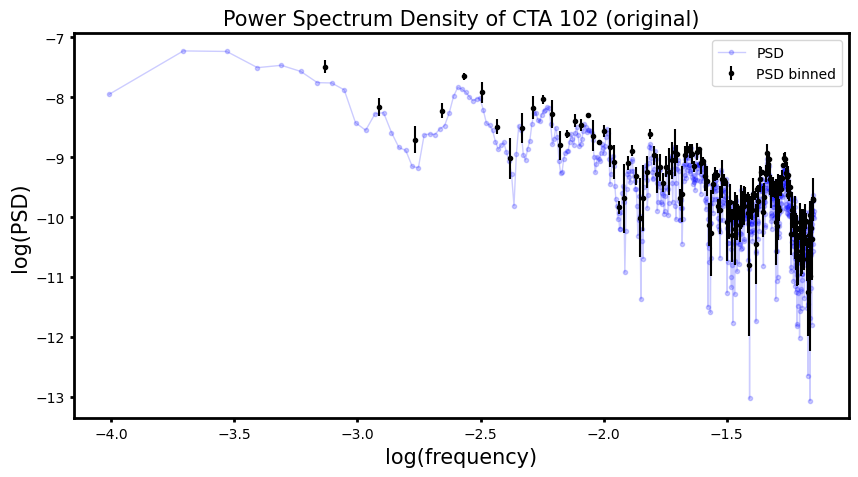

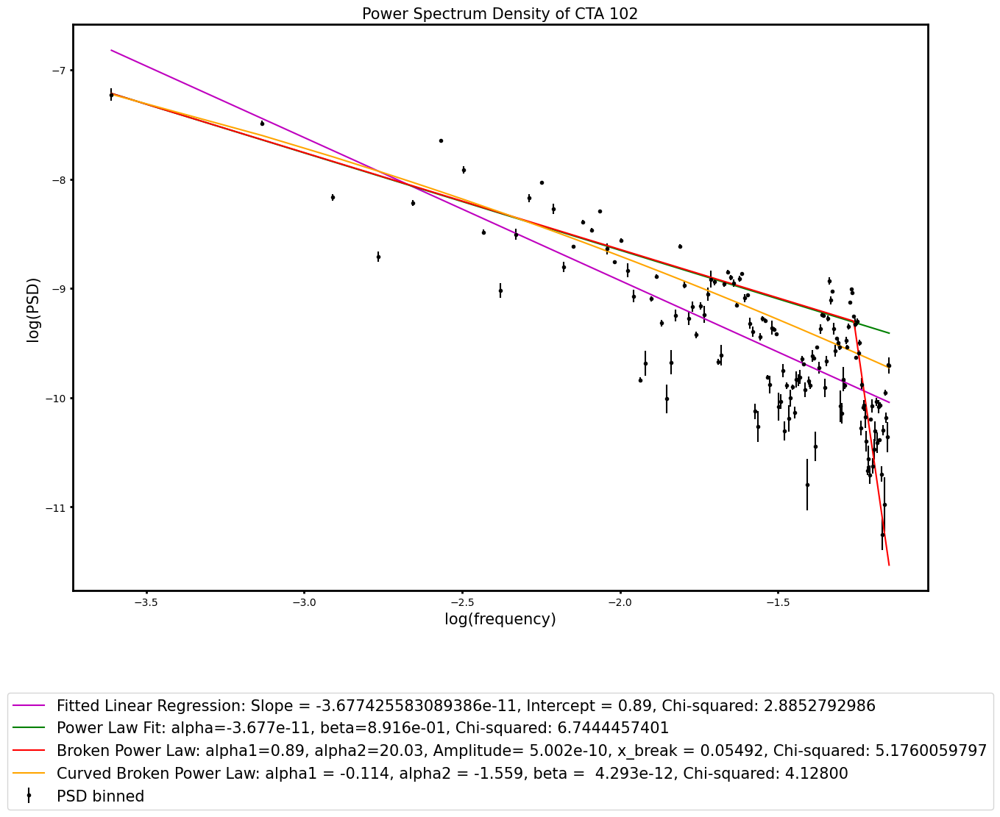

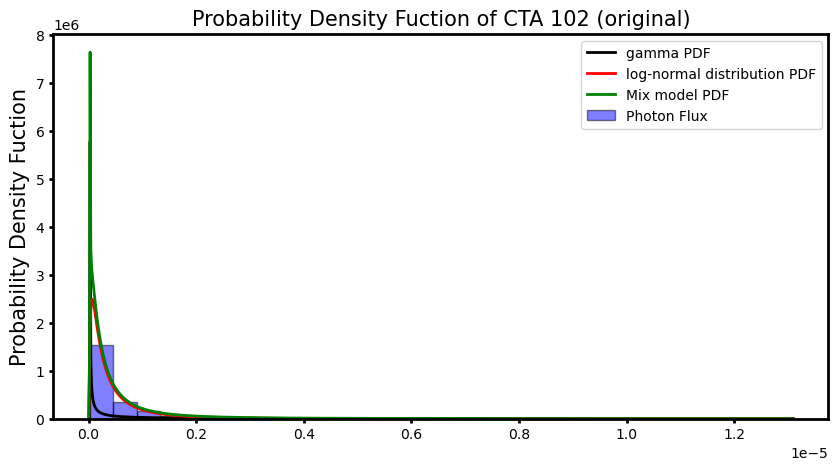

In [2]:
CTA_data = pd.read_csv('4FGL_J2232.6+1143_weekly_17_10_2023.csv')
CTA_data_filtered = CTA_data[~CTA_data['Photon Flux [0.1-100 GeV](photons cm-2 s-1)'].str.contains('<|>', na=False, case=False)]
CTA_data_filtered.to_csv('CTA102_filtlight.csv')

CTAdata = pd.read_csv('CTA102_filtlight.csv')

fig, g = plt.subplots(figsize=(10, 5))
fig.set_facecolor('white')
dft, fj, fmean, rpsd, err_psd = psd_cal(CTAdata['Julian Date'], CTAdata['Photon Flux [0.1-100 GeV](photons cm-2 s-1)'], CTAdata['Photon Flux Error(photons cm-2 s-1)'])
plot_psd(dft, fj, fmean, rpsd, err_psd,'Power Spectrum Density of CTA 102 (original)', g)
add_datapsd(len(CTAdata['Julian Date']), 'Original', dft, fj, rpsd, fmean, err_psd)

initials_PL = [-1, 10**-1.3093484246164047]
initials_BPL = [1, 1, 1, 1]
initials_CPL = [-10, -1, 10]
models_fit(fmean, rpsd, err_psd, initials_PL, initials_BPL, initials_CPL)


fig, g = plt.subplots(figsize=(10, 5))
fig.set_facecolor('white')
kappa, theta, lnmu, lnsig, data_pdf, data_pdf2, pdf_light, pdf_light2 = pdf_cal(CTAdata['Photon Flux [0.1-100 GeV](photons cm-2 s-1)'])
plot_pdf(data_pdf, data_pdf2, pdf_light, pdf_light2, 'Probability Density Fuction of CTA 102 (original)',CTAdata['Photon Flux [0.1-100 GeV](photons cm-2 s-1)'], g)
add_datapdfs(len(CTAdata['Julian Date']), 'Original', kappa, theta, lnmu, lnsig, data_pdf, data_pdf2, pdf_light, pdf_light2)


In [3]:
file_filt = pd.DataFrame()

file_filt['Time'] = CTA_data_filtered['Julian Date']
file_filt['Flux'] = CTA_data_filtered['Photon Flux [0.1-100 GeV](photons cm-2 s-1)']
file_filt['Flux error'] = CTA_data_filtered['Photon Flux Error(photons cm-2 s-1)']
file_filt.to_csv('lightcurveCTA102_filtered.txt', sep='\t', index=False)

# Simulate your input LC

In [4]:
CTA102_sim = pd.read_csv('lightcurveCTA102_sim.dat', sep=r'\s+', comment = '#', names = ['Time', 'Flux'], engine = 'python')


# Simulate a new LC with the same PDF as the input LC and:

## a) Simple Power law

In [5]:
CTA102_sim_simple = pd.read_csv('lightcurveCTA102_sim_simple.dat', sep=r'\s+', comment = '#', names = ['Time', 'Flux'], engine = 'python')


## b) Broken Power Law

In [6]:
CTA102_sim_broken = pd.read_csv('lightcurveCTA102_sim_broken.dat', sep=r'\s+', comment = '#', names = ['Time', 'Flux'], engine = 'python')


## c) Curved Power law: Exponential Cut-off Power Law 1D

In [7]:
CTA102_sim_curved = pd.read_csv('lightcurveCTA102_sim_curved.dat', sep=r'\s+', comment = '#', names = ['Time', 'Flux'], engine = 'python')


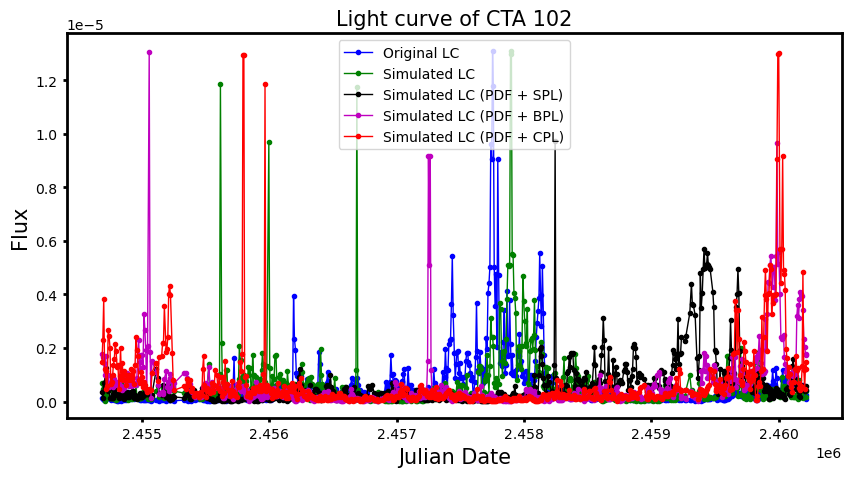

In [8]:
fig, g = plt.subplots(figsize=(10, 5))
fig.set_facecolor('white')
g.plot(CTAdata['Julian Date'], CTAdata['Photon Flux [0.1-100 GeV](photons cm-2 s-1)'],'b-o',linewidth=1, markersize = 3, label = 'Original LC')
g.plot(CTA102_sim['Time'], CTA102_sim['Flux'],'g-o',linewidth=1, markersize = 3, label = 'Simulated LC')
g.plot(CTA102_sim_simple['Time'], CTA102_sim_simple['Flux'],'k-o',linewidth=1, markersize = 3, label = 'Simulated LC (PDF + SPL)')
g.plot(CTA102_sim_broken['Time'], CTA102_sim_broken['Flux'],'m-o',linewidth=1, markersize = 3, label = 'Simulated LC (PDF + BPL)')
g.plot(CTA102_sim_curved['Time'], CTA102_sim_curved['Flux'],'r-o',linewidth=1, markersize = 3, label = 'Simulated LC (PDF + CPL)')
g.set_ylabel('Flux',fontsize=15)
g.set_xlabel('Julian Date',fontsize=15)
plt.title('Light curve of CTA 102',fontsize=15)
g.legend(fontsize = 10, loc = 'upper center')
for spine in ['top', 'right','bottom','left']:
    g.spines[spine].set_linewidth(2)
g.tick_params(labelsize=10,length=3,width=2)

# Remove data, calculate the PSD and PDF.

Mean = 7.475166666666669e-08
Median = 7.389999999999999e-08
STD = 2.304665913364065e-08
Number of limits = 55
Mean / Median = 1.0115245827695087


/tmp/ipykernel_7667/1937922987.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  CTA_data_upperlimits['Photon upper limit'] = pd.to_numeric(CTA_data_upperlimits['Photon Flux [0.1-100 GeV](photons cm-2 s-1)'].str.replace('<', ''))


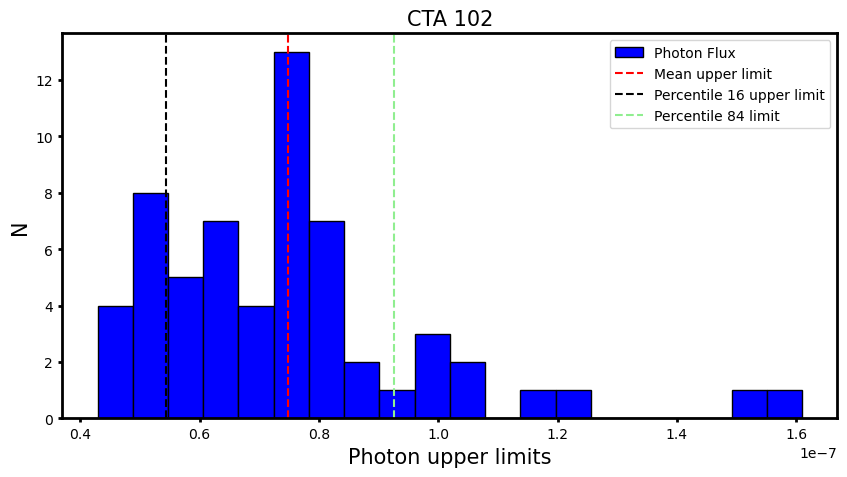

In [9]:
CTA_data_upperlimits = CTA_data[CTA_data['Photon Flux [0.1-100 GeV](photons cm-2 s-1)'].str.contains('<|>', na=False)]
CTA_data_upperlimits['Photon upper limit'] = pd.to_numeric(CTA_data_upperlimits['Photon Flux [0.1-100 GeV](photons cm-2 s-1)'].str.replace('<', ''))
CTA_data_upperlimits = CTA_data_upperlimits.reset_index(drop=True)
fig, g = plt.subplots(figsize=(10, 5))
fig.set_facecolor('white')
g.hist(CTA_data_upperlimits['Photon upper limit'], bins=20, color = 'blue', label=r'Photon Flux', edgecolor = 'black')
g.axvline(x = np.mean(CTA_data_upperlimits['Photon upper limit']), color='red', linestyle='--', label = 'Mean upper limit')
g.axvline(x = np.percentile(CTA_data_upperlimits['Photon upper limit'], 16), color='black', linestyle='--', label = 'Percentile 16 upper limit')
g.axvline(x = np.percentile(CTA_data_upperlimits['Photon upper limit'], 84), color='lightgreen', linestyle='--', label = 'Percentile 84 limit')
g.set_ylabel('N',fontsize=15)
g.set_xlabel('Photon upper limits',fontsize=15)
plt.title('CTA 102',fontsize=15)
g.legend(loc ='upper right')
for spine in ['top', 'right','bottom','left']:
    g.spines[spine].set_linewidth(2)
g.tick_params(labelsize=10,length=3,width=2)
print('Mean =', np.mean(CTA_data_upperlimits['Photon upper limit']))
print('Median =', np.median(CTA_data_upperlimits['Photon upper limit']))
print('STD =', np.std(CTA_data_upperlimits['Photon upper limit']))
print('Number of limits =', len(CTA_data_upperlimits['Photon upper limit'].unique()))
print('Mean / Median =', np.mean(CTA_data_upperlimits['Photon upper limit']) / np.median(CTA_data_upperlimits['Photon upper limit']))


/home/loramaya/funs_CTA102masterCodev4.py:40: RuntimeWarning: divide by zero encountered in log10
  freq = np.array(np.log10(frqj))
/home/loramaya/funs_CTA102masterCodev4.py:383: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_psd0 = data_psd0.append({'Number Points':n,'LC/LC section': LCp, 'PSD': PSD, 'Freq': Freq, 'PSDb':PSDb, 'Freqmean':Freqmean, 'err': errpsd}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:40: RuntimeWarning: divide by zero encountered in log10
  freq = 

Kappa, loc, theta 0.06780348944750392 3.9450458819999996e-08 1
Kappa, loc, theta 0.12886120513828242 2.9593028001999998e-08 1


/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:40: RuntimeWarning: divide by zero encountered in log10
  freq = np.array(np.log10(frqj))
/home/loramaya/funs_CTA102masterCodev4.py:383: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_psd0 = data_psd0.append({'Number Points':n,'LC/LC section': LCp, 'PSD': PSD, 'Freq': Freq, 'PSDb':PSDb, 'Freqmean':Freqmean, 'err': errpsd}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and wil

Kappa, loc, theta 0.07536688158861306 1.2030045777999998e-07 1
Kappa, loc, theta 0.10458826967433224 2.3417798269999997e-08 1


/home/loramaya/funs_CTA102masterCodev4.py:40: RuntimeWarning: divide by zero encountered in log10
  freq = np.array(np.log10(frqj))
/home/loramaya/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/loramaya/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/loramaya/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/loramaya/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:226: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/home/loramaya/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:261: RuntimeWarning: invalid value encountered in scalar divide


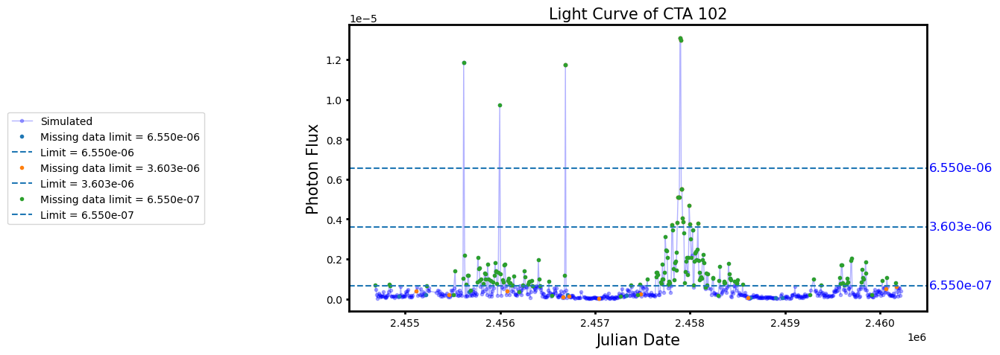

In [10]:
vkr, vtr, vlnr, vlsr,vdpfl, vdpfl2, vpdfl1, vpdfl2, limit_v, data_r, dftr_v, fjr_v, fmeanr_v, rpsdr_v, errpsdr_v = rem_cal(CTA102_sim, CTAdata)
data_S = data_r
limit_S = limit_v


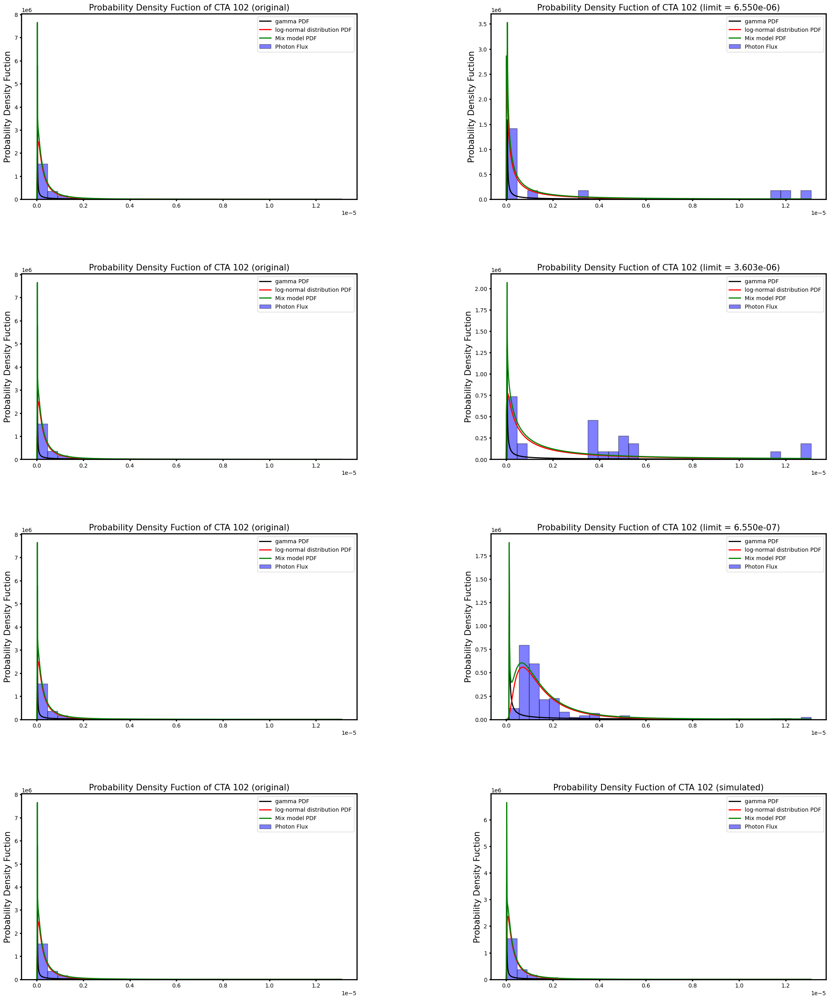

In [11]:
fig2 = plt.figure(figsize=(25, 30))
fig2.set_facecolor('white')
gs = GridSpec(len(limit_v), 2, figure=fig2)
plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

for jl in range(len(limit_v)-1):    
    g = fig2.add_subplot(gs[jl, 0])
    plot_pdf(data_pdf, data_pdf2, pdf_light, pdf_light2, 'Probability Density Fuction of CTA 102 (original)', CTAdata['Photon Flux [0.1-100 GeV](photons cm-2 s-1)'], g)

    g = fig2.add_subplot(gs[jl, 1])
    plot_pdf(vdpfl[jl], vdpfl2[jl], vpdfl1[jl], vpdfl2[jl], 'Probability Density Fuction of CTA 102 (limit = {:.3e})'.format(limit_v[jl]), data_r[jl]['Flux'], g )

g = fig2.add_subplot(gs[jl+1, 0])
plot_pdf(data_pdf, data_pdf2, pdf_light, pdf_light2, 'Probability Density Fuction of CTA 102 (original)', CTAdata['Photon Flux [0.1-100 GeV](photons cm-2 s-1)'], g)

g = fig2.add_subplot(gs[jl+1, 1])
plot_pdf(vdpfl[jl+1], vdpfl2[jl+1], vpdfl1[jl+1], vpdfl2[jl+1], 'Probability Density Fuction of CTA 102 (simulated)', data_r[jl+1]['Flux'], g )


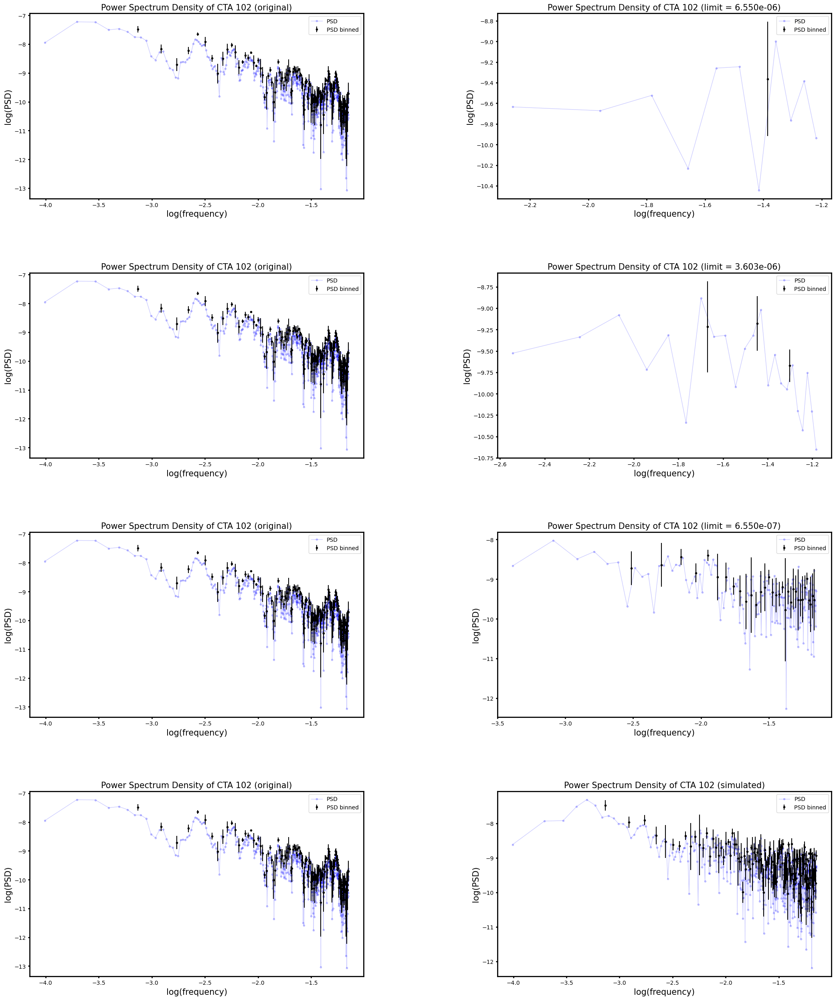

In [12]:
fig2 = plt.figure(figsize=(25, 30))
fig2.set_facecolor('white')
gs = GridSpec(len(limit_v), 2, figure=fig2)
plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

for jl in range(len(limit_v)-1):    
    g = fig2.add_subplot(gs[jl, 0])
    plot_psd(dft, fj, fmean, rpsd, err_psd,'Power Spectrum Density of CTA 102 (original)', g)
    
    g = fig2.add_subplot(gs[jl, 1])
    plot_psd(dftr_v[jl], fjr_v[jl], fmeanr_v[jl], rpsdr_v[jl], errpsdr_v[jl],'Power Spectrum Density of CTA 102 (limit = {:.3e})'.format(limit_v[jl]), g)
    
g = fig2.add_subplot(gs[jl+1, 0])
plot_psd(dft, fj, fmean, rpsd, err_psd,'Power Spectrum Density of CTA 102 (original)', g)
    
g = fig2.add_subplot(gs[jl+1, 1])
plot_psd(dftr_v[jl+1], fjr_v[jl+1], fmeanr_v[jl+1], rpsdr_v[jl+1], errpsdr_v[jl+1],'Power Spectrum Density of CTA 102 (simulated)', g)    


/home/loramaya/funs_CTA102masterCodev4.py:40: RuntimeWarning: divide by zero encountered in log10
  freq = np.array(np.log10(frqj))
/home/loramaya/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/loramaya/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/loramaya/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/loramaya/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:226: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/home/loramaya/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:261: RuntimeWarning: invalid value encountered in scalar divide


Kappa, loc, theta 0.05406390513751014 6.899318893699999e-08 1
Kappa, loc, theta 0.0739639874500799 6.160483880999999e-08 1
Kappa, loc, theta 0.07561467323999616 3.517973992699999e-08 1
Kappa, loc, theta 0.06814986005882802 2.3124009443999995e-08 1


/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:40: RuntimeWarning: divide by zero encountered in log10
  freq = np.array(np.log10(frqj))
/home/loramaya/anaconda3/lib/python3.9/site-

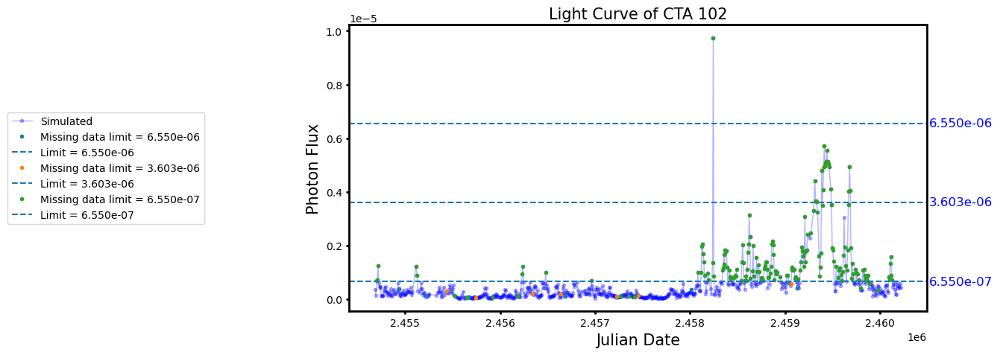

In [13]:
vkr, vtr, vlnr, vlsr,vdpfl, vdpfl2, vpdfl1, vpdfl2, limit_v, data_r, dftr_v, fjr_v, fmeanr_v, rpsdr_v, errpsdr_v = rem_cal(CTA102_sim_simple, CTAdata)
data_SSPL = data_r
limit_SSPL = limit_v


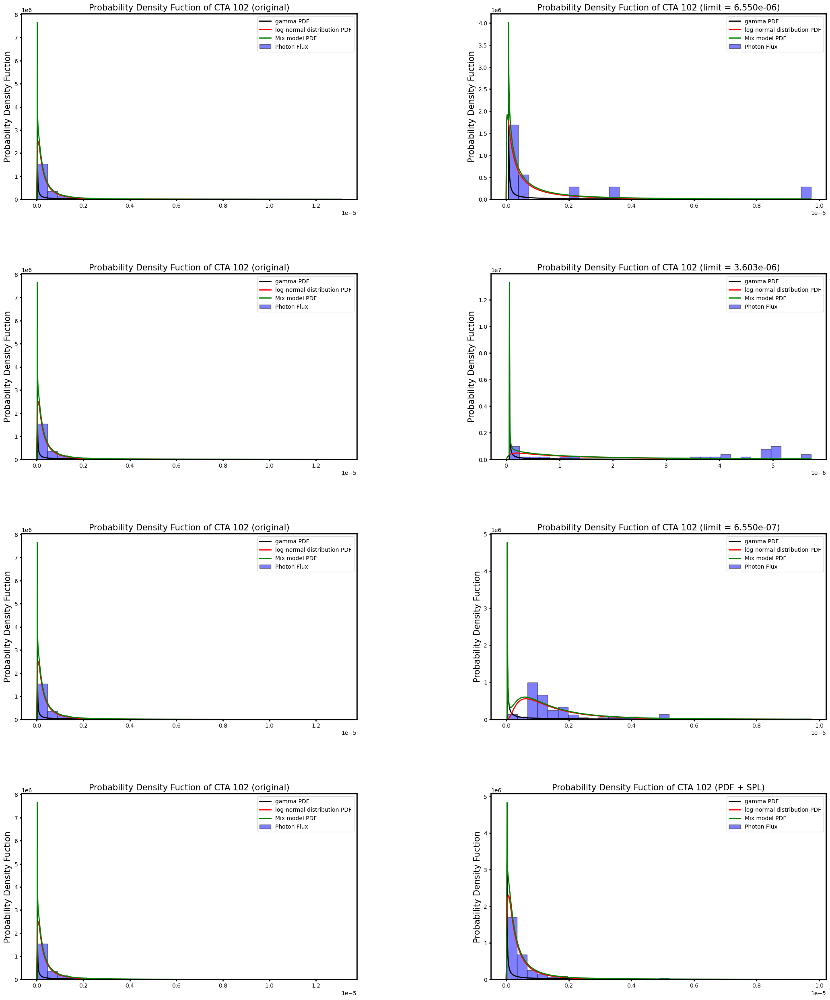

In [14]:
fig2 = plt.figure(figsize=(25, 30))
fig2.set_facecolor('white')
gs = GridSpec(len(limit_v), 2, figure=fig2)
plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

for jl in range(len(limit_v)-1):    
    g = fig2.add_subplot(gs[jl, 0])
    plot_pdf(data_pdf, data_pdf2, pdf_light, pdf_light2, 'Probability Density Fuction of CTA 102 (original)', CTAdata['Photon Flux [0.1-100 GeV](photons cm-2 s-1)'], g)

    g = fig2.add_subplot(gs[jl, 1])
    plot_pdf(vdpfl[jl], vdpfl2[jl], vpdfl1[jl], vpdfl2[jl], 'Probability Density Fuction of CTA 102 (limit = {:.3e})'.format(limit_v[jl]), data_r[jl]['Flux'], g )

g = fig2.add_subplot(gs[jl+1, 0])
plot_pdf(data_pdf, data_pdf2, pdf_light, pdf_light2, 'Probability Density Fuction of CTA 102 (original)', CTAdata['Photon Flux [0.1-100 GeV](photons cm-2 s-1)'], g)

g = fig2.add_subplot(gs[jl+1, 1])
plot_pdf(vdpfl[jl+1], vdpfl2[jl+1], vpdfl1[jl+1], vpdfl2[jl+1], 'Probability Density Fuction of CTA 102 (PDF + SPL)', data_r[jl+1]['Flux'], g )


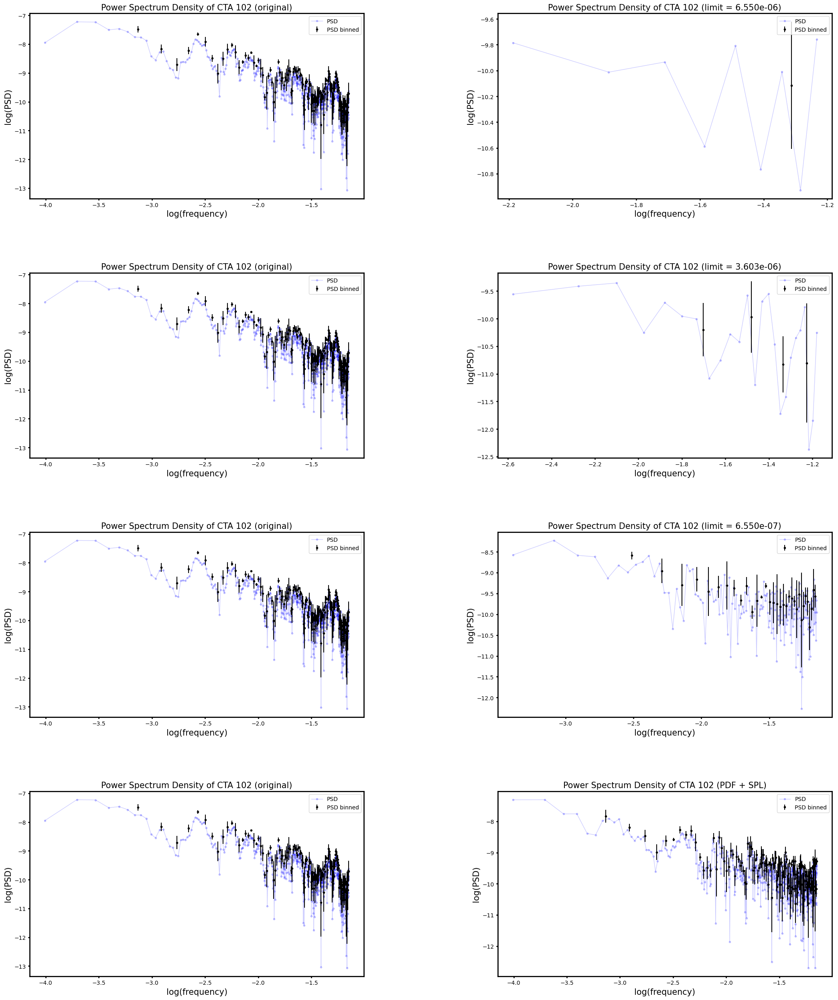

In [15]:
fig2 = plt.figure(figsize=(25, 30))
fig2.set_facecolor('white')
gs = GridSpec(len(limit_v), 2, figure=fig2)
plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

for jl in range(len(limit_v)-1):    
    g = fig2.add_subplot(gs[jl, 0])
    plot_psd(dft, fj, fmean, rpsd, err_psd, 'Power Spectrum Density of CTA 102 (original)', g)
    
    g = fig2.add_subplot(gs[jl, 1])
    plot_psd(dftr_v[jl], fjr_v[jl], fmeanr_v[jl], rpsdr_v[jl], errpsdr_v[jl], 'Power Spectrum Density of CTA 102 (limit = {:.3e})'.format(limit_v[jl]), g)
    
g = fig2.add_subplot(gs[jl+1, 0])
plot_psd(dft, fj, fmean, rpsd, err_psd,'Power Spectrum Density of CTA 102 (original)', g)
    
g = fig2.add_subplot(gs[jl+1, 1])
plot_psd(dftr_v[jl+1], fjr_v[jl+1], fmeanr_v[jl+1], rpsdr_v[jl+1], errpsdr_v[jl+1], 'Power Spectrum Density of CTA 102 (PDF + SPL)', g)    


/home/loramaya/funs_CTA102masterCodev4.py:40: RuntimeWarning: divide by zero encountered in log10
  freq = np.array(np.log10(frqj))
/home/loramaya/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/loramaya/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/loramaya/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/loramaya/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:226: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/home/loramaya/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:261: RuntimeWarning: invalid value encountered in scalar divide


Kappa, loc, theta 0.06578137497880424 1.0985108612999999e-07 1
Kappa, loc, theta 0.06591135455427063 1.0234397665999998e-07 1
Kappa, loc, theta 0.07139071741359426 7.032700860799999e-08 1
Kappa, loc, theta 0.0682006899950677 2.3403194738999996e-08 1


/home/loramaya/funs_CTA102masterCodev4.py:40: RuntimeWarning: divide by zero encountered in log10
  freq = np.array(np.log10(frqj))
/home/loramaya/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/loramaya/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/loramaya/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/loramaya/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:226: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/home/loramaya/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:261: RuntimeWarning: invalid value encountered in scalar divide


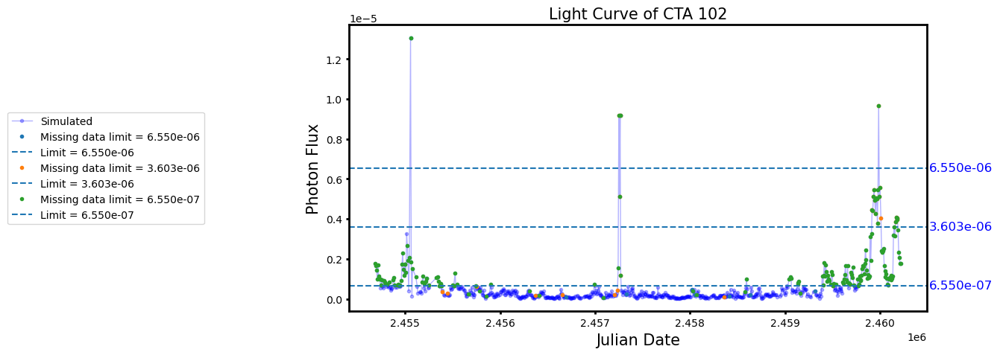

In [16]:
vkr, vtr, vlnr, vlsr,vdpfl, vdpfl2, vpdfl1, vpdfl2, limit_v, data_r, dftr_v, fjr_v, fmeanr_v, rpsdr_v, errpsdr_v = rem_cal(CTA102_sim_broken, CTAdata)
data_SBPL = data_r
limit_SBPL = limit_v


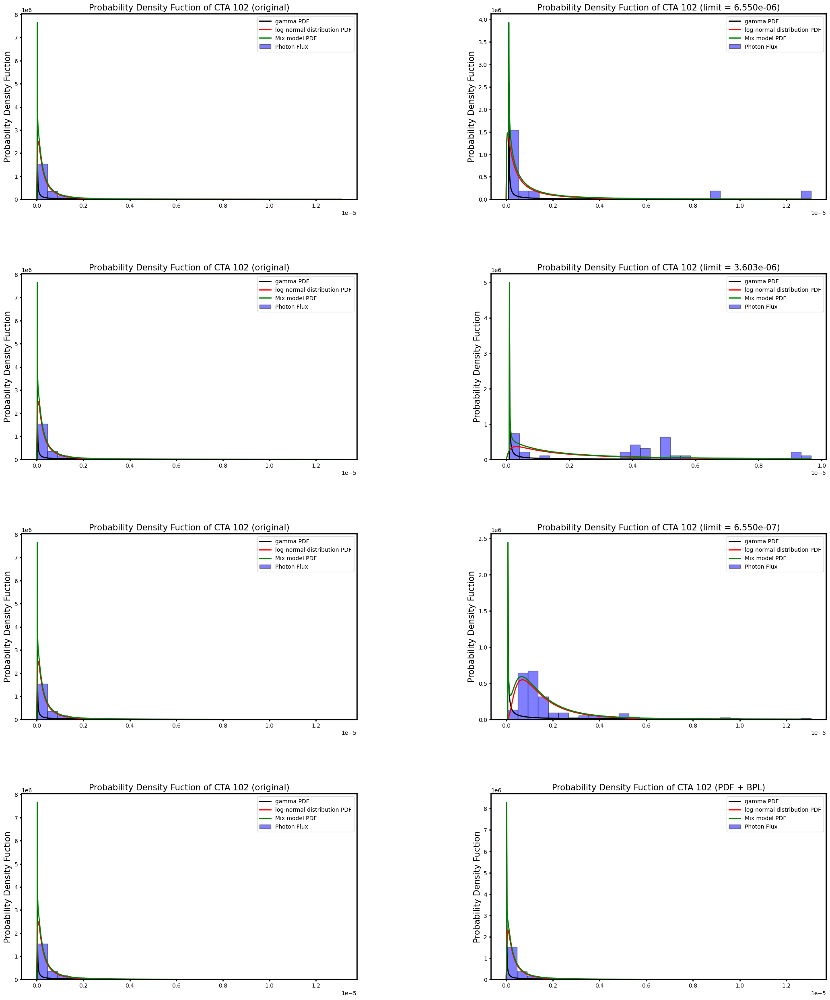

In [17]:
fig2 = plt.figure(figsize=(25, 30))
fig2.set_facecolor('white')
gs = GridSpec(len(limit_v), 2, figure=fig2)
plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

for jl in range(len(limit_v)-1):    
    g = fig2.add_subplot(gs[jl, 0])
    plot_pdf(data_pdf, data_pdf2, pdf_light, pdf_light2, 'Probability Density Fuction of CTA 102 (original)', CTAdata['Photon Flux [0.1-100 GeV](photons cm-2 s-1)'], g)

    g = fig2.add_subplot(gs[jl, 1])
    plot_pdf(vdpfl[jl], vdpfl2[jl], vpdfl1[jl], vpdfl2[jl], 'Probability Density Fuction of CTA 102 (limit = {:.3e})'.format(limit_v[jl]), data_r[jl]['Flux'], g )

g = fig2.add_subplot(gs[jl+1, 0])
plot_pdf(data_pdf, data_pdf2, pdf_light, pdf_light2, 'Probability Density Fuction of CTA 102 (original)', CTAdata['Photon Flux [0.1-100 GeV](photons cm-2 s-1)'], g)

g = fig2.add_subplot(gs[jl+1, 1])
plot_pdf(vdpfl[jl+1], vdpfl2[jl+1], vpdfl1[jl+1], vpdfl2[jl+1], 'Probability Density Fuction of CTA 102 (PDF + BPL)', data_r[jl+1]['Flux'], g )


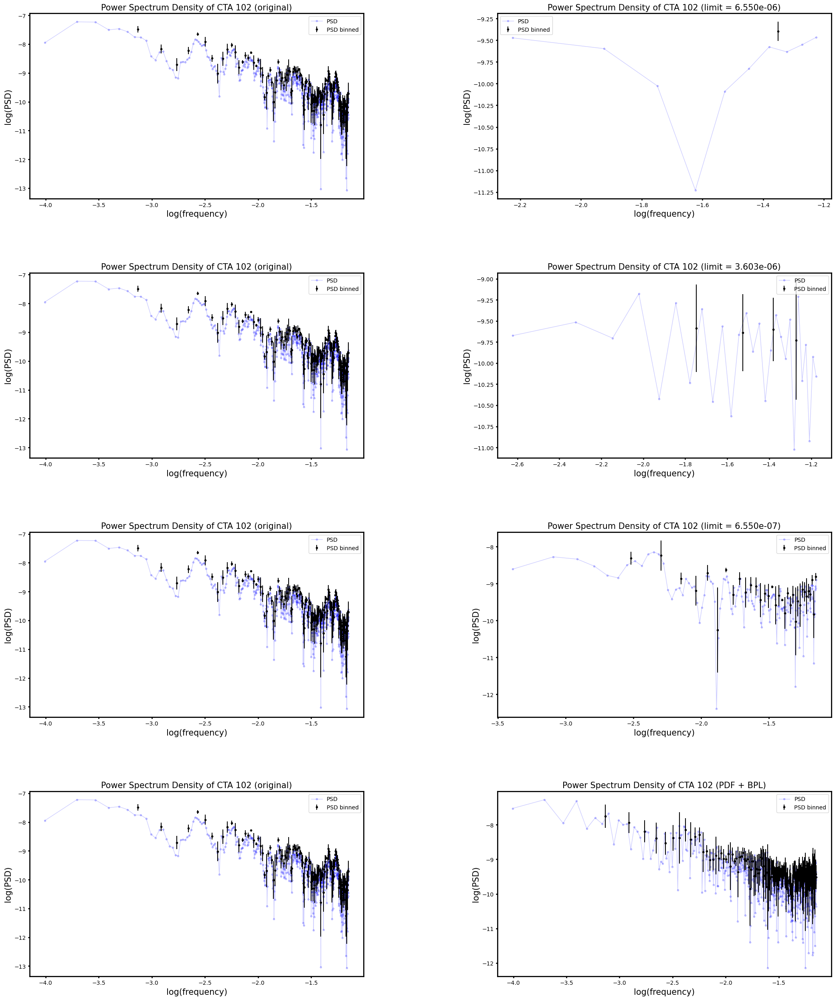

In [18]:
fig2 = plt.figure(figsize=(25, 30))
fig2.set_facecolor('white')
gs = GridSpec(len(limit_v), 2, figure=fig2)
plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

for jl in range(len(limit_v)-1):    
    g = fig2.add_subplot(gs[jl, 0])
    plot_psd(dft, fj, fmean, rpsd, err_psd, 'Power Spectrum Density of CTA 102 (original)', g)
    
    g = fig2.add_subplot(gs[jl, 1])
    plot_psd(dftr_v[jl], fjr_v[jl], fmeanr_v[jl], rpsdr_v[jl], errpsdr_v[jl],'Power Spectrum Density of CTA 102 (limit = {:.3e})'.format(limit_v[jl]), g)
    
g = fig2.add_subplot(gs[jl+1, 0])
plot_psd(dft, fj, fmean, rpsd, err_psd, 'Power Spectrum Density of CTA 102 (original)', g)
    
g = fig2.add_subplot(gs[jl+1, 1])
plot_psd(dftr_v[jl+1], fjr_v[jl+1], fmeanr_v[jl+1], rpsdr_v[jl+1], errpsdr_v[jl+1], 'Power Spectrum Density of CTA 102 (PDF + BPL)', g)    


/home/loramaya/funs_CTA102masterCodev4.py:40: RuntimeWarning: divide by zero encountered in log10
  freq = np.array(np.log10(frqj))
/home/loramaya/funs_CTA102masterCodev4.py:383: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_psd0 = data_psd0.append({'Number Points':n,'LC/LC section': LCp, 'PSD': PSD, 'Freq': Freq, 'PSDb':PSDb, 'Freqmean':Freqmean, 'err': errpsd}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:40: RuntimeWarning: divide by zero encountered in log10
  freq = 

Kappa, loc, theta 0.07616773897373386 1.0020032603999998e-07 1
Kappa, loc, theta 0.08588613017070373 8.353474320599998e-08 1
Kappa, loc, theta 0.07404357657723974 9.224699818899998e-08 1
Kappa, loc, theta 0.06963836517390933 2.3807252084999998e-08 1


/home/loramaya/funs_CTA102masterCodev4.py:40: RuntimeWarning: divide by zero encountered in log10
  freq = np.array(np.log10(frqj))
/home/loramaya/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/loramaya/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/loramaya/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/loramaya/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:226: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/home/loramaya/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:261: RuntimeWarning: invalid value encountered in scalar divide


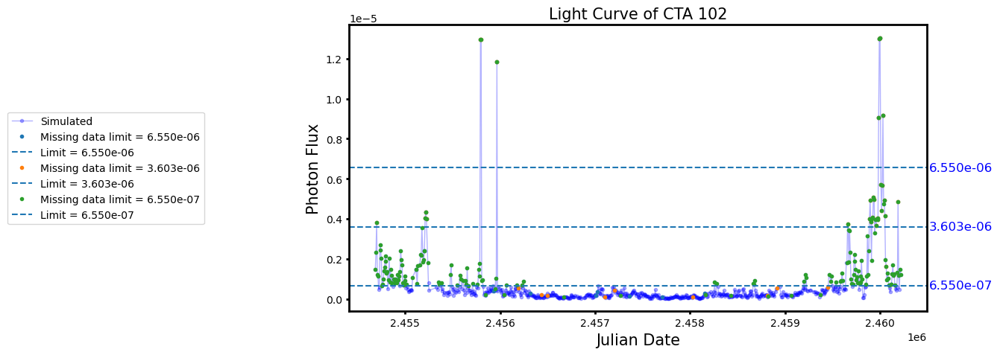

In [19]:
vkr, vtr, vlnr, vlsr,vdpfl, vdpfl2, vpdfl1, vpdfl2, limit_v, data_r, dftr_v, fjr_v, fmeanr_v, rpsdr_v, errpsdr_v = rem_cal(CTA102_sim_curved, CTAdata)
data_SCPL = data_r
limit_SCPL = limit_v


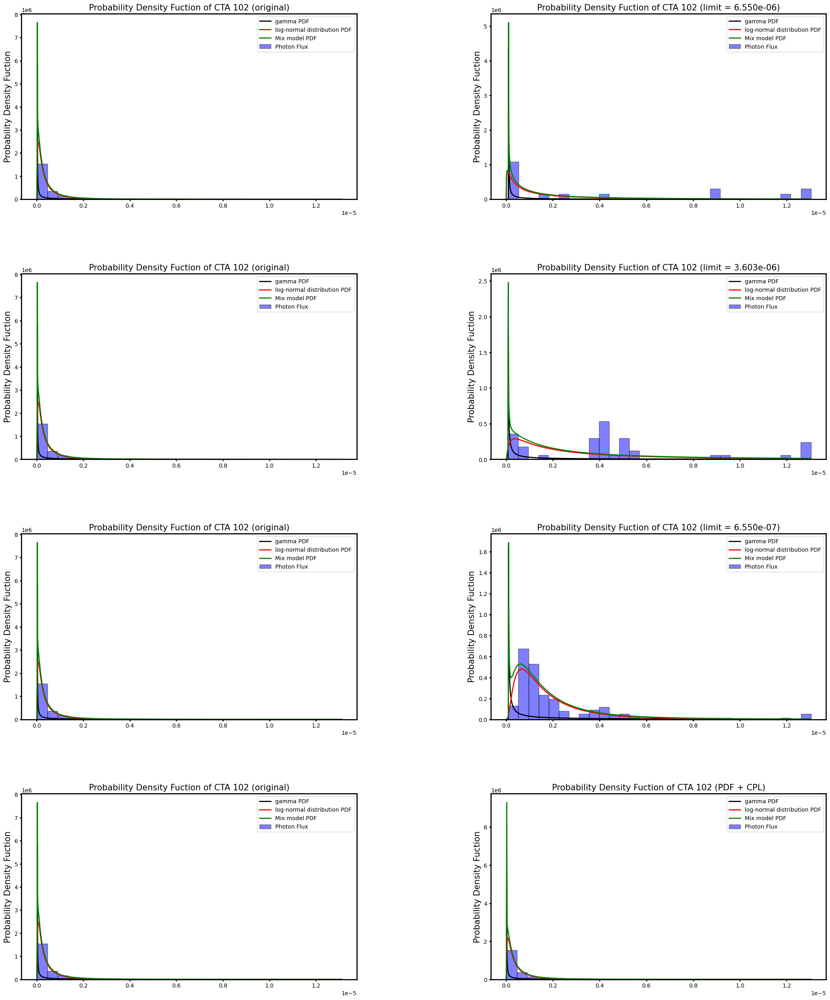

In [20]:
fig2 = plt.figure(figsize=(25, 30))
fig2.set_facecolor('white')
gs = GridSpec(len(limit_v), 2, figure=fig2)
plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

for jl in range(len(limit_v)-1):    
    g = fig2.add_subplot(gs[jl, 0])
    plot_pdf(data_pdf, data_pdf2, pdf_light, pdf_light2, 'Probability Density Fuction of CTA 102 (original)', CTAdata['Photon Flux [0.1-100 GeV](photons cm-2 s-1)'], g)

    g = fig2.add_subplot(gs[jl, 1])
    plot_pdf(vdpfl[jl], vdpfl2[jl], vpdfl1[jl], vpdfl2[jl], 'Probability Density Fuction of CTA 102 (limit = {:.3e})'.format(limit_v[jl]), data_r[jl]['Flux'], g )

g = fig2.add_subplot(gs[jl+1, 0])
plot_pdf(data_pdf, data_pdf2, pdf_light, pdf_light2, 'Probability Density Fuction of CTA 102 (original)', CTAdata['Photon Flux [0.1-100 GeV](photons cm-2 s-1)'], g)

g = fig2.add_subplot(gs[jl+1, 1])
plot_pdf(vdpfl[jl+1], vdpfl2[jl+1], vpdfl1[jl+1], vpdfl2[jl+1], 'Probability Density Fuction of CTA 102 (PDF + CPL)', data_r[jl+1]['Flux'], g )


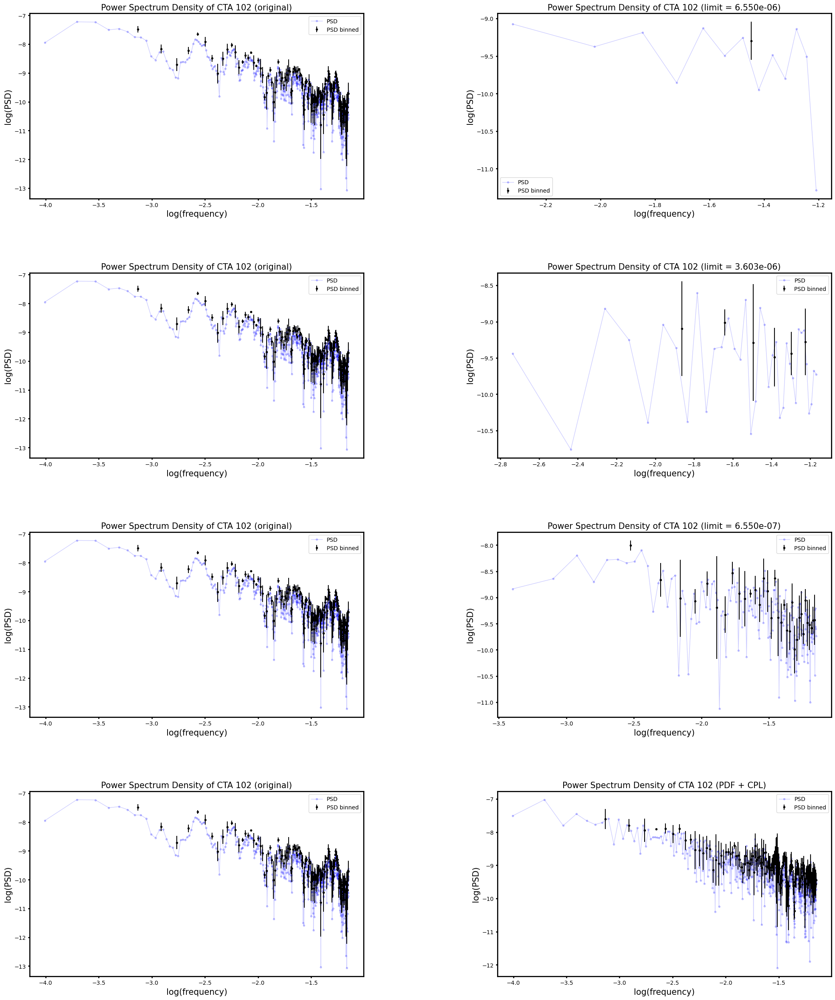

In [21]:
fig2 = plt.figure(figsize=(25, 30))
fig2.set_facecolor('white')
gs = GridSpec(len(limit_v), 2, figure=fig2)
plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

for jl in range(len(limit_v)-1):    
    g = fig2.add_subplot(gs[jl, 0])
    plot_psd(dft, fj, fmean, rpsd, err_psd,'Power Spectrum Density of CTA 102 (original)', g)
    
    g = fig2.add_subplot(gs[jl, 1])
    plot_psd(dftr_v[jl], fjr_v[jl], fmeanr_v[jl], rpsdr_v[jl], errpsdr_v[jl],'Power Spectrum Density of CTA 102 (limit = {:.3e})'.format(limit_v[jl]), g)
    
g = fig2.add_subplot(gs[jl+1, 0])
plot_psd(dft, fj, fmean, rpsd, err_psd,'Power Spectrum Density of CTA 102 (original)', g)
    
g = fig2.add_subplot(gs[jl+1, 1])
plot_psd(dftr_v[jl+1], fjr_v[jl+1], fmeanr_v[jl+1], rpsdr_v[jl+1], errpsdr_v[jl+1], 'Power Spectrum Density of CTA 102 (PDF + CPL)', g)    


# Interpolate. Then, calculate PSD and PDF again.

## Original:

/home/loramaya/funs_CTA102masterCodev4.py:322: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  gp.fit(timex[:, np.newaxis], fluxy)
/home/loramaya/anaconda3/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/home/loramaya/anaconda3/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/home/loramaya/funs_CTA102masterCodev4.py:40: RuntimeWarning: divide by zero encountered in log10
  fre

Kappa, loc, theta 0.06680458471801992 2.2999999999999998e-08 1
Kappa, loc, theta 0.06791382934770414 3.8268801928061453e-10 1
Kappa, loc, theta 0.06772575269109221 7.02904401350679e-11 1


/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)


,Number Points,LC/LC section,Kappa,Theta,lnmu,lnsig,dPDF,dPDFlog,PDF,PDFlog
0,727,Original,0.067762,1,-0.715743,1.196448,"[0.0, 1.3113113113113113e-08, 2.62262262262262...","[0.0, 1.3113113113113113e-08, 2.62262262262262...","[0.0, 0.0, 5784969.197796982, 1274978.07720552...","[0.0, 1013483.697252679, 1864857.459270747, 22..."
1,13,Sim:6.550e-06,0.067803,1,-2.098735,2.048773,"[0.0, 1.309450220920921e-08, 2.618900441841842...","[0.0, 1.309450220920921e-08, 2.618900441841842...","[0.0, 0.0, 0.0, 0.0, 1585900.4643053603, 82613...","[0.0, 2860116.7680849005, 2496283.3787541795, ..."
2,25,Sim:3.603e-06,0.128861,1,-1.598361,1.787938,"[0.0, 1.309450220920921e-08, 2.618900441841842...","[0.0, 1.309450220920921e-08, 2.618900441841842...","[0.0, 0.0, 0.0, 1311723.9837786984, 622853.089...","[0.0, 549988.8381023242, 704511.086480697, 759..."
3,175,Sim:6.550e-07,0.075367,1,-0.286224,0.756604,"[0.0, 1.309450220920921e-08, 2.618900441841842...","[0.0, 1.309450220920921e-08, 2.618900441841842...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.5016490226320057, 41.45969876635182, 3..."
4,727,Sim without lim,0.104588,1,-0.671322,1.158725,"[0.0, 1.309450220920921e-08, 2.618900441841842...","[0.0, 1.309450220920921e-08, 2.618900441841842...","[0.0, 0.0, 5061915.2498057885, 1061158.4630669...","[0.0, 769984.4721310026, 1577993.8428482015, 2..."
5,11,Sim:6.550e-06,0.054064,1,-1.242118,1.576146,"[0.0, 9.747058447047047e-09, 1.949411689409409...","[0.0, 9.747058447047047e-09, 1.949411689409409...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 22749...","[0.0, 1328519.1109940168, 1762166.7234933646, ..."
6,27,Sim:3.603e-06,0.073964,1,-1.072636,1.464675,"[0.0, 5.7191452083083085e-09, 1.14382904166166...","[0.0, 5.7191452083083085e-09, 1.14382904166166...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 25563.55524893591, 71704.93374443676, 11..."
7,174,Sim:6.550e-07,0.075615,1,-0.332606,0.815606,"[0.0, 9.747058447047047e-09, 1.949411689409409...","[0.0, 9.747058447047047e-09, 1.949411689409409...","[0.0, 0.0, 0.0, 0.0, 4766710.263942591, 147416...","[0.0, 1.1676842517802035, 62.77086936775276, 4..."
8,727,Sim without lim,0.068150,1,-0.677229,1.163812,"[0.0, 9.747058447047047e-09, 1.949411689409409...","[0.0, 9.747058447047047e-09, 1.949411689409409...","[0.0, 0.0, 0.0, 3181609.6291639954, 1309131.85...","[0.0, 489253.8661162117, 1168981.5540234342, 1..."
9,12,Sim:6.550e-06,0.065781,1,-1.081603,1.470784,"[0.0, 1.3061533403403403e-08, 2.61230668068068...","[0.0, 1.3061533403403403e-08, 2.61230668068068...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 841134.5696557926, 1241385.9671789452, 1..."


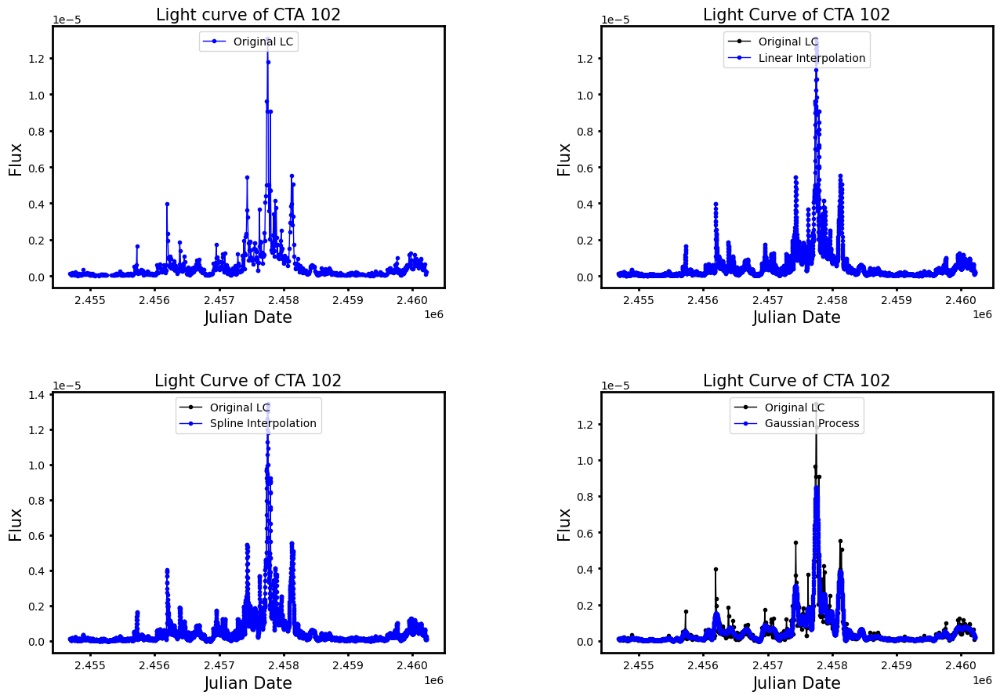

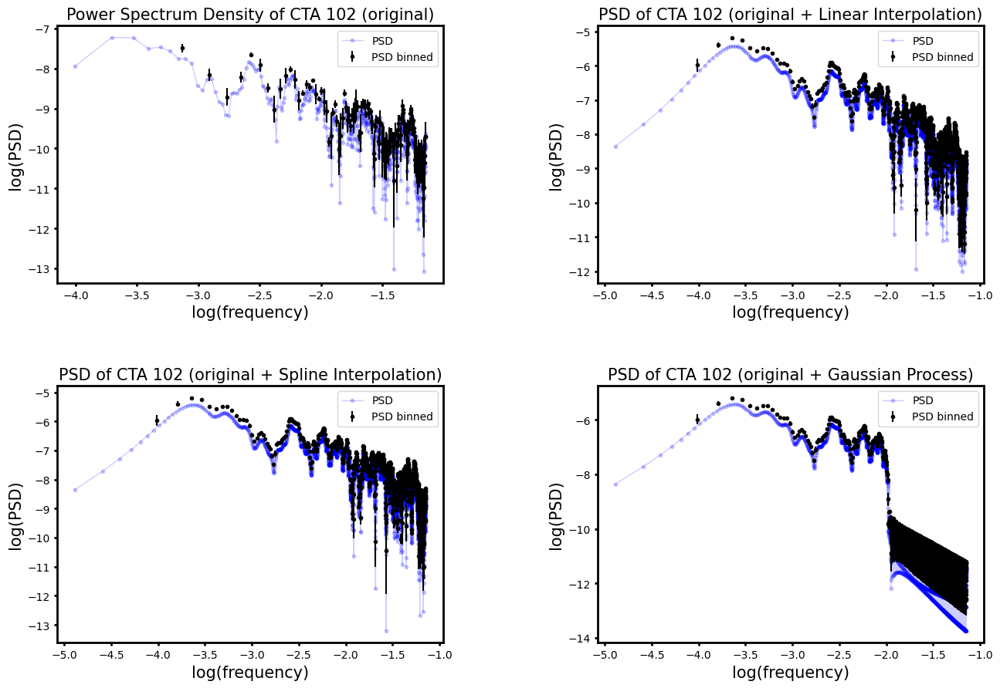

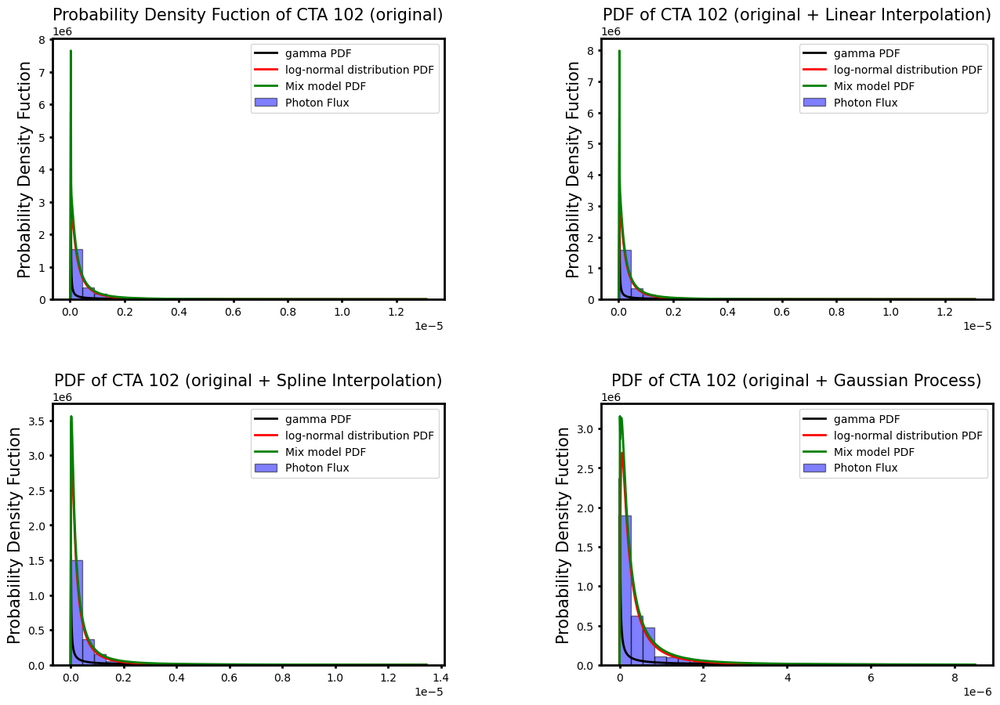

In [22]:
timex = CTAdata['Julian Date']
fluxy = CTAdata['Photon Flux [0.1-100 GeV](photons cm-2 s-1)']
time_interp, flux_interp, flux_interp2, flux_mean, flux_std = inter(timex, fluxy)

fig = plt.figure(figsize=(15, 10))
fig.set_facecolor('white')
gs = GridSpec(2, 2, figure=fig)
plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

g2 = fig.add_subplot(gs[0, 0])
g2.plot(timex, fluxy,'b-o',linewidth=1, markersize = 3, label = 'Original LC')

g = fig.add_subplot(gs[0, 1])
plotthing(timex, fluxy, time_interp, flux_interp, 'Linear Interpolation', 'Original LC','Light Curve of CTA 102', g)

g = fig.add_subplot(gs[1, 0])
plotthing(timex, fluxy, time_interp, flux_interp2, 'Spline Interpolation','Original LC','Light Curve of CTA 102', g )

g = fig.add_subplot(gs[1, 1])
plotthing(timex, fluxy, time_interp, flux_mean, 'Gaussian Process', 'Original LC','Light Curve of CTA 102', g)

g2.set_ylabel('Flux',fontsize=15)
g2.set_xlabel('Julian Date',fontsize=15)
g2.set_title('Light curve of CTA 102',fontsize=15)
g2.legend(fontsize = 10, loc = 'upper center')
for spine in ['top', 'right','bottom','left']:
    g2.spines[spine].set_linewidth(2)
g2.tick_params(labelsize=10,length=3,width=2)



fig4 = plt.figure(figsize=(15, 10))
fig4.set_facecolor('white')
gs = GridSpec(2, 2, figure=fig4)
plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

g = fig4.add_subplot(gs[0, 0])
plot_psd(dft, fj, fmean, rpsd, err_psd,'Power Spectrum Density of CTA 102 (original)', g)

g = fig4.add_subplot(gs[0, 1])
dft0, fj0, fmean0, rpsd0, err_psd0 = psd_cal(time_interp, flux_interp, CTAdata['Photon Flux Error(photons cm-2 s-1)'])
plot_psd(dft0, fj0, fmean0, rpsd0, err_psd0,'PSD of CTA 102 (original + Linear Interpolation)', g)
add_datapsd(len(time_interp), 'Original LI', dft0, fj0, rpsd0, fmean0, err_psd0)

g = fig4.add_subplot(gs[1, 0])
dft0, fj0, fmean0, rpsd0, err_psd0 = psd_cal(time_interp, flux_interp2, CTAdata['Photon Flux Error(photons cm-2 s-1)'])
plot_psd(dft0, fj0, fmean0, rpsd0, err_psd0,'PSD of CTA 102 (original + Spline Interpolation)', g)
add_datapsd(len(time_interp), 'Original SI', dft0, fj0, rpsd0, fmean0, err_psd0)

g = fig4.add_subplot(gs[1, 1])
dft0, fj0, fmean0, rpsd0, err_psd0 = psd_cal(time_interp, flux_mean, CTAdata['Photon Flux Error(photons cm-2 s-1)'])
plot_psd(dft0, fj0, fmean0, rpsd0, err_psd0, 'PSD of CTA 102 (original + Gaussian Process)', g)
add_datapsd(len(time_interp), 'Original GP', dft0, fj0, rpsd0, fmean0, err_psd0)


fig3 = plt.figure(figsize=(15, 10))
fig3.set_facecolor('white')
gs = GridSpec(2, 2, figure=fig3)
plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)



g = fig3.add_subplot(gs[0, 0])
plot_pdf(data_pdf, data_pdf2, pdf_light, pdf_light2, 'Probability Density Fuction of CTA 102 (original)', CTAdata['Photon Flux [0.1-100 GeV](photons cm-2 s-1)'], g )

g = fig3.add_subplot(gs[0, 1])
kappa, theta, lnmu, lnsig, data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o = pdf_cal(flux_interp)
add_datapdfs(len(flux_interp), 'Original LI', kappa, theta, lnmu, lnsig, data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o)
plot_pdf(data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o, 'PDF of CTA 102 (original + Linear Interpolation)', flux_interp, g )

g = fig3.add_subplot(gs[1, 0])
kappa, theta, lnmu, lnsig, data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o = pdf_cal(abs(flux_interp2))
plot_pdf(data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o, 'PDF of CTA 102 (original + Spline Interpolation)', flux_interp2, g)
add_datapdfs(len(flux_interp2), 'Original SI', kappa, theta, lnmu, lnsig, data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o)

g = fig3.add_subplot(gs[1, 1])
kappa, theta, lnmu, lnsig, data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o = pdf_cal(abs(flux_mean))
plot_pdf(data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o, 'PDF of CTA 102 (original + Gaussian Process)', flux_mean, g )
add_datapdfs(len(flux_mean), 'Original GP', kappa, theta, lnmu, lnsig, data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o)


## Simulated


/home/loramaya/funs_CTA102masterCodev4.py:322: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  gp.fit(timex[:, np.newaxis], fluxy)
/home/loramaya/anaconda3/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/home/loramaya/anaconda3/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/home/loramaya/funs_CTA102masterCodev4.py:40: RuntimeWarning: divide by zero encountered in log10
  fre

Kappa, loc, theta 0.07421801438076028 3.9450458819999996e-08 1
Kappa, loc, theta 0.08581580682395967 7.299411573083433e-11 1
Kappa, loc, theta 0.07095224470309644 5.837250284917558e-12 1


/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat inste

Kappa, loc, theta 0.07883615502587762 2.9593028001999998e-08 1
Kappa, loc, theta 0.08370750418117756 1.3325436208568191e-09 1
Kappa, loc, theta 0.05603116506571042 6.409165614803444e-19 1


/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat inste

Kappa, loc, theta 0.07351029828674396 1.2030045777999998e-07 1
Kappa, loc, theta 0.07991244348152754 6.527736539453776e-10 1


/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)


Kappa, loc, theta 0.0846312161166611 3.438693774171497e-11 1


/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:322: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  gp.fit(timex[:, np.newaxis], fluxy)
/home/loramaya/anaconda3/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/home

Kappa, loc, theta 0.06561180528357688 2.3417798269999997e-08 1
Kappa, loc, theta 0.06940130967077841 1.1287388233470725e-09 1
Kappa, loc, theta 0.06943574976356429 6.92383927969331e-11 1


/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat inste

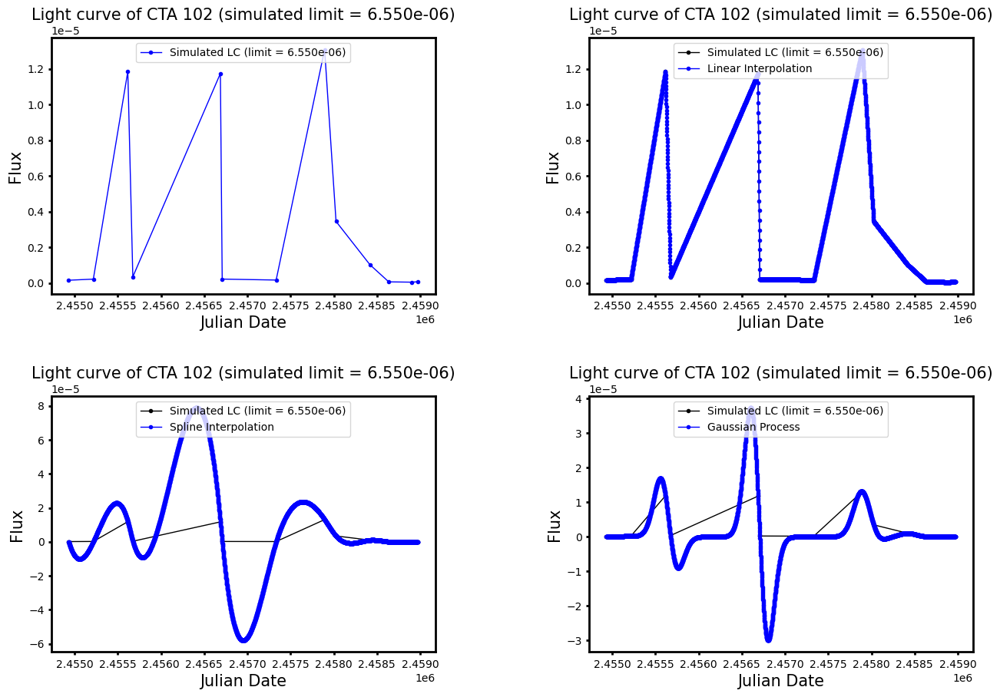

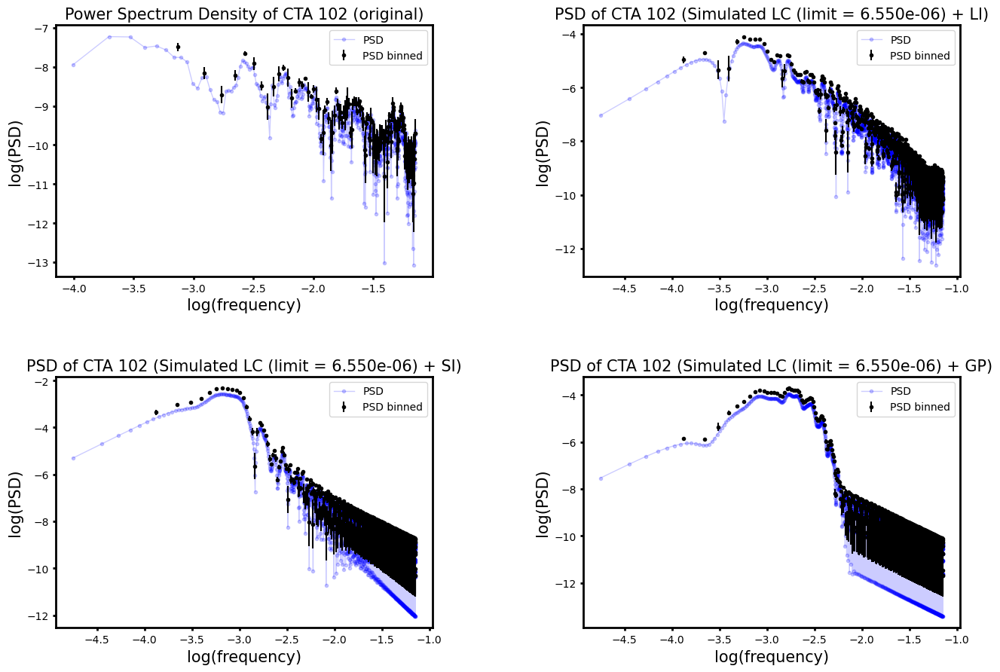

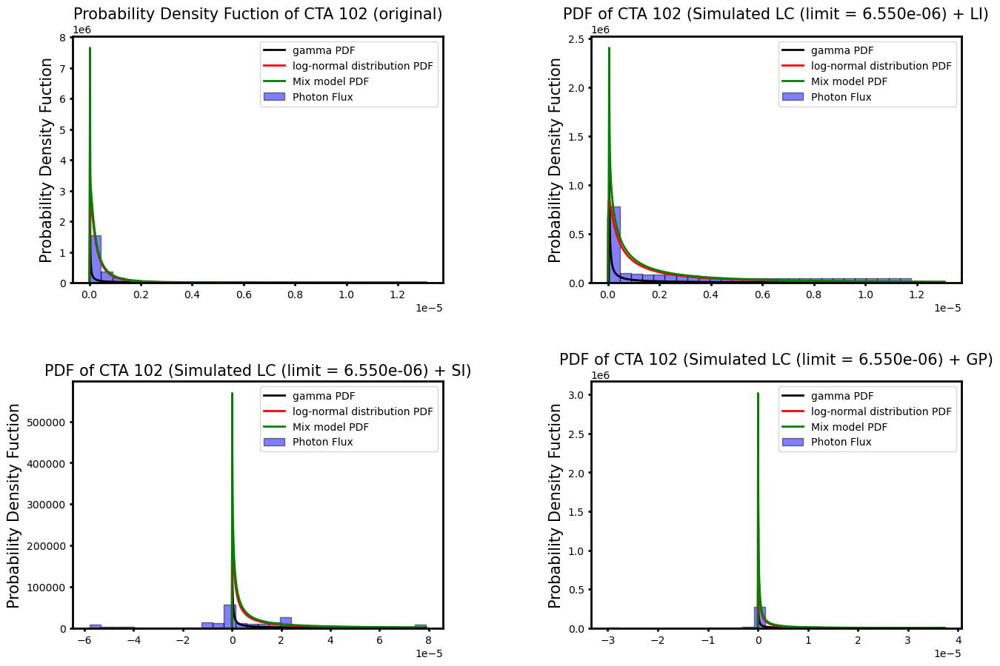

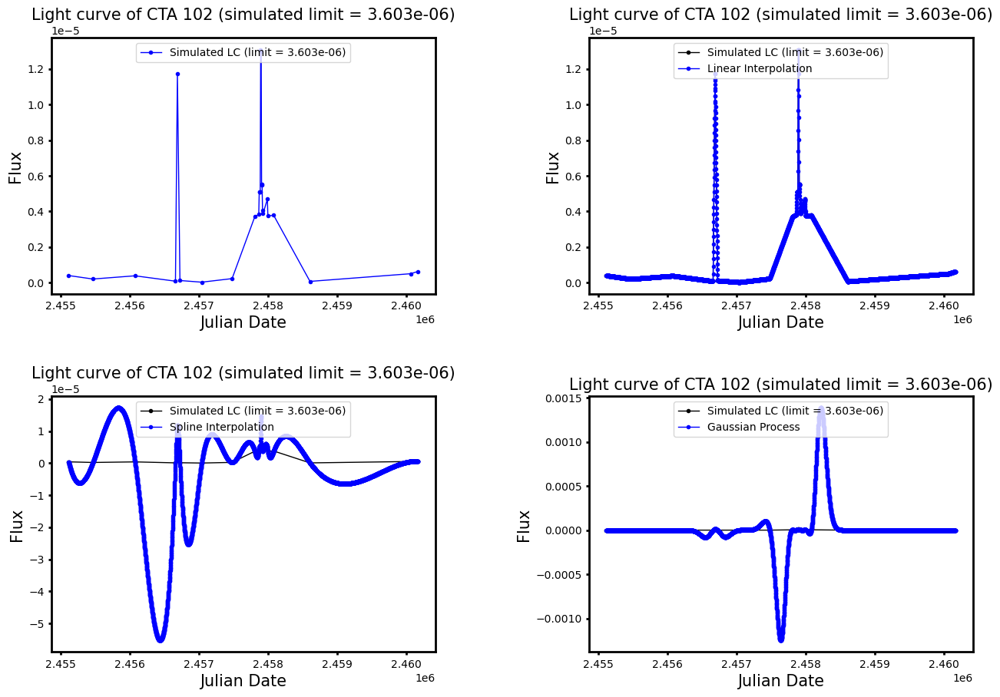

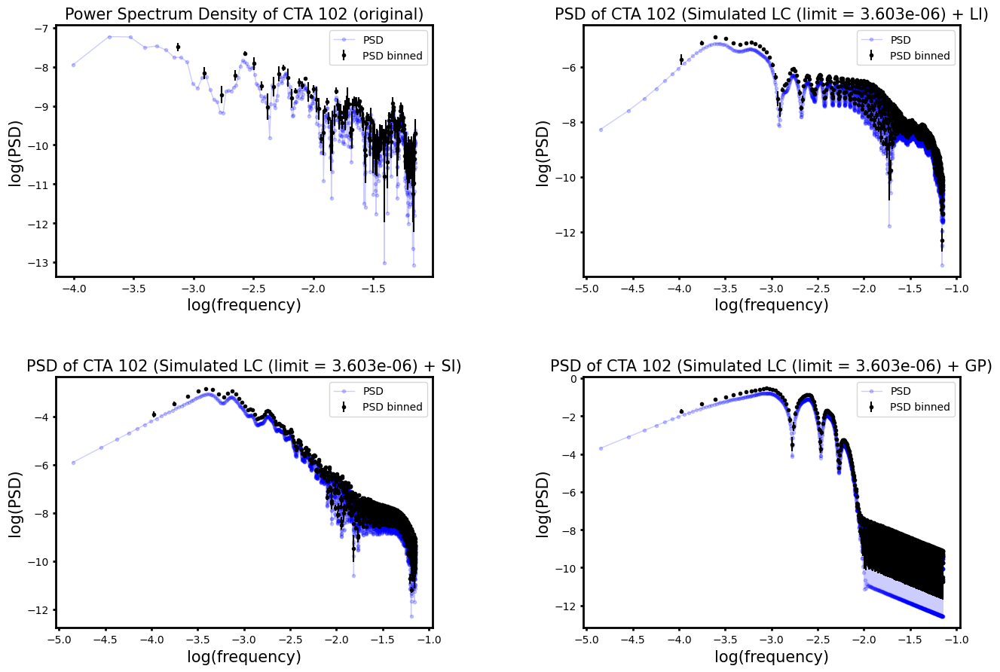

...

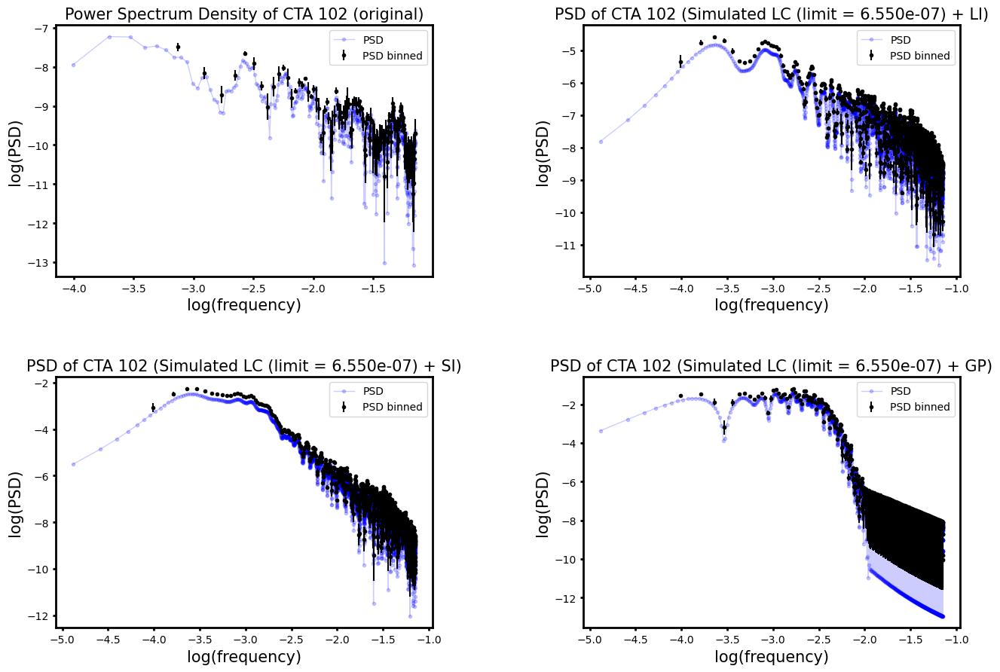

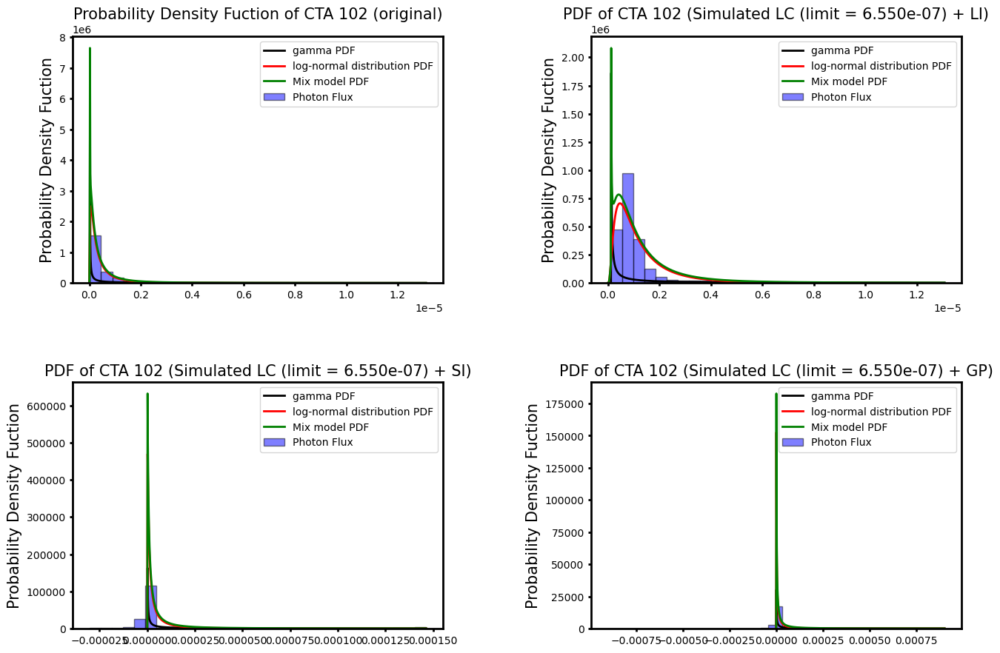

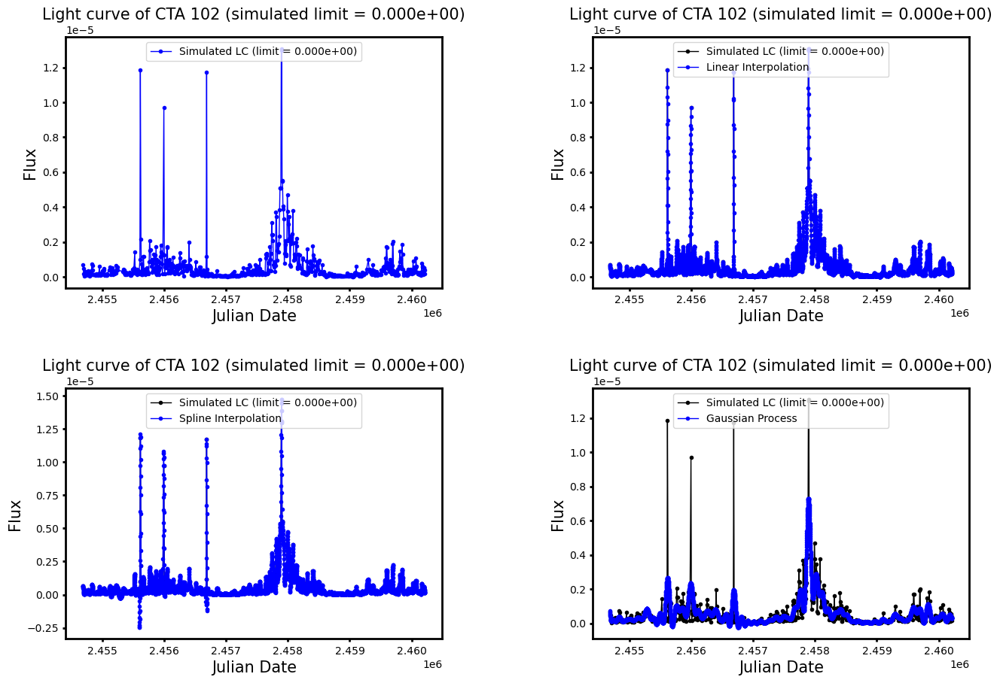

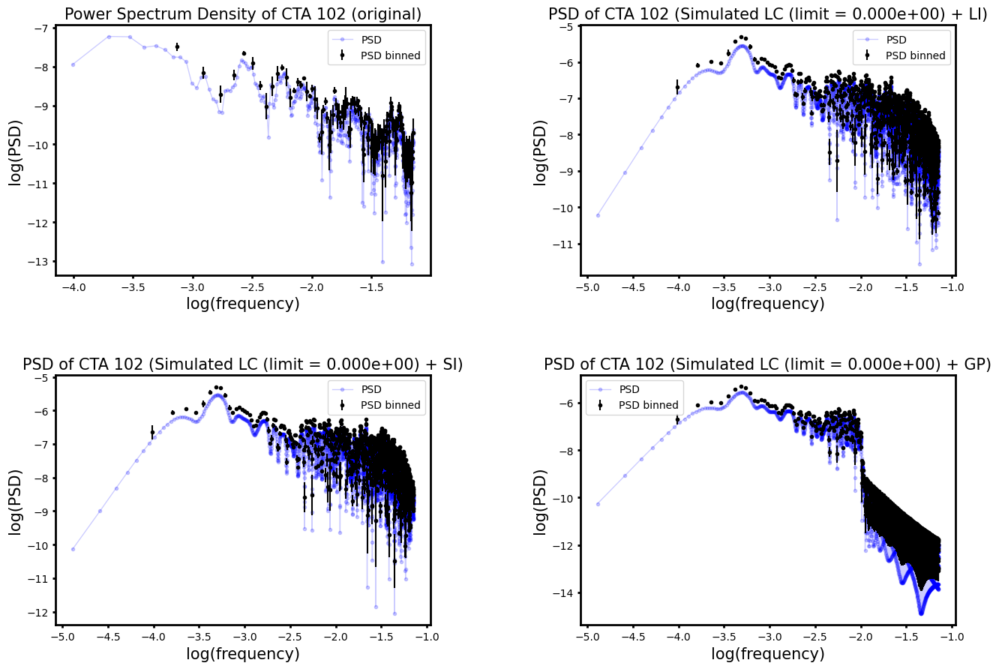

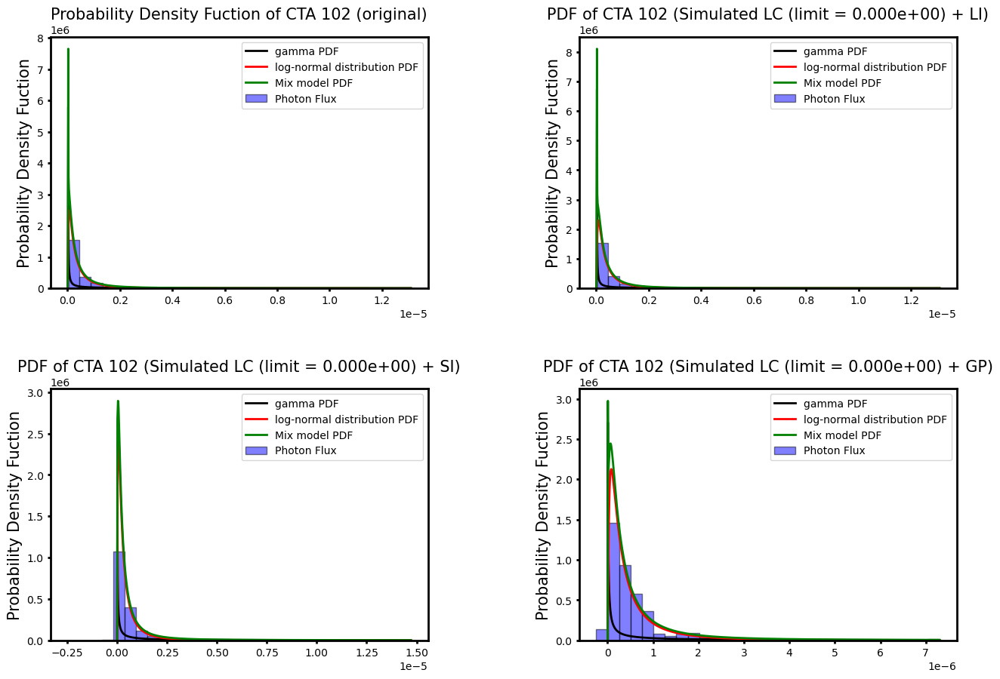

In [23]:
limit_S[-1] = 0
for ss in range(len(data_S)):
    timex = data_S[ss]['Time']
    fluxy = data_S[ss]['Flux']
    time_interp, flux_interp, flux_interp2, flux_mean, flux_std = inter(timex, fluxy)

    fig = plt.figure(figsize=(15, 10))
    fig.set_facecolor('white')
    gs = GridSpec(2, 2, figure=fig)
    plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

    g2 = fig.add_subplot(gs[0, 0])
    g2.plot(timex, fluxy,'b-o',linewidth=1, markersize = 3, label = 'Simulated LC (limit = {:.3e})'.format(limit_S[ss]))

    g = fig.add_subplot(gs[0, 1])
    plotthing(timex, fluxy, time_interp, flux_interp, 'Linear Interpolation', 'Simulated LC (limit = {:.3e})'.format(limit_S[ss]),'Light curve of CTA 102 (simulated limit = {:.3e})'.format(limit_S[ss]), g)

    g = fig.add_subplot(gs[1, 0])
    plotthing(timex, fluxy, time_interp, flux_interp2, 'Spline Interpolation', 'Simulated LC (limit = {:.3e})'.format(limit_S[ss]),'Light curve of CTA 102 (simulated limit = {:.3e})'.format(limit_S[ss]), g)

    g = fig.add_subplot(gs[1, 1])
    plotthing(timex, fluxy, time_interp, flux_mean, 'Gaussian Process', 'Simulated LC (limit = {:.3e})'.format(limit_S[ss]),'Light curve of CTA 102 (simulated limit = {:.3e})'.format(limit_S[ss]), g)

    g2.set_ylabel('Flux',fontsize=15)
    g2.set_xlabel('Julian Date',fontsize=15)
    g2.set_title('Light curve of CTA 102 (simulated limit = {:.3e})'.format(limit_S[ss]),fontsize=15)
    g2.legend(fontsize = 10, loc = 'upper center')
    for spine in ['top', 'right','bottom','left']:
        g2.spines[spine].set_linewidth(2)
    g2.tick_params(labelsize=10,length=3,width=2)

    fig4 = plt.figure(figsize=(15, 10))
    fig4.set_facecolor('white')
    gs = GridSpec(2, 2, figure=fig4)
    plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

    g = fig4.add_subplot(gs[0, 0])
    plot_psd(dft, fj, fmean, rpsd, err_psd,'Power Spectrum Density of CTA 102 (original)', g)

    g = fig4.add_subplot(gs[0, 1])
    dft0, fj0, fmean0, rpsd0, err_psd0 = psd_cal(time_interp, flux_interp, CTAdata['Photon Flux Error(photons cm-2 s-1)'])
    plot_psd(dft0, fj0, fmean0, rpsd0, err_psd0,'PSD of CTA 102 (Simulated LC (limit = {:.3e}) + LI)'.format(limit_S[ss]), g)
    add_datapsd(len(time_interp), 'Simulated LC (limit = {:.3e}) LI'.format(limit_S[ss]), dft0, fj0, rpsd0, fmean0, err_psd0)

    g = fig4.add_subplot(gs[1, 0])
    dft0, fj0, fmean0, rpsd0, err_psd0 = psd_cal(time_interp, flux_interp2, CTAdata['Photon Flux Error(photons cm-2 s-1)'])
    plot_psd(dft0, fj0, fmean0, rpsd0, err_psd0,'PSD of CTA 102 (Simulated LC (limit = {:.3e}) + SI)'.format(limit_S[ss]), g)
    add_datapsd(len(time_interp), 'Simulated LC (limit = {:.3e}) SI'.format(limit_S[ss]), dft0, fj0, rpsd0, fmean0, err_psd0)

    g = fig4.add_subplot(gs[1, 1])
    dft0, fj0, fmean0, rpsd0, err_psd0 = psd_cal(time_interp, flux_mean, CTAdata['Photon Flux Error(photons cm-2 s-1)'])
    plot_psd(dft0, fj0, fmean0, rpsd0, err_psd0,'PSD of CTA 102 (Simulated LC (limit = {:.3e}) + GP)'.format(limit_S[ss]), g)
    add_datapsd(len(time_interp), 'Simulated LC (limit = {:.3e}) GP'.format(limit_S[ss]), dft0, fj0, rpsd0, fmean0, err_psd0)


    fig3 = plt.figure(figsize=(15, 10))
    fig3.set_facecolor('white')
    gs = GridSpec(2, 2, figure=fig3)
    plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

    g = fig3.add_subplot(gs[0, 0])
    plot_pdf(data_pdf, data_pdf2, pdf_light, pdf_light2, 'Probability Density Fuction of CTA 102 (original)', CTAdata['Photon Flux [0.1-100 GeV](photons cm-2 s-1)'], g )

    g = fig3.add_subplot(gs[0, 1])
    kappa, theta, lnmu, lnsig, data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o = pdf_cal(flux_interp)
    add_datapdfs(len(flux_interp), 'Simulated LC (limit = {:.3e}) LI'.format(limit_S[ss]), kappa, theta, lnmu, lnsig, data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o)
    plot_pdf(data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o, 'PDF of CTA 102 (Simulated LC (limit = {:.3e}) + LI)'.format(limit_S[ss]), flux_interp, g)

    g = fig3.add_subplot(gs[1, 0])
    kappa, theta, lnmu, lnsig, data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o = pdf_cal(abs(flux_interp2))
    plot_pdf(data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o, 'PDF of CTA 102 (Simulated LC (limit = {:.3e}) + SI)'.format(limit_S[ss]), flux_interp2, g)
    add_datapdfs(len(flux_interp2), 'Simulated LC (limit = {:.3e}) SI'.format(limit_S[ss]), kappa, theta, lnmu, lnsig, data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o)

    g = fig3.add_subplot(gs[1, 1])
    kappa, theta, lnmu, lnsig, data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o = pdf_cal(abs(flux_mean))
    plot_pdf(data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o, 'PDF of CTA 102 (Simulated LC (limit = {:.3e}) + GP)'.format(limit_S[ss]), flux_mean, g )
    add_datapdfs(len(flux_mean), 'Simulated LC (limit = {:.3e}) GP'.format(limit_S[ss]), kappa, theta, lnmu, lnsig, data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o)
    

## PDF + SPL

/home/loramaya/funs_CTA102masterCodev4.py:322: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  gp.fit(timex[:, np.newaxis], fluxy)
/home/loramaya/anaconda3/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/home/loramaya/anaconda3/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/home/loramaya/funs_CTA102masterCodev4.py:40: RuntimeWarning: divide by zero encountered in log10
  fre

Kappa, loc, theta 0.06467105570352398 6.899318893699999e-08 1
Kappa, loc, theta 0.0706071634517128 9.277377707707516e-11 1
Kappa, loc, theta 0.1427324440347784 3.821820946203646e-13 1


/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:322: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  gp.fit(timex[:, np.newaxis], fluxy)
/home/loramaya/anaconda3/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/home

Kappa, loc, theta 0.06778802049821489 6.160483880999999e-08 1
Kappa, loc, theta 0.07226698378635388 3.267750332136264e-10 1
Kappa, loc, theta 0.06528517335707273 7.271224268390397e-14 1


/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:322: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version

Kappa, loc, theta 0.07149103944500856 3.517973992699999e-08 1
Kappa, loc, theta 0.07292608181723684 1.658796196592485e-11 1
Kappa, loc, theta 0.07447821536051527 9.667554097661337e-12 1


/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:322: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version

Kappa, loc, theta 0.06839437868702779 2.3124009443999995e-08 1
Kappa, loc, theta 0.06947333295493752 3.375849705310251e-11 1
Kappa, loc, theta 0.0685613609269328 2.0704113978808887e-09 1


/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)


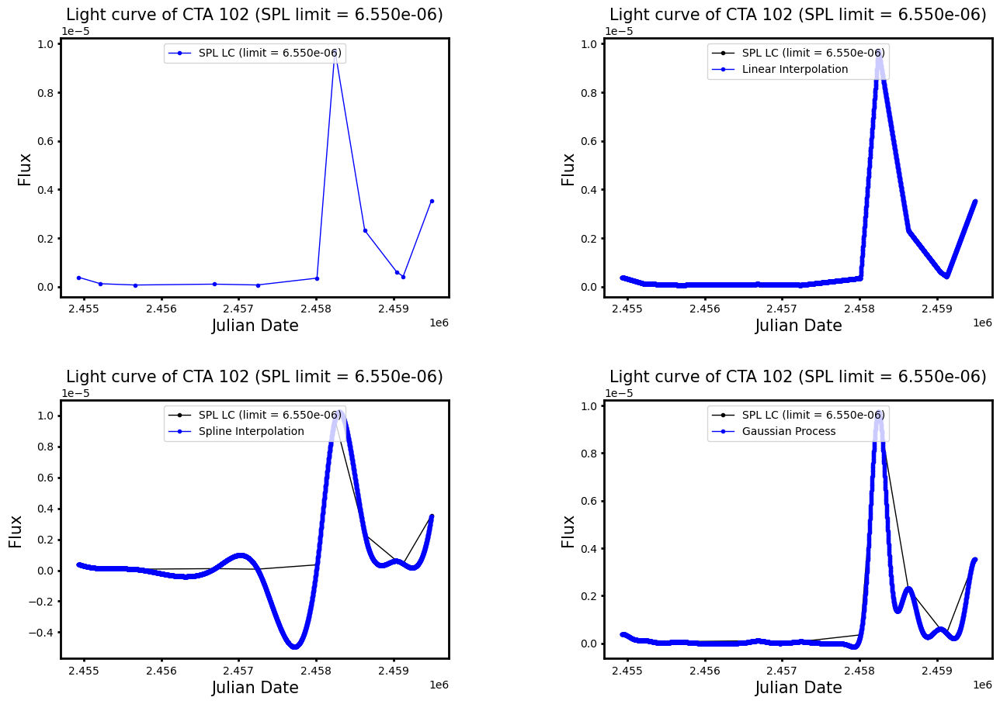

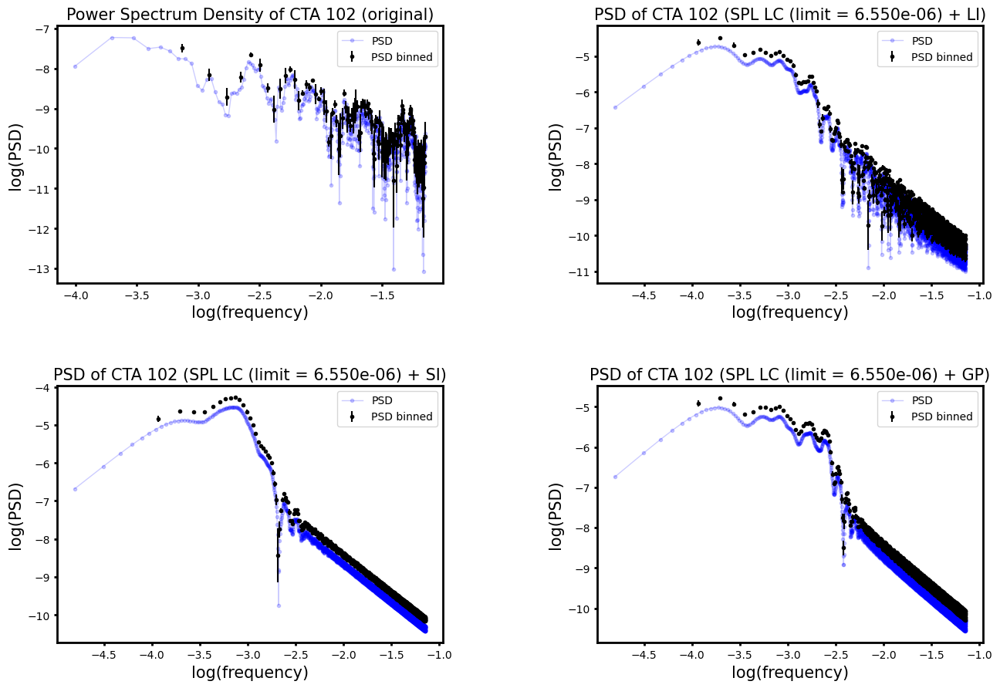

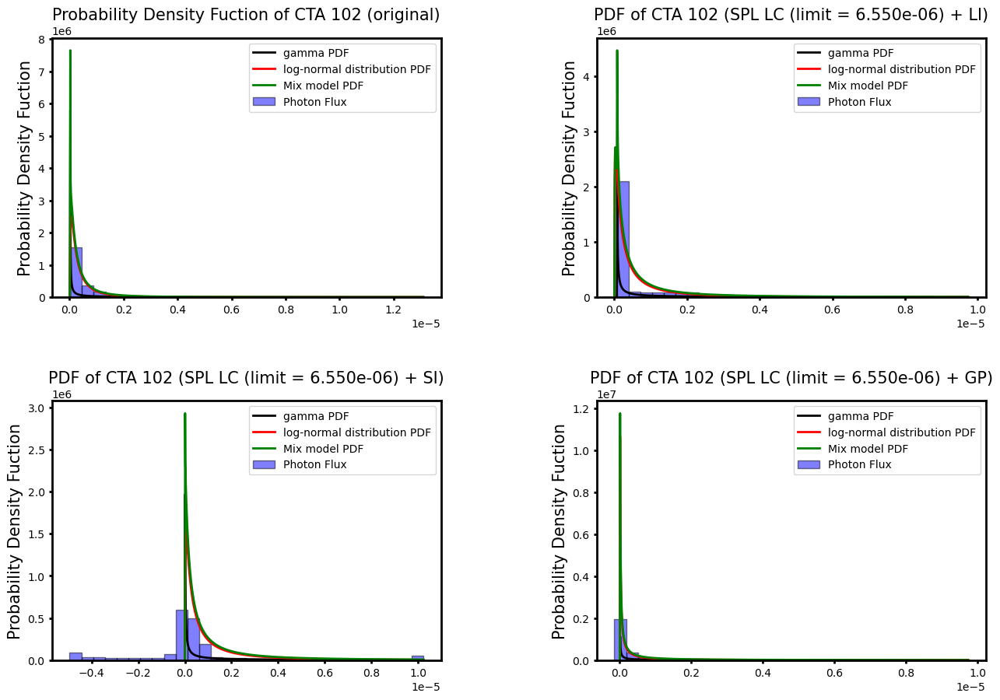

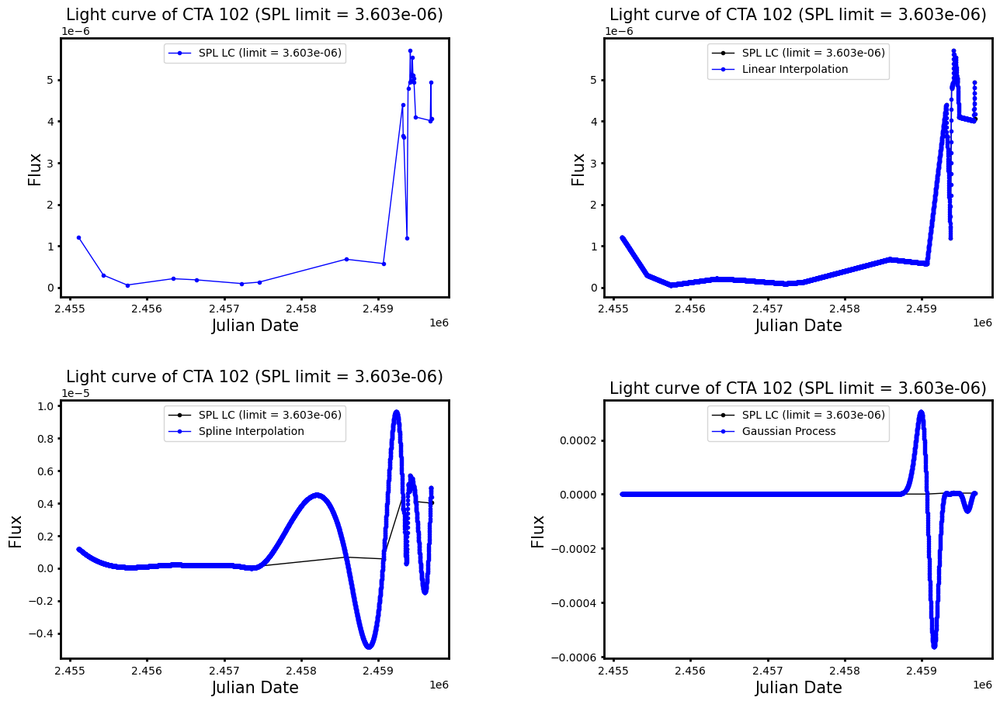

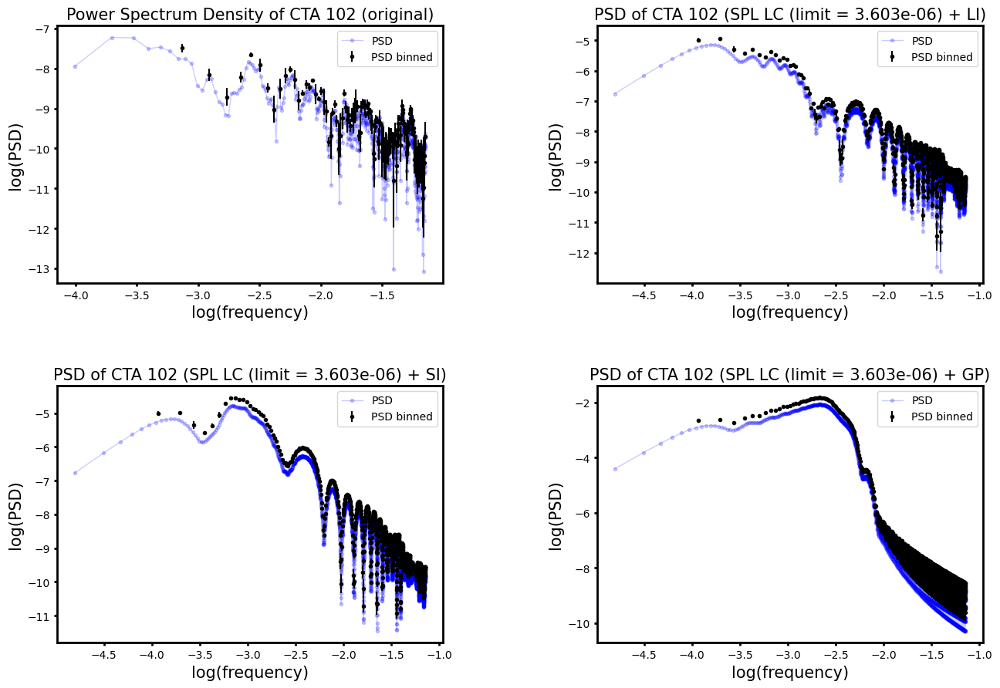

...

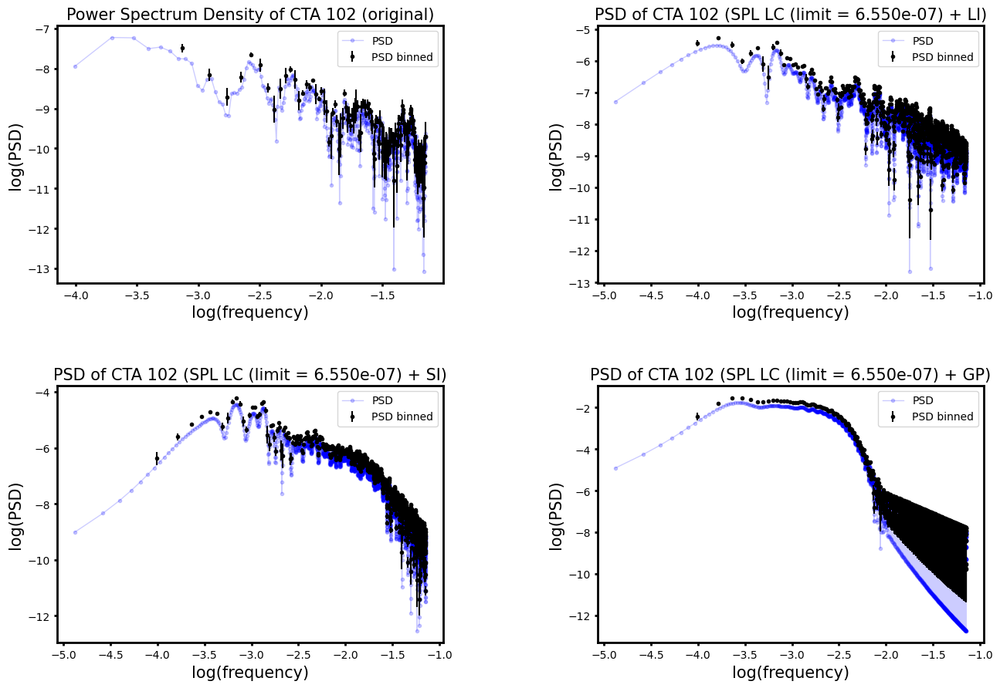

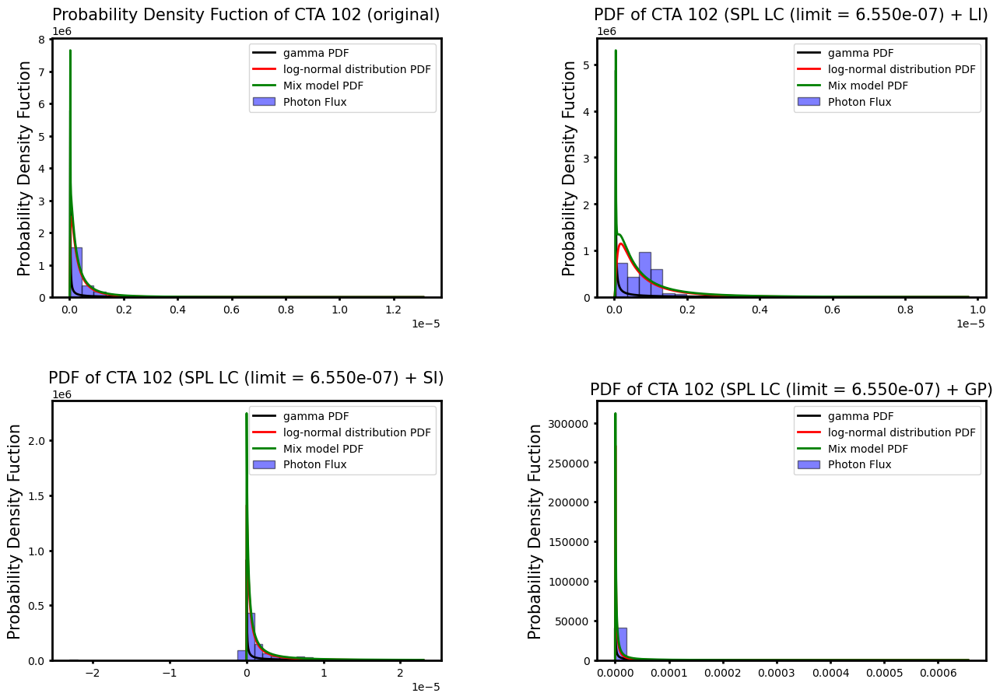

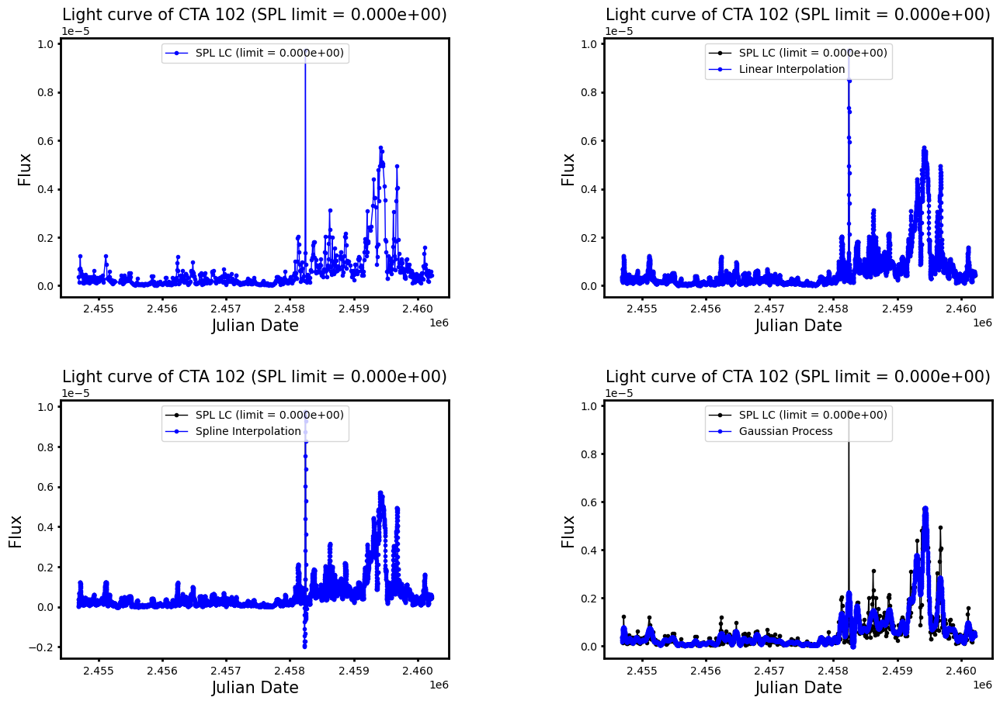

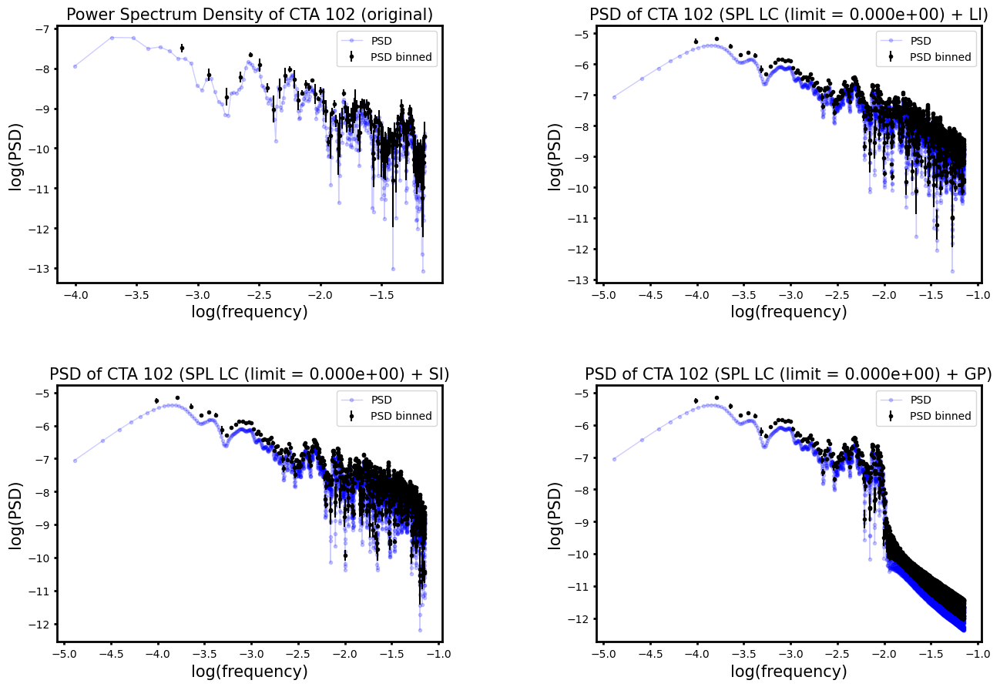

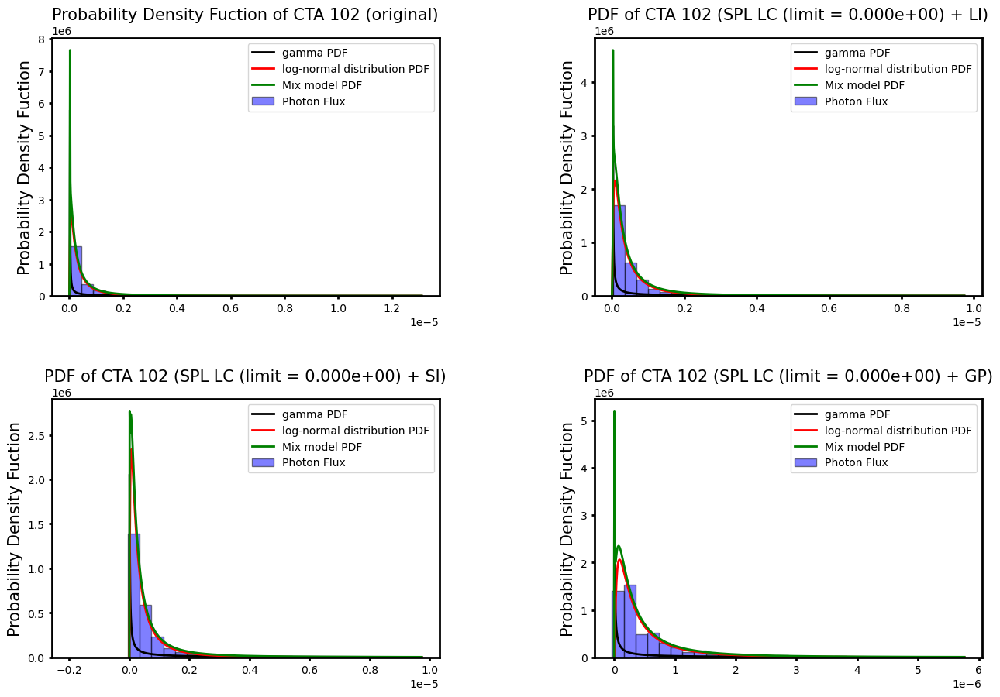

In [24]:
limit_SSPL[-1] = 0
for ss in range(len(data_S)):
    timex = data_SSPL[ss]['Time']
    fluxy = data_SSPL[ss]['Flux']
    if len(timex) > 2:
        time_interp, flux_interp, flux_interp2, flux_mean, flux_std = inter(timex, fluxy)

        fig = plt.figure(figsize=(15, 10))
        fig.set_facecolor('white')
        gs = GridSpec(2, 2, figure=fig)
        plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

        g2 = fig.add_subplot(gs[0, 0])
        g2.plot(timex, fluxy,'b-o',linewidth=1, markersize = 3, label = 'SPL LC (limit = {:.3e})'.format(limit_SSPL[ss]))

        g = fig.add_subplot(gs[0, 1])
        plotthing(timex, fluxy, time_interp, flux_interp, 'Linear Interpolation', 'SPL LC (limit = {:.3e})'.format(limit_SSPL[ss]),'Light curve of CTA 102 (SPL limit = {:.3e})'.format(limit_SSPL[ss]), g)

        g = fig.add_subplot(gs[1, 0])
        plotthing(timex, fluxy, time_interp, flux_interp2, 'Spline Interpolation', 'SPL LC (limit = {:.3e})'.format(limit_SSPL[ss]),'Light curve of CTA 102 (SPL limit = {:.3e})'.format(limit_SSPL[ss]), g)

        g = fig.add_subplot(gs[1, 1])
        plotthing(timex, fluxy, time_interp, flux_mean, 'Gaussian Process', 'SPL LC (limit = {:.3e})'.format(limit_SSPL[ss]),'Light curve of CTA 102 (SPL limit = {:.3e})'.format(limit_SSPL[ss]), g)

        g2.set_ylabel('Flux',fontsize=15)
        g2.set_xlabel('Julian Date',fontsize=15)
        g2.set_title('Light curve of CTA 102 (SPL limit = {:.3e})'.format(limit_SSPL[ss]),fontsize=15)
        g2.legend(fontsize = 10, loc = 'upper center')
        for spine in ['top', 'right','bottom','left']:
            g2.spines[spine].set_linewidth(2)
        g2.tick_params(labelsize=10,length=3,width=2)

        fig4 = plt.figure(figsize=(15, 10))
        fig4.set_facecolor('white')
        gs = GridSpec(2, 2, figure=fig4)
        plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

        g = fig4.add_subplot(gs[0, 0])
        plot_psd(dft, fj, fmean, rpsd, err_psd,'Power Spectrum Density of CTA 102 (original)', g)

        g = fig4.add_subplot(gs[0, 1])
        dft0, fj0, fmean0, rpsd0, err_psd0 = psd_cal(time_interp, flux_interp, CTAdata['Photon Flux Error(photons cm-2 s-1)'])
        plot_psd(dft0, fj0, fmean0, rpsd0, err_psd0,'PSD of CTA 102 (SPL LC (limit = {:.3e}) + LI)'.format(limit_SSPL[ss]), g)
        add_datapsd(len(time_interp), 'SPL LC (limit = {:.3e}) LI'.format(limit_SSPL[ss]), dft0, fj0, rpsd0, fmean0, err_psd0)

        g = fig4.add_subplot(gs[1, 0])
        dft0, fj0, fmean0, rpsd0, err_psd0 = psd_cal(time_interp, flux_interp2, CTAdata['Photon Flux Error(photons cm-2 s-1)'])
        plot_psd(dft0, fj0, fmean0, rpsd0, err_psd0,'PSD of CTA 102 (SPL LC (limit = {:.3e}) + SI)'.format(limit_SSPL[ss]), g)
        add_datapsd(len(time_interp), 'SPL LC (limit = {:.3e}) SI'.format(limit_SSPL[ss]), dft0, fj0, rpsd0, fmean0, err_psd0)

        g = fig4.add_subplot(gs[1, 1])
        dft0, fj0, fmean0, rpsd0, err_psd0 = psd_cal(time_interp, flux_mean, CTAdata['Photon Flux Error(photons cm-2 s-1)'])
        plot_psd(dft0, fj0, fmean0, rpsd0, err_psd0,'PSD of CTA 102 (SPL LC (limit = {:.3e}) + GP)'.format(limit_SSPL[ss]), g)
        add_datapsd(len(time_interp), 'SPL LC (limit = {:.3e}) GP'.format(limit_SSPL[ss]), dft0, fj0, rpsd0, fmean0, err_psd0)


        fig3 = plt.figure(figsize=(15, 10))
        fig3.set_facecolor('white')
        gs = GridSpec(2, 2, figure=fig3)
        plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

        g = fig3.add_subplot(gs[0, 0])
        plot_pdf(data_pdf, data_pdf2, pdf_light, pdf_light2, 'Probability Density Fuction of CTA 102 (original)', CTAdata['Photon Flux [0.1-100 GeV](photons cm-2 s-1)'], g )

        g = fig3.add_subplot(gs[0, 1])
        kappa, theta, lnmu, lnsig, data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o = pdf_cal(flux_interp)
        add_datapdfs(len(flux_interp), 'SPL LC (limit = {:.3e}) LI'.format(limit_SSPL[ss]), kappa, theta, lnmu, lnsig, data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o)
        plot_pdf(data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o, 'PDF of CTA 102 (SPL LC (limit = {:.3e}) + LI)'.format(limit_SSPL[ss]), flux_interp, g )

        g = fig3.add_subplot(gs[1, 0])
        kappa, theta, lnmu, lnsig, data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o = pdf_cal(abs(flux_interp2))
        plot_pdf(data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o, 'PDF of CTA 102 (SPL LC (limit = {:.3e}) + SI)'.format(limit_SSPL[ss]), flux_interp2, g )
        add_datapdfs(len(flux_interp2), 'SPL LC (limit = {:.3e}) SI'.format(limit_SSPL[ss]), kappa, theta, lnmu, lnsig, data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o)

        
        g = fig3.add_subplot(gs[1, 1])
        kappa, theta, lnmu, lnsig, data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o = pdf_cal(abs(flux_mean))
        plot_pdf(data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o, 'PDF of CTA 102 (SPL LC (limit = {:.3e}) + GP)'.format(limit_SSPL[ss]), flux_mean, g )
        add_datapdfs(len(flux_mean), 'SPL LC (limit = {:.3e}) GP'.format(limit_SSPL[ss]), kappa, theta, lnmu, lnsig, data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o)


## PDF + BPL

/home/loramaya/funs_CTA102masterCodev4.py:322: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  gp.fit(timex[:, np.newaxis], fluxy)
/home/loramaya/anaconda3/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/home/loramaya/anaconda3/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/home/loramaya/funs_CTA102masterCodev4.py:40: RuntimeWarning: divide by zero encountered in log10
  fre

Kappa, loc, theta 0.06781569965360276 1.0985108612999999e-07 1
Kappa, loc, theta 0.07447358020128128 2.3490190557854805e-10 1
Kappa, loc, theta 0.06223102907326292 7.515569837377331e-13 1


/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:322: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  gp.fit(timex[:, np.newaxis], fluxy)
/home/loramaya/anaconda3/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/home

Kappa, loc, theta 0.06946542064225507 1.0234397665999998e-07 1
Kappa, loc, theta 0.09005605396749838 2.376078610337841e-09 1
Kappa, loc, theta 0.10885221502083536 5.528286688777377e-14 1


/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat inste

Kappa, loc, theta 0.0704737991080358 7.032700860799999e-08 1
Kappa, loc, theta 0.08022529220394164 2.128879356131604e-09 1
Kappa, loc, theta 0.09069593336365755 3.4403993976331434e-10 1


/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:322: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  gp.fit(timex[:, np.newaxis], fluxy)
/home/loramaya/anaconda3/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/home

Kappa, loc, theta 0.06740592613808152 2.3403194738999996e-08 1
Kappa, loc, theta 0.06750761562343446 1.2861067831745784e-08 1
Kappa, loc, theta 0.06921111997087578 9.519123822521178e-10 1


/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat inste

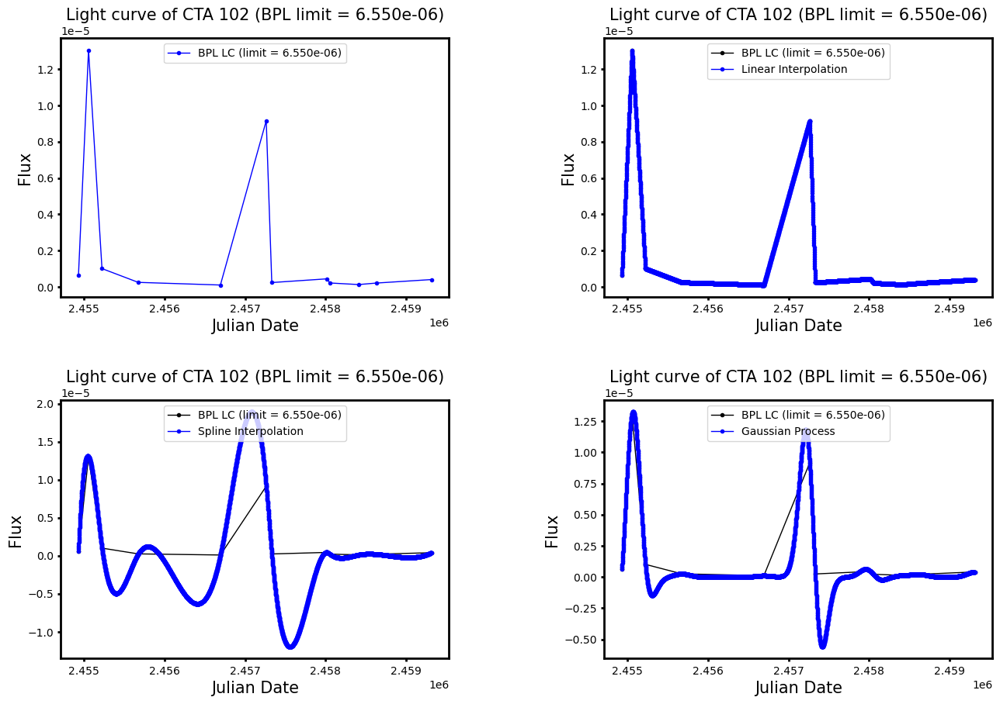

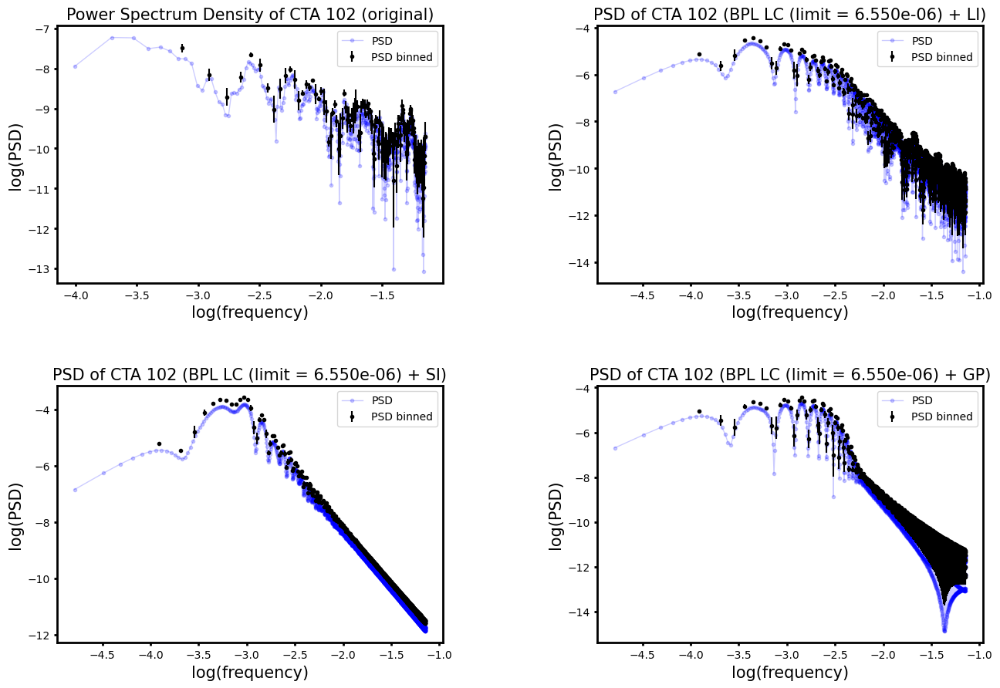

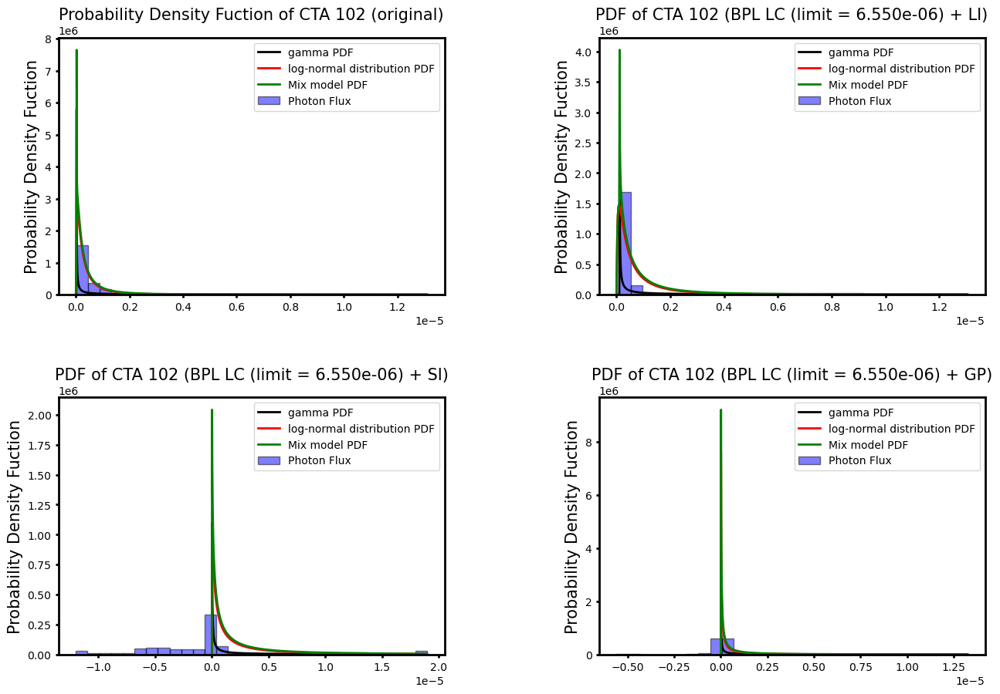

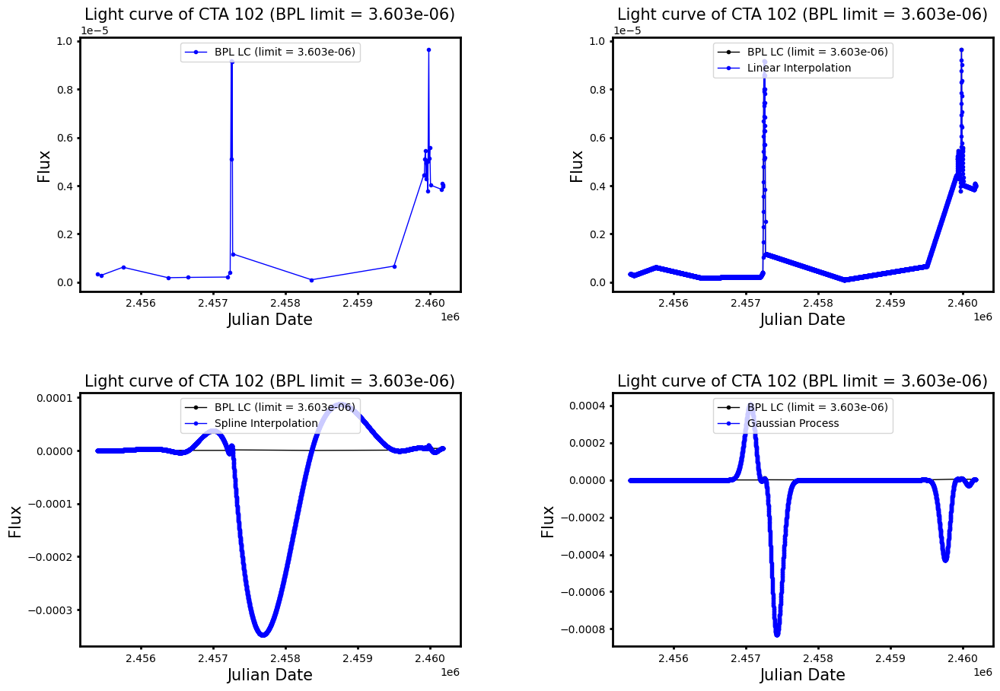

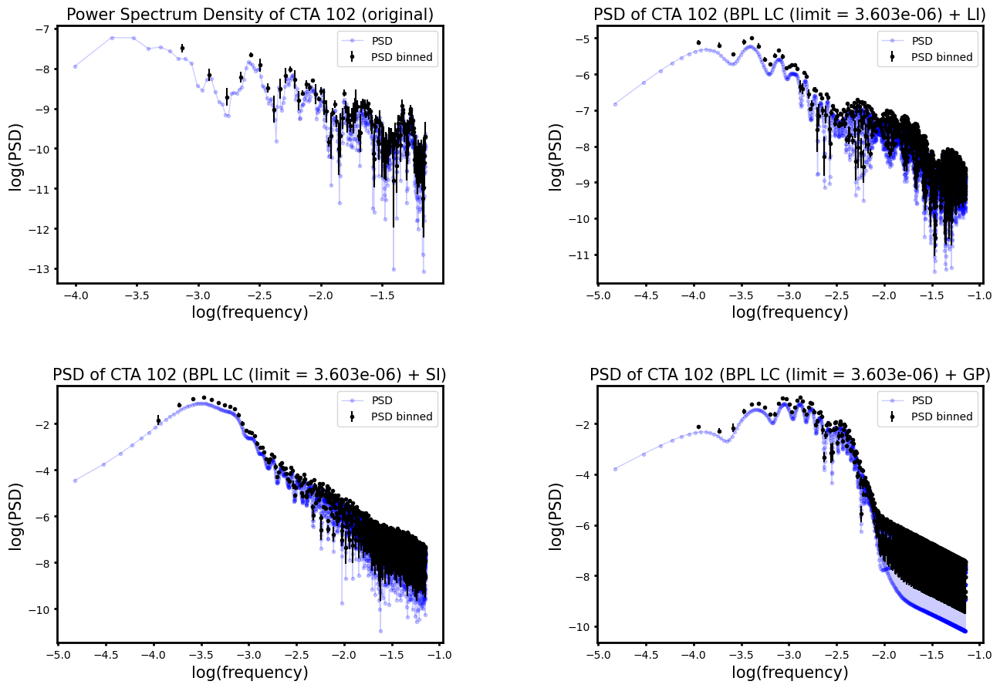

...

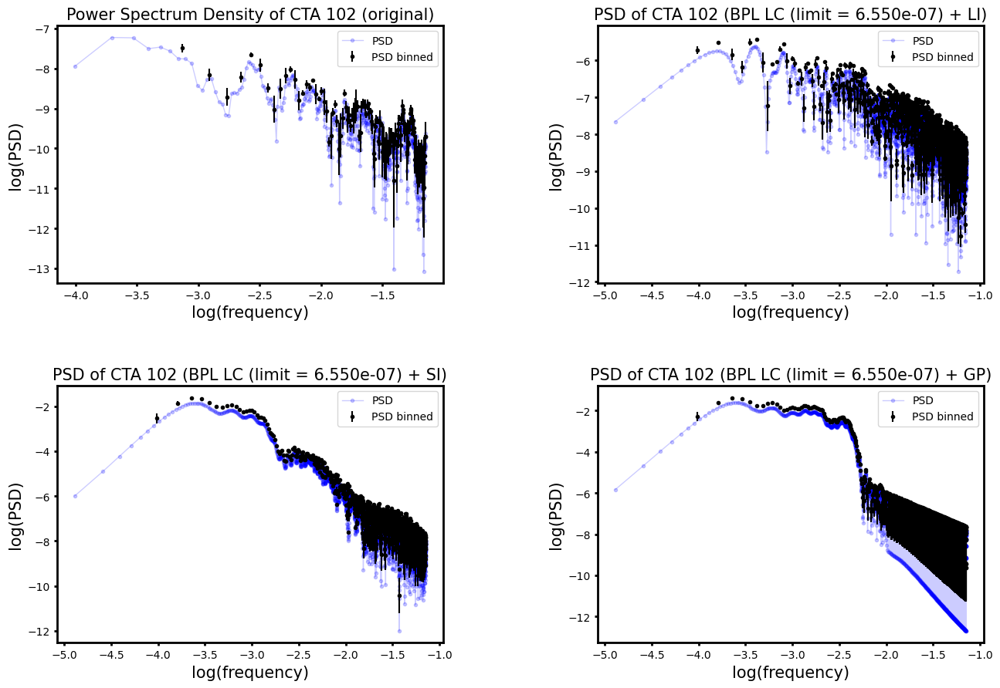

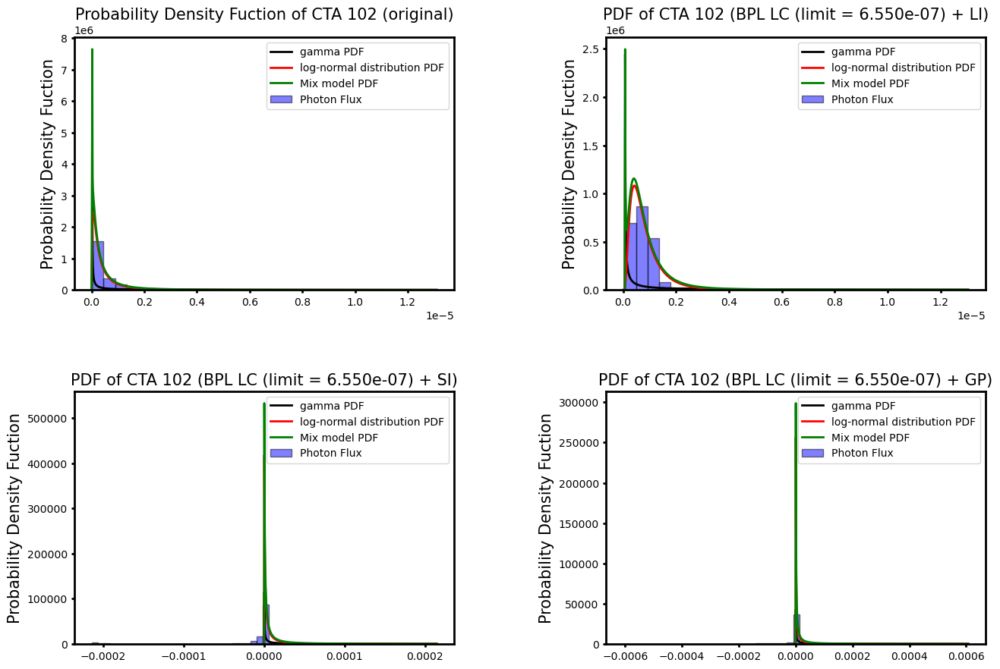

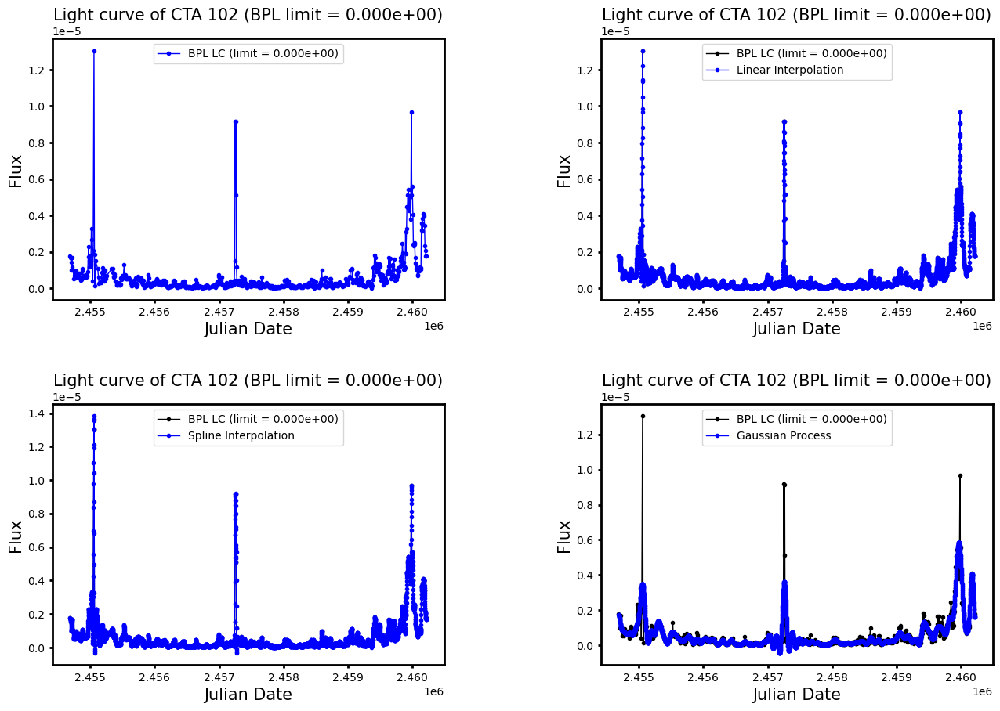

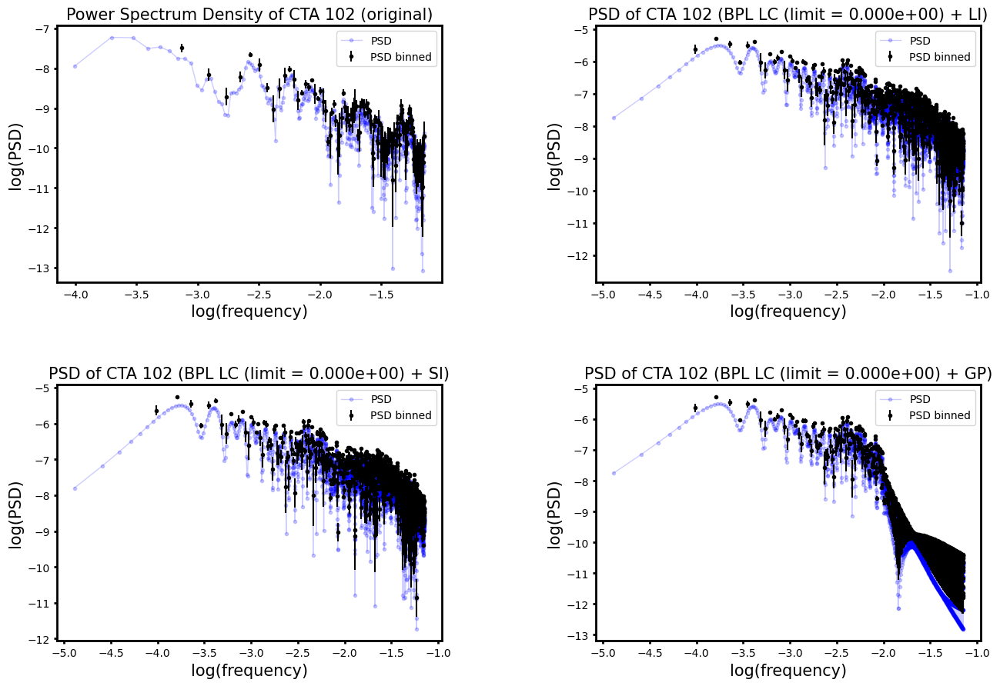

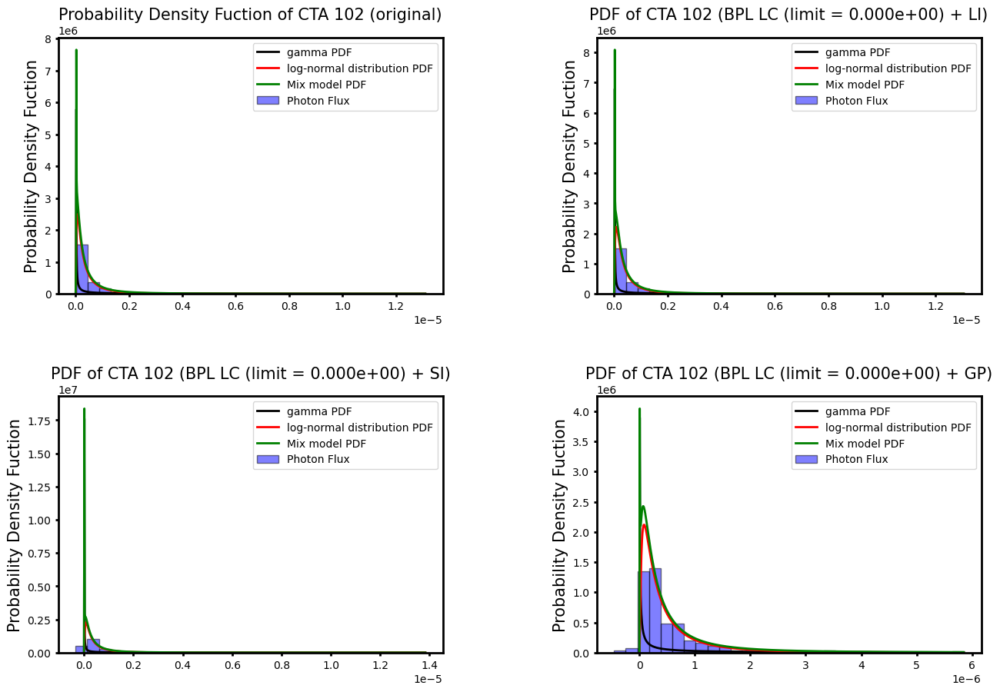

In [25]:
limit_SBPL[-1] = 0
for ss in range(len(data_S)):
    timex = data_SBPL[ss]['Time']
    fluxy = data_SBPL[ss]['Flux']
    if len(timex) > 2:
        time_interp, flux_interp, flux_interp2, flux_mean, flux_std = inter(timex, fluxy)

        fig = plt.figure(figsize=(15, 10))
        fig.set_facecolor('white')
        gs = GridSpec(2, 2, figure=fig)
        plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

        g2 = fig.add_subplot(gs[0, 0])
        g2.plot(timex, fluxy,'b-o',linewidth=1, markersize = 3, label = 'BPL LC (limit = {:.3e})'.format(limit_SBPL[ss]))

        g = fig.add_subplot(gs[0, 1])
        plotthing(timex, fluxy,time_interp, flux_interp, 'Linear Interpolation', 'BPL LC (limit = {:.3e})'.format(limit_SBPL[ss]),'Light curve of CTA 102 (BPL limit = {:.3e})'.format(limit_SBPL[ss]), g)

        g = fig.add_subplot(gs[1, 0])
        plotthing(timex, fluxy,time_interp, flux_interp2, 'Spline Interpolation', 'BPL LC (limit = {:.3e})'.format(limit_SBPL[ss]),'Light curve of CTA 102 (BPL limit = {:.3e})'.format(limit_SBPL[ss]), g)

        g = fig.add_subplot(gs[1, 1])
        plotthing(timex, fluxy,time_interp, flux_mean, 'Gaussian Process', 'BPL LC (limit = {:.3e})'.format(limit_SBPL[ss]),'Light curve of CTA 102 (BPL limit = {:.3e})'.format(limit_SBPL[ss]), g)

        g2.set_ylabel('Flux',fontsize=15)
        g2.set_xlabel('Julian Date',fontsize=15)
        g2.set_title('Light curve of CTA 102 (BPL limit = {:.3e})'.format(limit_SBPL[ss]),fontsize=15)
        g2.legend(fontsize = 10, loc = 'upper center')
        for spine in ['top', 'right','bottom','left']:
            g2.spines[spine].set_linewidth(2)
        g2.tick_params(labelsize=10,length=3,width=2)

        fig4 = plt.figure(figsize=(15, 10))
        fig4.set_facecolor('white')
        gs = GridSpec(2, 2, figure=fig4)
        plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

        g = fig4.add_subplot(gs[0, 0])
        plot_psd(dft, fj, fmean, rpsd, err_psd, 'Power Spectrum Density of CTA 102 (original)', g)

        g = fig4.add_subplot(gs[0, 1])
        dft0, fj0, fmean0, rpsd0, err_psd0 = psd_cal(time_interp, flux_interp, CTAdata['Photon Flux Error(photons cm-2 s-1)'])
        plot_psd(dft0, fj0, fmean0, rpsd0, err_psd0, 'PSD of CTA 102 (BPL LC (limit = {:.3e}) + LI)'.format(limit_SBPL[ss]), g)
        add_datapsd(len(time_interp), 'BPL LC (limit = {:.3e}) LI'.format(limit_SBPL[ss]), dft0, fj0, rpsd0, fmean0, err_psd0)

        g = fig4.add_subplot(gs[1, 0])
        dft0, fj0, fmean0, rpsd0, err_psd0 = psd_cal(time_interp, flux_interp2, CTAdata['Photon Flux Error(photons cm-2 s-1)'])
        plot_psd(dft0, fj0, fmean0, rpsd0, err_psd0, 'PSD of CTA 102 (BPL LC (limit = {:.3e}) + SI)'.format(limit_SBPL[ss]), g)
        add_datapsd(len(time_interp), 'BPL LC (limit = {:.3e}) SI'.format(limit_SBPL[ss]), dft0, fj0, rpsd0, fmean0, err_psd0)

        g = fig4.add_subplot(gs[1, 1])
        dft0, fj0, fmean0, rpsd0, err_psd0 = psd_cal(time_interp, flux_mean, CTAdata['Photon Flux Error(photons cm-2 s-1)'])
        plot_psd(dft0, fj0, fmean0, rpsd0, err_psd0, 'PSD of CTA 102 (BPL LC (limit = {:.3e}) + GP)'.format(limit_SBPL[ss]), g)
        add_datapsd(len(time_interp), 'BPL LC (limit = {:.3e}) GP'.format(limit_SBPL[ss]), dft0, fj0, rpsd0, fmean0, err_psd0)


        fig3 = plt.figure(figsize=(15, 10))
        fig3.set_facecolor('white')
        gs = GridSpec(2, 2, figure=fig3)
        plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

        g = fig3.add_subplot(gs[0, 0])
        plot_pdf(data_pdf, data_pdf2, pdf_light, pdf_light2, 'Probability Density Fuction of CTA 102 (original)', CTAdata['Photon Flux [0.1-100 GeV](photons cm-2 s-1)'], g )

        g = fig3.add_subplot(gs[0, 1])
        kappa, theta, lnmu, lnsig, data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o = pdf_cal(flux_interp)
        add_datapdfs(len(flux_interp), 'BPL LC (limit = {:.3e}) LI'.format(limit_SBPL[ss]), kappa, theta, lnmu, lnsig, data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o)
        plot_pdf(data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o, 'PDF of CTA 102 (BPL LC (limit = {:.3e}) + LI)'.format(limit_SBPL[ss]), flux_interp, g )

        g = fig3.add_subplot(gs[1, 0])
        kappa, theta, lnmu, lnsig, data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o = pdf_cal(abs(flux_interp2))
        plot_pdf(data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o, 'PDF of CTA 102 (BPL LC (limit = {:.3e}) + SI)'.format(limit_SBPL[ss]), flux_interp2, g)
        add_datapdfs(len(flux_interp2), 'BPL LC (limit = {:.3e}) SI'.format(limit_SBPL[ss]), kappa, theta, lnmu, lnsig, data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o)

        g = fig3.add_subplot(gs[1, 1])
        kappa, theta, lnmu, lnsig, data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o = pdf_cal(abs(flux_mean))
        plot_pdf(data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o, 'PDF of CTA 102 (BPL LC (limit = {:.3e}) + GP)'.format(limit_SBPL[ss]), flux_mean, g )
        add_datapdfs(len(flux_mean), 'BPL LC (limit = {:.3e}) GP'.format(limit_SBPL[ss]), kappa, theta, lnmu, lnsig, data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o)


## PDF + CPL

/home/loramaya/funs_CTA102masterCodev4.py:322: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  gp.fit(timex[:, np.newaxis], fluxy)
/home/loramaya/anaconda3/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/home/loramaya/anaconda3/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified upper bound 100.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/home/loramaya/funs_CTA102masterCodev4.py:40: RuntimeWarning: divide by zero encountered in log10
  fre

Kappa, loc, theta 0.07368579554232225 1.0020032603999998e-07 1
Kappa, loc, theta 0.09365548572798826 3.375619273963471e-09 1
Kappa, loc, theta 0.1244934160715074 8.081602845483471e-24 1


/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:322: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  gp.fit(timex[:, np.newaxis], fluxy)
/home/loramaya/anaconda3/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/home

Kappa, loc, theta 0.07136378321793593 8.353474320599998e-08 1
Kappa, loc, theta 0.07652695122842929 2.377548145142534e-10 1
Kappa, loc, theta 0.07040535253036403 9.082288395193368e-13 1


/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:322: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version

Kappa, loc, theta 0.0686238110262544 9.224699818899998e-08 1
Kappa, loc, theta 0.07167323458015484 1.8798828814013185e-10 1
Kappa, loc, theta 0.15734487138677522 8.335997343045043e-11 1


/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:322: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  gp.fit(timex[:, np.newaxis], fluxy)
/home/loramaya/anaconda3/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/home

Kappa, loc, theta 0.06845754675504931 2.3807252084999998e-08 1
Kappa, loc, theta 0.06961651839318722 1.6223144781167933e-09 1
Kappa, loc, theta 0.06968429390044853 1.0643930181686299e-11 1


/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data_pdfs0 = data_pdfs0.append({'Number Points':n,'LC/LC section': LCp, 'Kappa': Kappa, 'Theta': theta, 'lnmu':lnmu, 'lnsig':lnsig, 'dPDF':data_pdf, 'dPDFlog':data_pdf2, 'PDF':pdf_light, 'PDFlog':pdf_light2}, ignore_index = True)
/home/loramaya/funs_CTA102masterCodev4.py:378: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat inste

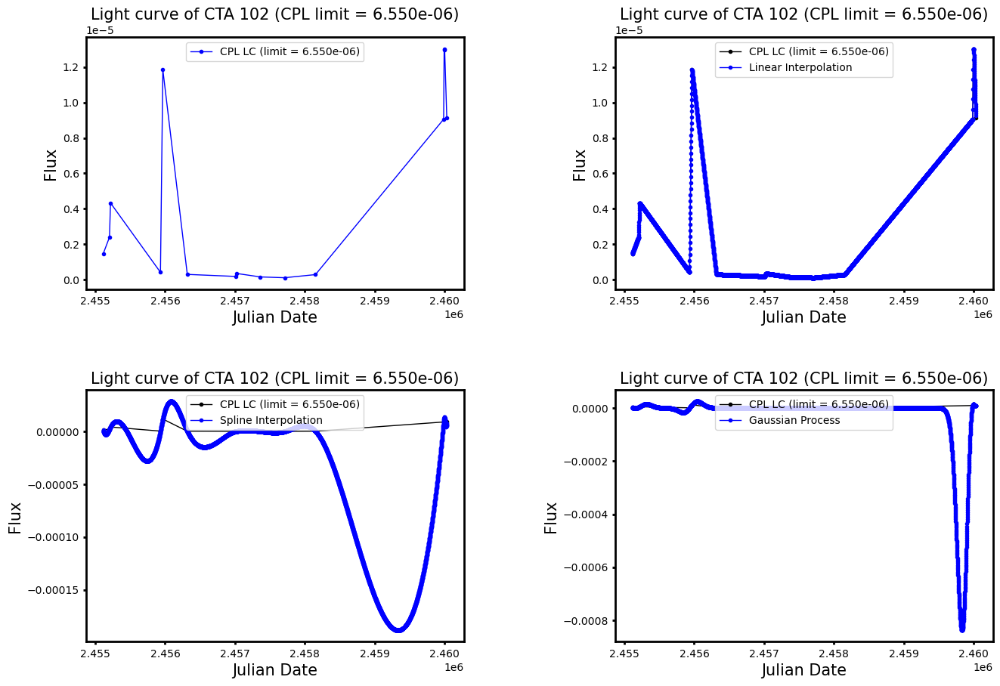

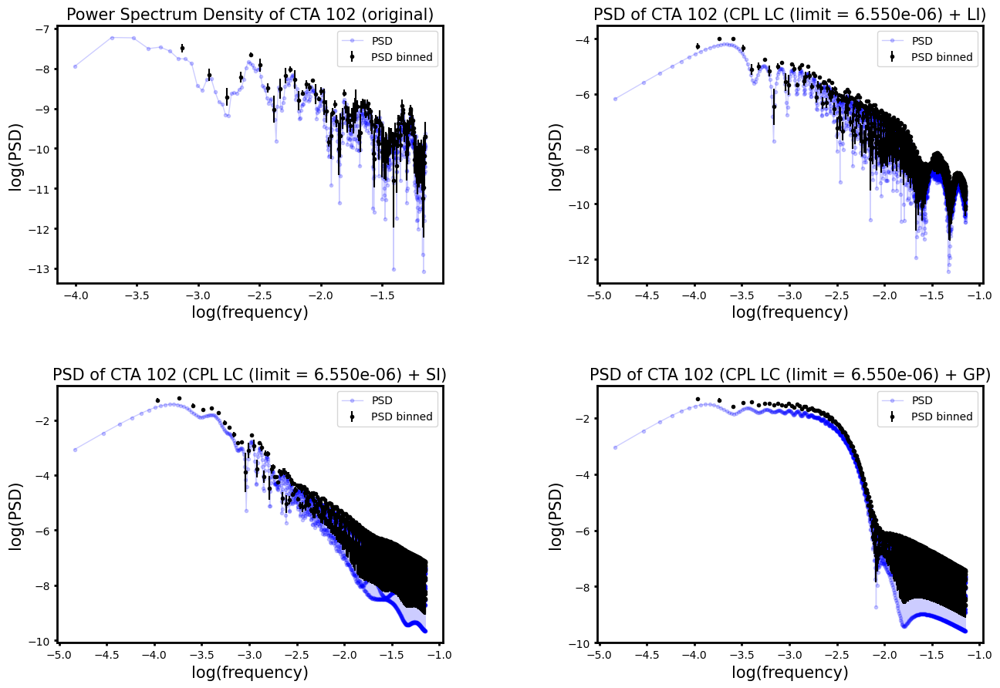

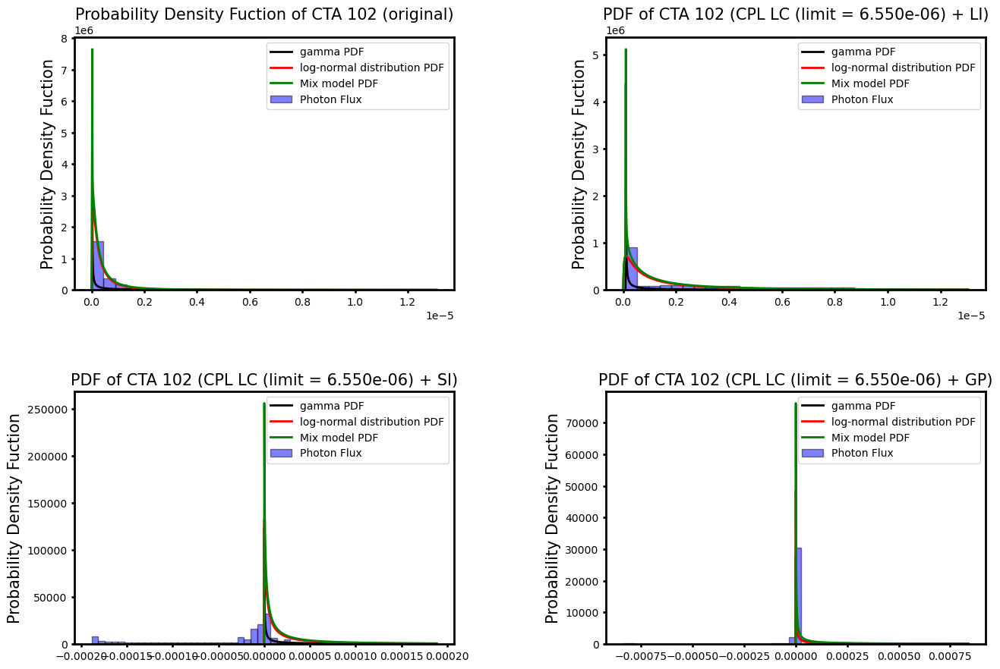

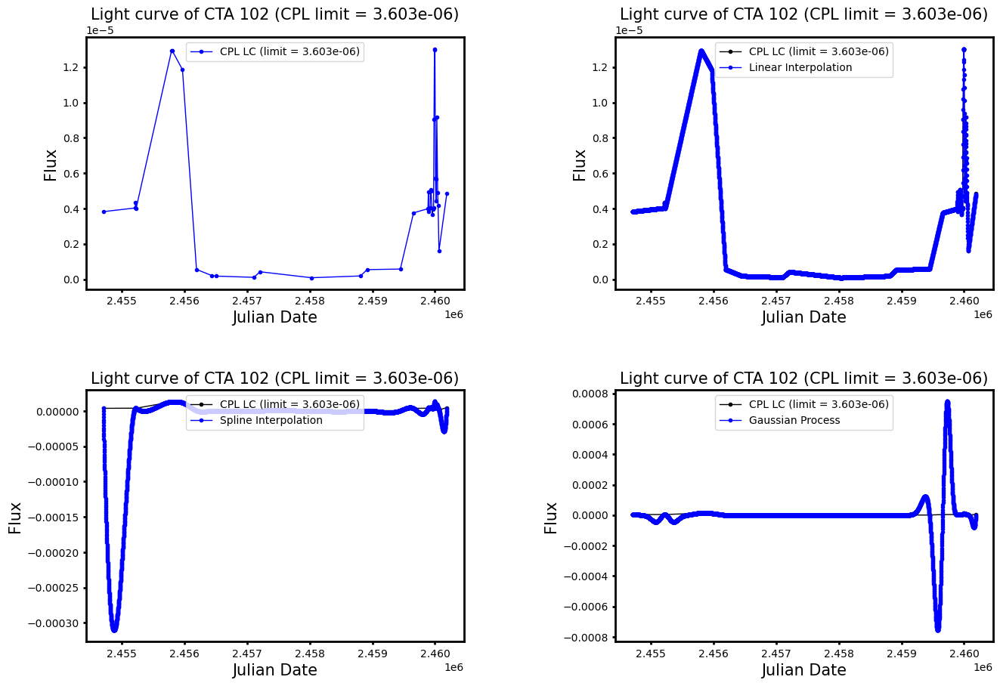

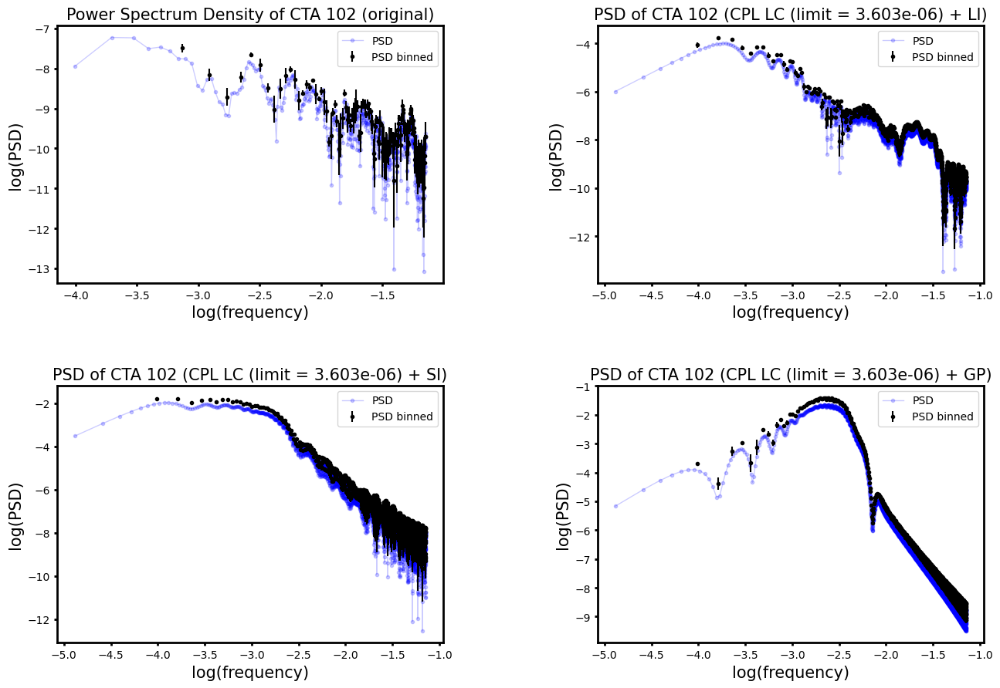

...

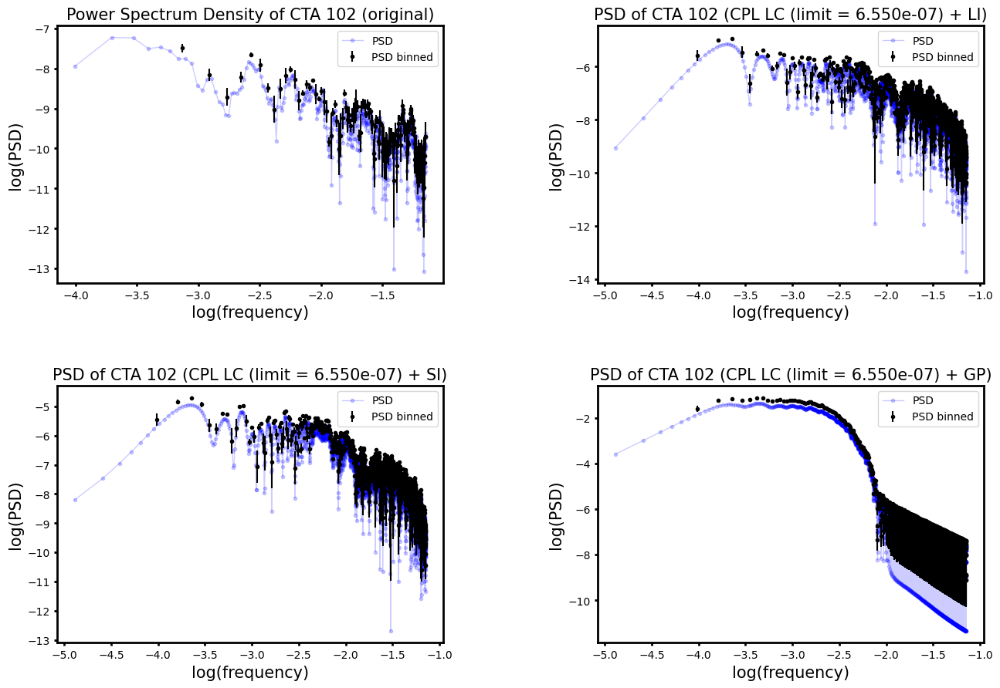

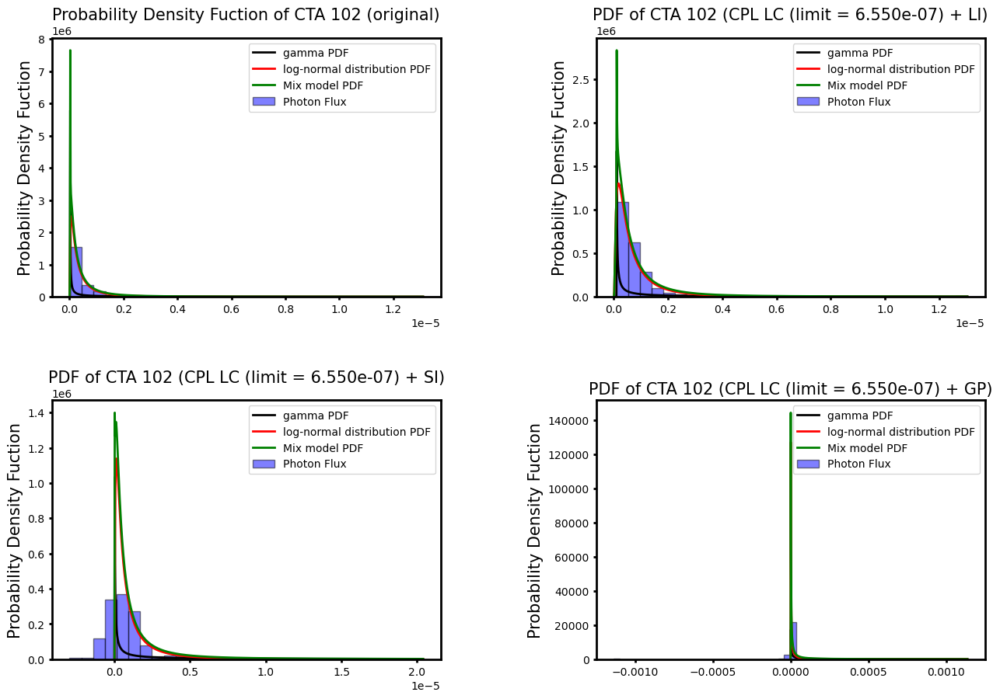

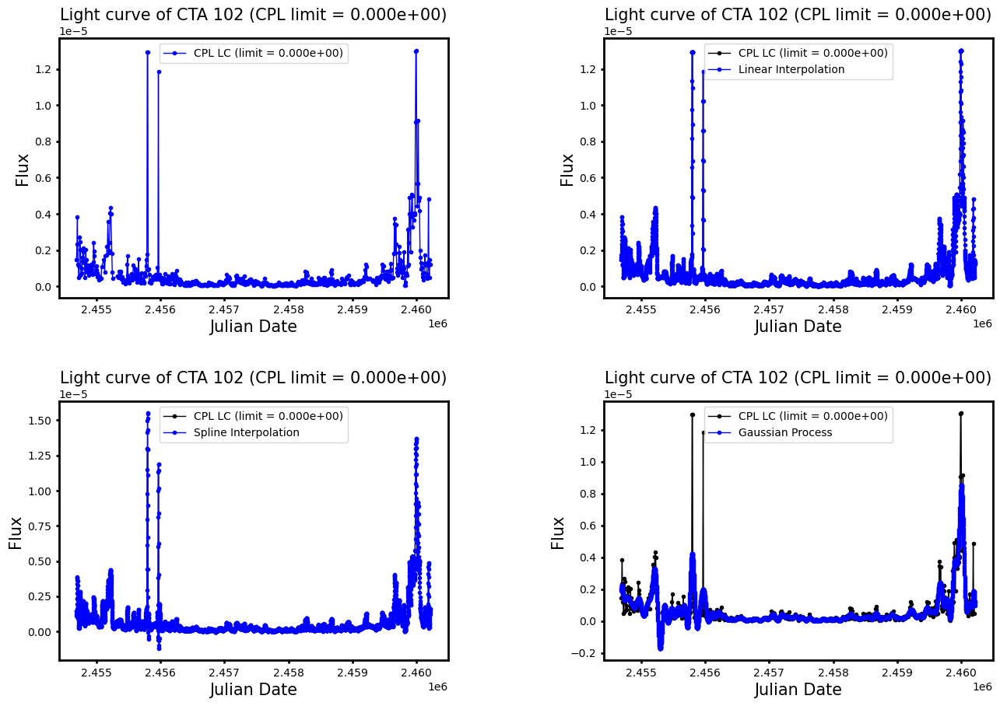

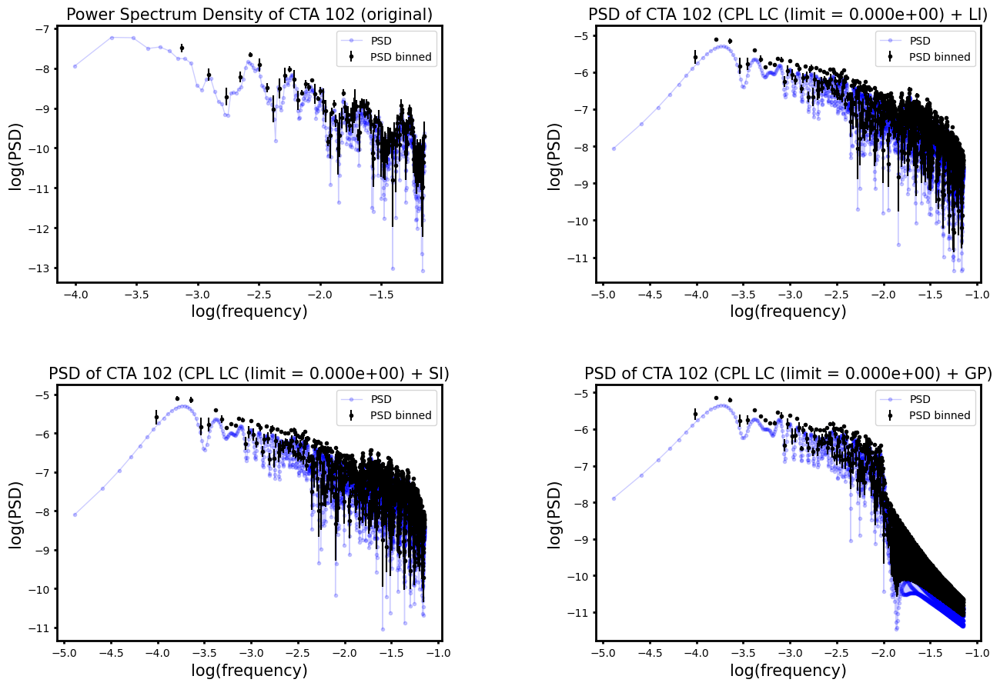

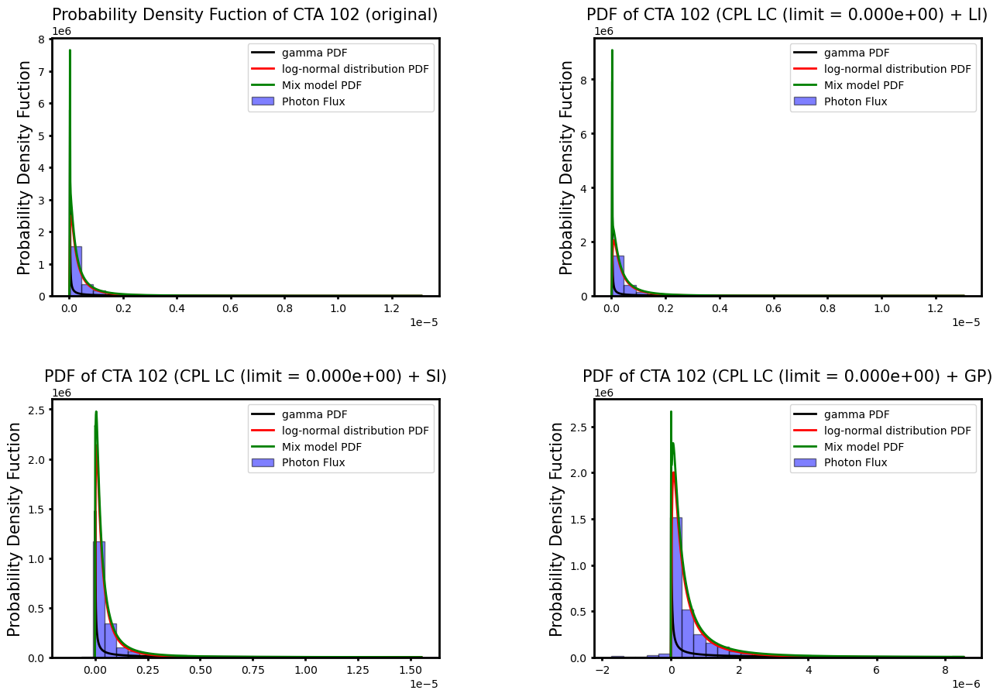

In [26]:
limit_SCPL[-1] = 0
for ss in range(len(data_S)):
    timex = data_SCPL[ss]['Time']
    fluxy = data_SCPL[ss]['Flux']
    if len(timex) > 2:
        time_interp, flux_interp, flux_interp2, flux_mean, flux_std = inter(timex, fluxy)

        fig = plt.figure(figsize=(15, 10))
        fig.set_facecolor('white')
        gs = GridSpec(2, 2, figure=fig)
        plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

        g2 = fig.add_subplot(gs[0, 0])
        g2.plot(timex, fluxy,'b-o',linewidth=1, markersize = 3, label = 'CPL LC (limit = {:.3e})'.format(limit_SCPL[ss]))

        g = fig.add_subplot(gs[0, 1])
        plotthing(timex, fluxy,time_interp, flux_interp, 'Linear Interpolation', 'CPL LC (limit = {:.3e})'.format(limit_SCPL[ss]),'Light curve of CTA 102 (CPL limit = {:.3e})'.format(limit_SCPL[ss]), g)

        g = fig.add_subplot(gs[1, 0])
        plotthing(timex, fluxy,time_interp, flux_interp2, 'Spline Interpolation', 'CPL LC (limit = {:.3e})'.format(limit_SCPL[ss]),'Light curve of CTA 102 (CPL limit = {:.3e})'.format(limit_SCPL[ss]), g)

        g = fig.add_subplot(gs[1, 1])
        plotthing(timex, fluxy,time_interp, flux_mean, 'Gaussian Process', 'CPL LC (limit = {:.3e})'.format(limit_SCPL[ss]),'Light curve of CTA 102 (CPL limit = {:.3e})'.format(limit_SCPL[ss]), g)

        g2.set_ylabel('Flux',fontsize=15)
        g2.set_xlabel('Julian Date',fontsize=15)
        g2.set_title('Light curve of CTA 102 (CPL limit = {:.3e})'.format(limit_SCPL[ss]),fontsize=15)
        g2.legend(fontsize = 10, loc = 'upper center')
        for spine in ['top', 'right','bottom','left']:
            g2.spines[spine].set_linewidth(2)
        g2.tick_params(labelsize=10,length=3,width=2)

        fig4 = plt.figure(figsize=(15, 10))
        fig4.set_facecolor('white')
        gs = GridSpec(2, 2, figure=fig4)
        plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

        g = fig4.add_subplot(gs[0, 0])
        plot_psd(dft, fj, fmean, rpsd, err_psd, 'Power Spectrum Density of CTA 102 (original)', g)

        g = fig4.add_subplot(gs[0, 1])
        dft0, fj0, fmean0, rpsd0, err_psd0 = psd_cal(time_interp, flux_interp, CTAdata['Photon Flux Error(photons cm-2 s-1)'])
        plot_psd(dft0, fj0, fmean0, rpsd0, err_psd0, 'PSD of CTA 102 (CPL LC (limit = {:.3e}) + LI)'.format(limit_SCPL[ss]), g)
        add_datapsd(len(time_interp), 'CPL LC (limit = {:.3e}) LI'.format(limit_SCPL[ss]), dft0, fj0, rpsd0, fmean0, err_psd0)

        g = fig4.add_subplot(gs[1, 0])
        dft0, fj0, fmean0, rpsd0, err_psd0 = psd_cal(time_interp, flux_interp2, CTAdata['Photon Flux Error(photons cm-2 s-1)'])
        plot_psd(dft0, fj0, fmean0, rpsd0, err_psd0, 'PSD of CTA 102 (CPL LC (limit = {:.3e}) + SI)'.format(limit_SCPL[ss]), g)
        add_datapsd(len(time_interp), 'CPL LC (limit = {:.3e}) SI'.format(limit_SCPL[ss]), dft0, fj0, rpsd0, fmean0, err_psd0)

        g = fig4.add_subplot(gs[1, 1])
        dft0, fj0, fmean0, rpsd0, err_psd0 = psd_cal(time_interp, flux_mean, CTAdata['Photon Flux Error(photons cm-2 s-1)'])
        plot_psd(dft0, fj0, fmean0, rpsd0, err_psd0, 'PSD of CTA 102 (CPL LC (limit = {:.3e}) + GP)'.format(limit_SCPL[ss]), g)
        blaaa = add_datapsd(len(time_interp), 'CPL LC (limit = {:.3e}) GP'.format(limit_SCPL[ss]), dft0, fj0, rpsd0, fmean0, err_psd0)


        fig3 = plt.figure(figsize=(15, 10))
        fig3.set_facecolor('white')
        gs = GridSpec(2, 2, figure=fig3)
        plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

        g = fig3.add_subplot(gs[0, 0])
        plot_pdf(data_pdf, data_pdf2, pdf_light, pdf_light2, 'Probability Density Fuction of CTA 102 (original)', CTAdata['Photon Flux [0.1-100 GeV](photons cm-2 s-1)'], g )

        g = fig3.add_subplot(gs[0, 1])
        kappa, theta, lnmu, lnsig, data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o = pdf_cal(flux_interp)
        add_datapdfs(len(flux_interp), 'CPL LC (limit = {:.3e}) LI'.format(limit_SCPL[ss]), kappa, theta, lnmu, lnsig, data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o)
        plot_pdf(data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o, 'PDF of CTA 102 (CPL LC (limit = {:.3e}) + LI)'.format(limit_SCPL[ss]), flux_interp, g )

        g = fig3.add_subplot(gs[1, 0])
        kappa, theta, lnmu, lnsig, data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o = pdf_cal(abs(flux_interp2))
        plot_pdf(data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o, 'PDF of CTA 102 (CPL LC (limit = {:.3e}) + SI)'.format(limit_SCPL[ss]), flux_interp2, g )
        add_datapdfs(len(flux_interp2), 'CPL LC (limit = {:.3e}) SI'.format(limit_SCPL[ss]), kappa, theta, lnmu, lnsig, data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o)

        g = fig3.add_subplot(gs[1, 1])
        kappa, theta, lnmu, lnsig, data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o = pdf_cal(abs(flux_mean))
        plot_pdf(data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o, 'PDF of CTA 102 (CPL LC (limit = {:.3e}) + GP)'.format(limit_SCPL[ss]), flux_mean, g )
        blabla = add_datapdfs(len(flux_mean), 'CPL LC (limit = {:.3e}) GP'.format(limit_SCPL[ss]), kappa, theta, lnmu, lnsig, data_pdfo, data_pdf2o, pdf_lighto, pdf_light2o)


In [27]:
data_psd = blaaa
data_pdfs = blabla

In [28]:
# pd.set_option('display.max_rows', None)  
# pd.set_option('display.max_columns', None) 
# pd.set_option('display.width', None)

In [29]:
data_pdfs

,Number Points,LC/LC section,Kappa,Theta,lnmu,lnsig,dPDF,dPDFlog,PDF,PDFlog
0,727,Original,0.067762,1,-0.715743,1.196448,"[0.0, 1.3113113113113113e-08, 2.62262262262262...","[0.0, 1.3113113113113113e-08, 2.62262262262262...","[0.0, 0.0, 5784969.197796982, 1274978.07720552...","[0.0, 1013483.697252679, 1864857.459270747, 22..."
1,13,Sim:6.550e-06,0.067803,1,-2.098735,2.048773,"[0.0, 1.309450220920921e-08, 2.618900441841842...","[0.0, 1.309450220920921e-08, 2.618900441841842...","[0.0, 0.0, 0.0, 0.0, 1585900.4643053603, 82613...","[0.0, 2860116.7680849005, 2496283.3787541795, ..."
2,25,Sim:3.603e-06,0.128861,1,-1.598361,1.787938,"[0.0, 1.309450220920921e-08, 2.618900441841842...","[0.0, 1.309450220920921e-08, 2.618900441841842...","[0.0, 0.0, 0.0, 1311723.9837786984, 622853.089...","[0.0, 549988.8381023242, 704511.086480697, 759..."
3,175,Sim:6.550e-07,0.075367,1,-0.286224,0.756604,"[0.0, 1.309450220920921e-08, 2.618900441841842...","[0.0, 1.309450220920921e-08, 2.618900441841842...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.5016490226320057, 41.45969876635182, 3..."
4,727,Sim without lim,0.104588,1,-0.671322,1.158725,"[0.0, 1.309450220920921e-08, 2.618900441841842...","[0.0, 1.309450220920921e-08, 2.618900441841842...","[0.0, 0.0, 5061915.2498057885, 1061158.4630669...","[0.0, 769984.4721310026, 1577993.8428482015, 2..."
...,...,...,...,...,...,...,...,...,...,...
63,5530,CPL LC (limit = 6.550e-07) SI,0.071673,1,-0.764355,1.236410,"[0.0, 2.041116222000446e-08, 4.082232444000892...","[0.0, 2.041116222000446e-08, 4.082232444000892...","[0.0, 1033323.682958899, 540645.5783318251, 37...","[0.0, 365781.6355228914, 728048.702673293, 941..."
64,5530,CPL LC (limit = 6.550e-07) GP,0.157345,1,-3.816923,2.762942,"[0.0, 1.1367301198136645e-06, 2.27346023962732...","[0.0, 1.1367301198136645e-06, 2.27346023962732...","[0.0, 17263.29033797101, 9625.98525340564, 683...","[0.0, 126992.30987977449, 61192.93169239406, 3..."
65,5530,CPL LC (limit = 0.000e+00) LI,0.068458,1,-0.652776,1.142607,"[0.0, 1.305128153153153e-08, 2.610256306306306...","[0.0, 1.305128153153153e-08, 2.610256306306306...","[0.0, 0.0, 7919625.802872554, 1349035.47910146...","[0.0, 505705.3807563545, 1161936.236284666, 15..."
66,5530,CPL LC (limit = 0.000e+00) SI,0.069617,1,-0.707828,1.189813,"[0.0, 1.551498528680804e-08, 3.102997057361608...","[0.0, 1.551498528680804e-08, 3.102997057361608...","[0.0, 1474725.5235774666, 734021.634693704, 49...","[0.0, 860029.9174112527, 1593100.92497764, 195..."


In [30]:
data_psd

,Number Points,LC/LC section,PSD,Freq,PSDb,Freqmean,err
0,727,Original,"[-7.9493099955007684, -7.224754897675746, -7.2...","[-4.007662446537276, -3.7066324508732946, -3.5...","[-7.22735671604517, -7.488760653325456, -8.166...","[0.0002456278247199843, 0.0007368834741599529,...","[0.2943669473074984, 0.11003706229561387, 0.15..."
1,13,Sim:6.550e-06,"[-9.634949366497631, -9.671823173965347, -9.52...","[-2.2600713879850747, -1.9590413923210936, -1....","[-9.51474442938288, -9.363296890814798]","[0.013736263736263734, 0.0412087912087912]","[0.27463807785732275, 0.5531062717099805]"
2,25,Sim:3.603e-06,"[-9.526753199983943, -9.336297512652342, -9.07...","[-2.5440680443502757, -2.2430380486862944, -2....","[-9.164565324792772, -9.216710743492616, -9.17...","[0.007142857142857145, 0.02142857142857143, 0....","[0.23615199989977467, 0.5336250685372905, 0.31..."
3,175,Sim:6.550e-07,"[-8.668160603531897, -8.025173107575808, -8.49...","[-3.3891660843645326, -3.0881360887005513, -2....","[-8.123013893619571, -8.727646560935597, -8.64...","[0.001020408163265306, 0.0030612244897959178, ...","[0.23807547511556246, 0.42737505018881566, 0.5..."
4,727,Sim without lim,"[-8.618292076343266, -7.936235945320372, -7.92...","[-4.007662446537276, -3.7066324508732946, -3.5...","[-7.74902584735677, -7.48703497956068, -7.9719...","[0.0002456278247199843, 0.0007368834741599529,...","[0.3944233499813076, 0.15212411824532465, 0.16..."
...,...,...,...,...,...,...,...
63,5530,CPL LC (limit = 6.550e-07) SI,"[-8.203764378182047, -7.464532432719402, -6.95...","[-4.888853166982936, -4.587823171318955, -4.41...","[-7.046677365088427, -5.447849156612513, -4.85...","[3.229139757168691e-05, 9.68741927150607e-05, ...","[0.6129933915221477, 0.2042862590363309, 0.076..."
64,5530,CPL LC (limit = 6.550e-07) GP,"[-3.59860161714037, -2.9953677604176434, -2.64...","[-4.888853166982936, -4.587823171318955, -4.41...","[-2.6558221674058853, -1.612879109807599, -1.2...","[3.229139757168691e-05, 9.68741927150607e-05, ...","[0.45371024165207535, 0.12375888845341394, 0.0..."
65,5530,CPL LC (limit = 0.000e+00) LI,"[-8.065839926735423, -7.393512436893447, -6.95...","[-4.888853166982936, -4.587823171318955, -4.41...","[-7.003401015019227, -5.5907752361115435, -5.1...","[3.229139757168691e-05, 9.68741927150607e-05, ...","[0.545371764736995, 0.1796034065738678, 0.0465..."
66,5530,CPL LC (limit = 0.000e+00) SI,"[-8.103162696672554, -7.4224040041301, -6.9700...","[-4.888853166982936, -4.587823171318955, -4.41...","[-7.028067302090828, -5.589945836152036, -5.09...","[3.229139757168691e-05, 9.68741927150607e-05, ...","[0.5546152375508732, 0.1821877591844887, 0.047..."


# Original vs Original interpolated:

In [31]:
original_psd = data_psd[data_psd['LC/LC section'].isin(['Original', 'Original LI', 'Original SI', 'Original GP'])]
original_psd = original_psd.reset_index(drop = True)
original_pdf = data_pdfs[data_pdfs['LC/LC section'].isin(['Original', 'Original LI', 'Original SI', 'Original GP'])]
original_pdf = original_pdf.reset_index(drop = True)

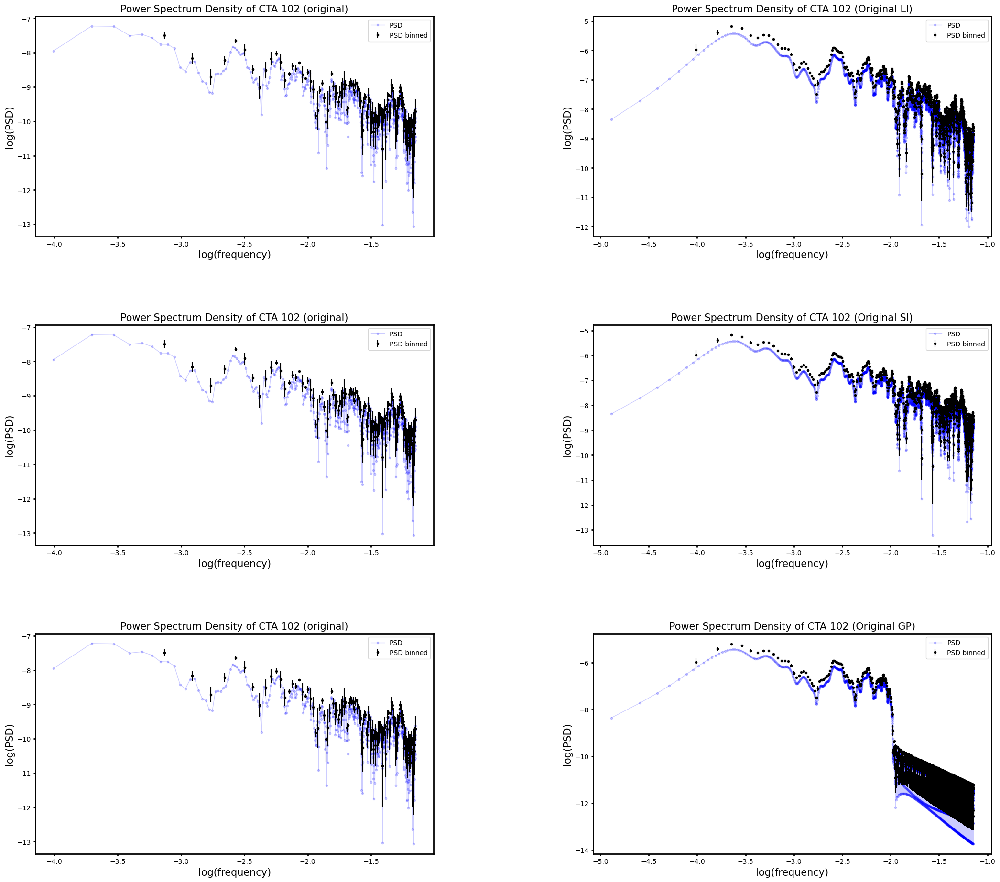

In [32]:
fig2 = plt.figure(figsize=(25, 30))
fig2.set_facecolor('white')
gs = GridSpec(len(original_psd), 2, figure=fig2)
plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

for pg in range(len(original_psd)):
    if pg != 0:
        g = fig2.add_subplot(gs[pg, 0])
        plot_psd(original_psd['PSD'][0], original_psd['Freq'][0], original_psd['Freqmean'][0], original_psd['PSDb'][0], err_psd, 'Power Spectrum Density of CTA 102 (original)', g)
        g = fig2.add_subplot(gs[pg, 1])
        plot_psd(original_psd['PSD'][pg], original_psd['Freq'][pg], original_psd['Freqmean'][pg], original_psd['PSDb'][pg], original_psd['err'][pg], 'Power Spectrum Density of CTA 102 ({})'.format(original_psd['LC/LC section'][pg]), g)
#         g = fig2.add_subplot(gs[pg, 2])
#         plot_psd(original_psd['PSD'][0] - original_psd['PSD'][pg], original_psd['Freq'][pg], original_psd['Freqmean'][pg], original_psd['PSDb'][0] - original_psd['PSDb'][pg], err_psd - original_psd['err'][pg], 'PSD of CTA 102 ({} - {})'.format(original_psd['LC/LC section'][0], original_psd['LC/LC section'][pg]), g)
    


In [33]:
# c_or = pd.DataFrame()

# c_or['LC/LC section'] = original_pdf['LC/LC section'][1:].unique()

# def calculate_absolute_error(row):
#     abs_ = abs((original_psd['PSD'].iloc[0] - row) / original_psd['PSD'].iloc[0])
#     abs_ = abs_[~np.isnan(abs_)]
#     return np.mean(100 * abs_)
# def calculate_absolute_error2(row):
#     abs_ = abs((original_pdf['PDFlog'].iloc[0] - row) / original_pdf['PDFlog'].iloc[0])
#     abs_ = abs_[~np.isnan(abs_)]
#     return np.mean(100 * abs_)
# def calculate_absolute_error3(row):
#     abs_ = abs((original_psd['PSDb'].iloc[0] - row) / original_psd['PSDb'].iloc[0])
#     abs_ = abs_[~np.isnan(abs_)]
#     return np.mean(100 * abs_)

# c_or['Absolute Error of PSD Regarding Original from FermiLat'] = original_psd['PSD'][1:].reset_index(drop=True).apply(calculate_absolute_error)
# c_or['Absolute Error of PSD binned Regarding Original from FermiLat'] = original_psd['PSDb'][1:].reset_index(drop=True).apply(calculate_absolute_error3)

# c_or['Absolute Error of logPDF Regarding Original from FermiLat'] = original_pdf['PDFlog'][1:].reset_index(drop=True).apply(calculate_absolute_error2)
# c_or


# S and S removed vs S interpolated and removed:

In [34]:
simulated_psd = data_psd.loc[1:4].append(data_psd.loc[20:31])
simulated_psd = simulated_psd.reset_index(drop = True)
simulated_pdf = data_pdfs.loc[1:4].append(data_pdfs.loc[20:31])
simulated_pdf = simulated_pdf.reset_index(drop = True)

/tmp/ipykernel_7667/2213875591.py:1: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  simulated_psd = data_psd.loc[1:4].append(data_psd.loc[20:31])
/tmp/ipykernel_7667/2213875591.py:3: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  simulated_pdf = data_pdfs.loc[1:4].append(data_pdfs.loc[20:31])


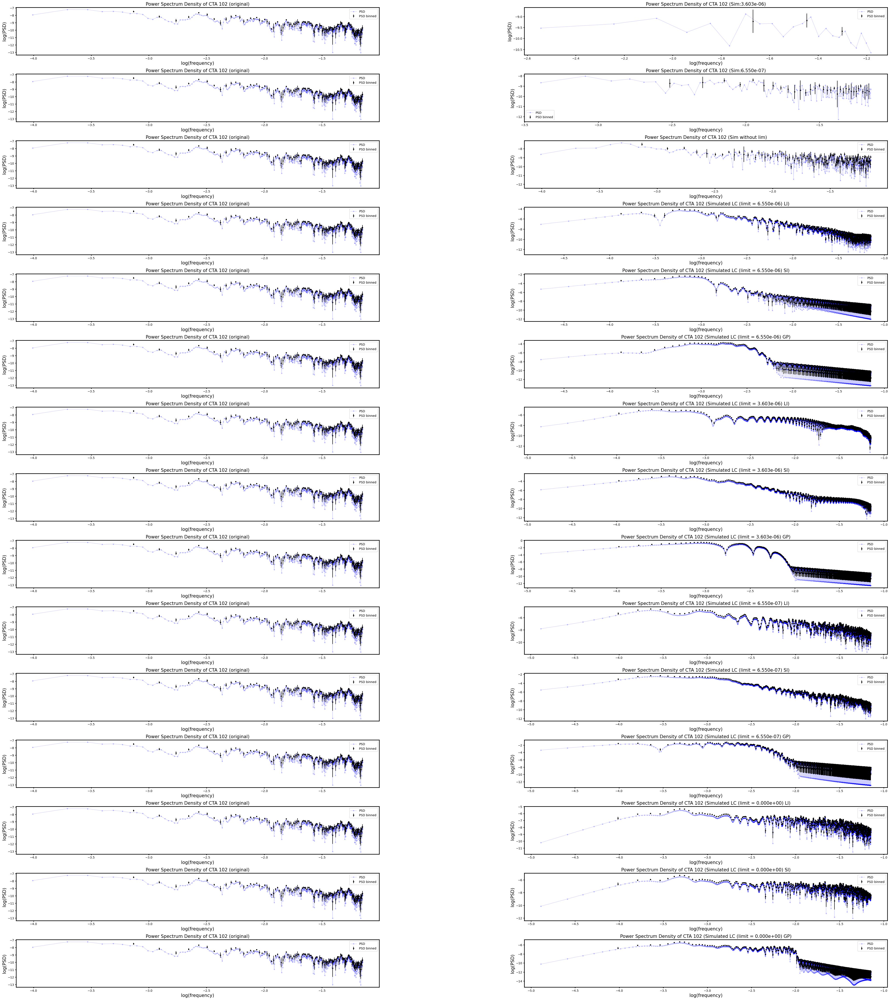

In [35]:
fig2 = plt.figure(figsize=(50, 60))
fig2.set_facecolor('white')
gs = GridSpec(len(simulated_psd), 2, figure=fig2)
plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

for pg in range(len(simulated_psd)):
    if pg != 0:
        g = fig2.add_subplot(gs[pg, 0])
        plot_psd(original_psd['PSD'][0], original_psd['Freq'][0], original_psd['Freqmean'][0], original_psd['PSDb'][0], err_psd, 'Power Spectrum Density of CTA 102 (original)', g)
        g = fig2.add_subplot(gs[pg, 1])
        plot_psd(simulated_psd['PSD'][pg], simulated_psd['Freq'][pg], simulated_psd['Freqmean'][pg], simulated_psd['PSDb'][pg], simulated_psd['err'][pg], 'Power Spectrum Density of CTA 102 ({})'.format(simulated_psd['LC/LC section'][pg]), g)
#         g = fig2.add_subplot(gs[pg, 2])
#         plot_psd(original_psd['PSD'][0] - simulated_psd['PSD'][pg], original_psd['Freq'][0], original_psd['Freqmean'][0], original_psd['PSDb'][0] - simulated_psd['PSDb'][pg], err_psd, 'PSD of CTA 102 ({} - {})'.format(original_psd['LC/LC section'][0], simulated_psd['LC/LC section'][pg]), g)
    

In [36]:
# c_sim = pd.DataFrame()

# c_sim['LC/LC section'] = simulated_pdf['LC/LC section'][:].unique()

# def calculate_absolute_error(row):
#     abs_ = abs((original_psd['PSD'].iloc[0] - row) / original_psd['PSD'].iloc[0])
#     abs_ = abs_[~np.isnan(abs_)]
#     return np.mean(100 * abs_)
# def calculate_absolute_error2(row):
#     abs_ = abs((original_pdf['PDFlog'].iloc[0] - row) / original_pdf['PDFlog'].iloc[0])
#     abs_ = abs_[~np.isnan(abs_)]
#     return np.mean(100 * abs_)
# def calculate_absolute_error3(row):
#     abs_ = abs((original_psd['PSDb'].iloc[0] - row) / original_psd['PSDb'].iloc[0])
#     abs_ = abs_[~np.isnan(abs_)]
#     return np.mean(100 * abs_)

# c_sim['Absolute Error of PSD Regarding Original from FermiLat'] = simulated_psd['PSD'][:].reset_index(drop=True).apply(calculate_absolute_error)
# c_sim['Absolute Error of PSD binned Regarding Original from FermiLat'] = simulated_psd['PSDb'][:].reset_index(drop=True).apply(calculate_absolute_error3)

# c_sim['Absolute Error of logPDF Regarding Original from FermiLat'] = simulated_pdf['PDFlog'][:].reset_index(drop=True).apply(calculate_absolute_error2)
# c_sim

# SPL and SPL removed vs SPL interpolated and removed:

In [37]:
SPL_psd = data_psd.loc[5:8].append(data_psd.loc[32:40])
SPL_psd = SPL_psd.reset_index(drop = True)
SPL_pdf = data_pdfs.loc[5:8].append(data_pdfs.loc[32:40])
SPL_pdf = SPL_pdf.reset_index(drop = True)


/tmp/ipykernel_7667/2818784057.py:1: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  SPL_psd = data_psd.loc[5:8].append(data_psd.loc[32:40])
/tmp/ipykernel_7667/2818784057.py:3: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  SPL_pdf = data_pdfs.loc[5:8].append(data_pdfs.loc[32:40])


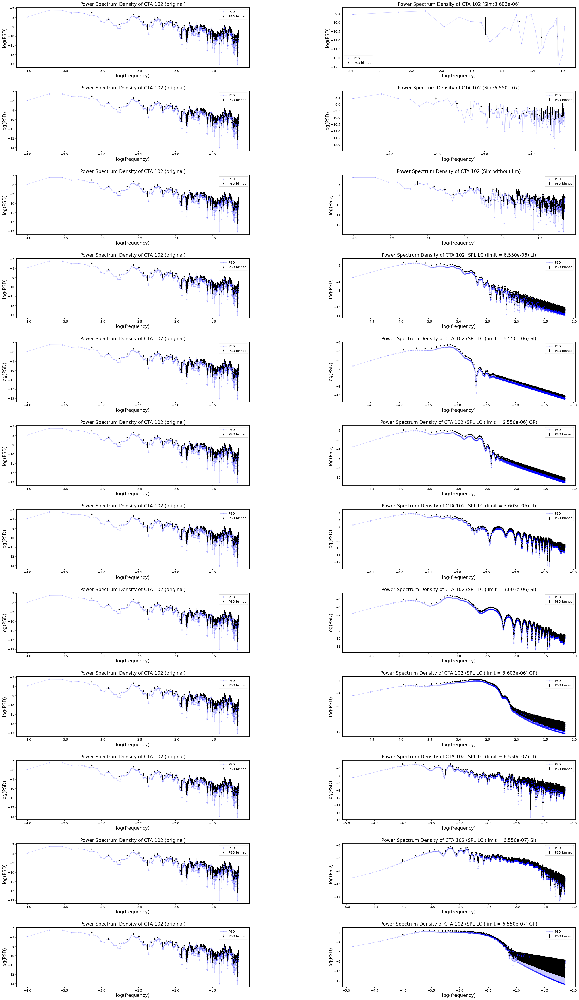

In [38]:
fig2 = plt.figure(figsize=(50, 60))
fig2.set_facecolor('white')
gs = GridSpec(len(SPL_psd), 3, figure=fig2)
plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

for pg in range(len(SPL_psd)):
    if pg != 0:
        g = fig2.add_subplot(gs[pg, 0])
        plot_psd(original_psd['PSD'][0], original_psd['Freq'][0], original_psd['Freqmean'][0], original_psd['PSDb'][0], err_psd, 'Power Spectrum Density of CTA 102 (original)', g)
        g = fig2.add_subplot(gs[pg, 1])
        plot_psd(SPL_psd['PSD'][pg], SPL_psd['Freq'][pg], SPL_psd['Freqmean'][pg], SPL_psd['PSDb'][pg], SPL_psd['err'][pg], 'Power Spectrum Density of CTA 102 ({})'.format(SPL_psd['LC/LC section'][pg]), g)
#         g = fig2.add_subplot(gs[pg, 2])
#         plot_psd(original_psd['PSD'][0] - SPL_psd['PSD'][pg], original_psd['Freq'][0], original_psd['Freqmean'][0], original_psd['PSDb'][0] - SPL_psd['PSDb'][pg], 'PSD of CTA 102 ({} - {})'.format(original_psd['LC/LC section'][0], SPL_psd['LC/LC section'][pg]), g)
    

In [39]:

# c_SPL = pd.DataFrame()

# c_SPL['LC/LC section'] = SPL_pdf['LC/LC section'][:].unique()

# def calculate_absolute_error(row):
#     abs_ = abs((original_psd['PSD'].iloc[0] - row) / original_psd['PSD'].iloc[0])
#     abs_ = abs_[~np.isnan(abs_)]
#     return np.mean(100 * abs_)
# def calculate_absolute_error2(row):
#     abs_ = abs((original_pdf['PDFlog'].iloc[0] - row) / original_pdf['PDFlog'].iloc[0])
#     abs_ = abs_[~np.isnan(abs_)]
#     return np.mean(100 * abs_)
# def calculate_absolute_error3(row):
#     abs_ = abs((original_psd['PSDb'].iloc[0] - row) / original_psd['PSDb'].iloc[0])
#     abs_ = abs_[~np.isnan(abs_)]
#     return np.mean(100 * abs_)

# c_SPL['Absolute Error of PSD Regarding Original from FermiLat'] = SPL_psd['PSD'][:].reset_index(drop=True).apply(calculate_absolute_error)
# c_SPL['Absolute Error of PSD binned Regarding Original from FermiLat'] = SPL_psd['PSDb'][:].reset_index(drop=True).apply(calculate_absolute_error3)

# c_SPL['Absolute Error of logPDF Regarding Original from FermiLat'] = SPL_pdf['PDFlog'][:].reset_index(drop=True).apply(calculate_absolute_error2)
# c_SPL

# BPL and BPL removed vs BPL interpolated and removed:

In [40]:
BPL_psd = data_psd.loc[9:12].append(data_psd.loc[41:52])
BPL_psd = BPL_psd.reset_index(drop = True)
BPL_pdf = data_pdfs.loc[9:12].append(data_pdfs.loc[41:52])
BPL_pdf = BPL_pdf.reset_index(drop = True)

/tmp/ipykernel_7667/757699227.py:1: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  BPL_psd = data_psd.loc[9:12].append(data_psd.loc[41:52])
/tmp/ipykernel_7667/757699227.py:3: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  BPL_pdf = data_pdfs.loc[9:12].append(data_pdfs.loc[41:52])


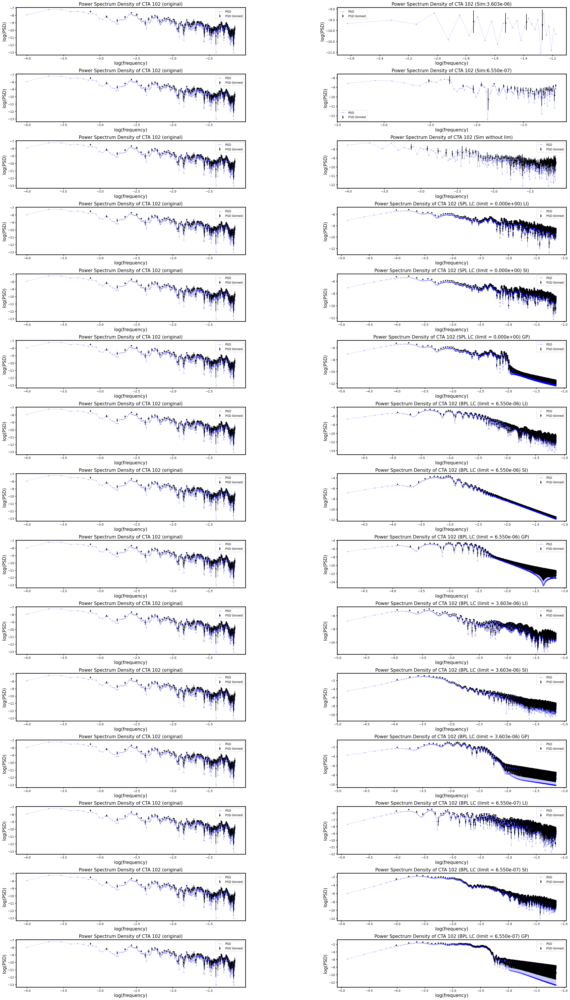

In [41]:
fig2 = plt.figure(figsize=(50, 60))
fig2.set_facecolor('white')
gs = GridSpec(len(BPL_psd), 3, figure=fig2)
plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

for pg in range(len(BPL_psd)):
    if pg != 0:
        g = fig2.add_subplot(gs[pg, 0])
        plot_psd(original_psd['PSD'][0], original_psd['Freq'][0], original_psd['Freqmean'][0], original_psd['PSDb'][0], err_psd, 'Power Spectrum Density of CTA 102 (original)', g)
        g = fig2.add_subplot(gs[pg, 1])
        plot_psd(BPL_psd['PSD'][pg], BPL_psd['Freq'][pg], BPL_psd['Freqmean'][pg], BPL_psd['PSDb'][pg], BPL_psd['err'][pg], 'Power Spectrum Density of CTA 102 ({})'.format(BPL_psd['LC/LC section'][pg]), g)
#         g = fig2.add_subplot(gs[pg, 2])
#         plot_psd(original_psd['PSD'][0] - BPL_psd['PSD'][pg], original_psd['Freq'][0], original_psd['Freqmean'][0], original_psd['PSDb'][0] - BPL_psd['PSDb'][pg], err_psd, 'PSD of CTA 102 ({} - {})'.format(original_psd['LC/LC section'][0], BPL_psd['LC/LC section'][pg]), g)
    

In [42]:
# c_BPL = pd.DataFrame()

# c_BPL['LC/LC section'] = BPL_pdf['LC/LC section'][:].unique()

# def calculate_absolute_error(row):
#     abs_ = abs((original_psd['PSD'].iloc[0] - row) / original_psd['PSD'].iloc[0])
#     abs_ = abs_[~np.isnan(abs_)]
#     return np.mean(100 * abs_)
# def calculate_absolute_error2(row):
#     abs_ = abs((original_pdf['PDFlog'].iloc[0] - row) / original_pdf['PDFlog'].iloc[0])
#     abs_ = abs_[~np.isnan(abs_)]
#     return np.mean(100 * abs_)
# def calculate_absolute_error3(row):
#     abs_ = abs((original_psd['PSDb'].iloc[0] - row) / original_psd['PSDb'].iloc[0])
#     abs_ = abs_[~np.isnan(abs_)]
#     return np.mean(100 * abs_)

# c_BPL['Absolute Error of PSD Regarding Original from FermiLat'] = BPL_psd['PSD'][:].reset_index(drop=True).apply(calculate_absolute_error)
# c_BPL['Absolute Error of PSD binned Regarding Original from FermiLat'] = BPL_psd['PSDb'][:].reset_index(drop=True).apply(calculate_absolute_error3)
# c_BPL['Absolute Error of logPDF Regarding Original from FermiLat'] = BPL_pdf['PDFlog'][:].reset_index(drop=True).apply(calculate_absolute_error2)
# c_BPL

# CPL and CPL removed vs CPL interpolated and removed:

In [43]:
CPL_psd = data_psd.loc[13:16].append(data_psd.loc[53:])
CPL_psd = CPL_psd.reset_index(drop = True)
CPL_pdf = data_pdfs.loc[13:16].append(data_pdfs.loc[53:])
CPL_pdf = CPL_pdf.reset_index(drop = True)

/tmp/ipykernel_7667/1873587042.py:1: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  CPL_psd = data_psd.loc[13:16].append(data_psd.loc[53:])
/tmp/ipykernel_7667/1873587042.py:3: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  CPL_pdf = data_pdfs.loc[13:16].append(data_pdfs.loc[53:])


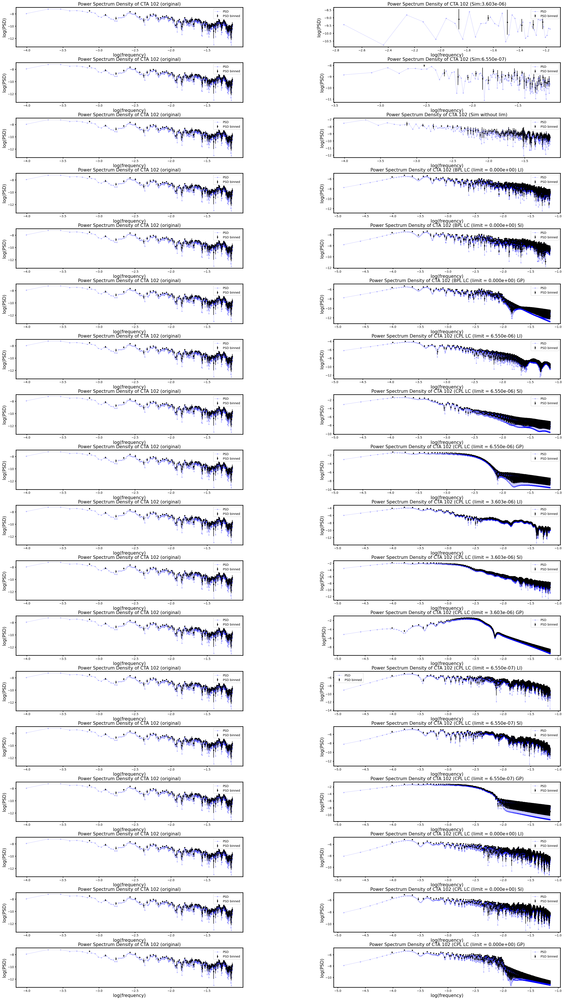

In [44]:
fig2 = plt.figure(figsize=(50, 60))
fig2.set_facecolor('white')
gs = GridSpec(len(CPL_psd), 3, figure=fig2)
plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

for pg in range(len(CPL_psd)):
    if pg != 0:
        g = fig2.add_subplot(gs[pg, 0])
        plot_psd(original_psd['PSD'][0], original_psd['Freq'][0], original_psd['Freqmean'][0], original_psd['PSDb'][0], err_psd, 'Power Spectrum Density of CTA 102 (original)', g)
        g = fig2.add_subplot(gs[pg, 1])
        plot_psd(CPL_psd['PSD'][pg], CPL_psd['Freq'][pg], CPL_psd['Freqmean'][pg], CPL_psd['PSDb'][pg], CPL_psd['err'][pg], 'Power Spectrum Density of CTA 102 ({})'.format(CPL_psd['LC/LC section'][pg]), g)
#         g = fig2.add_subplot(gs[pg, 2])
#         plot_psd(original_psd['PSD'][0] - CPL_psd['PSD'][pg], original_psd['Freq'][0], original_psd['Freqmean'][0], original_psd['PSDb'][0] - CPL_psd['PSDb'][pg], err_psd, 'PSD of CTA 102 ({} - {})'.format(original_psd['LC/LC section'][0], CPL_psd['LC/LC section'][pg]), g)
    

In [45]:
# c_CPL = pd.DataFrame()

# c_CPL['LC/LC section'] = CPL_pdf['LC/LC section'][:].unique()

# def calculate_absolute_error(row):
#     abs_ = abs((original_psd['PSD'].iloc[0] - row) / original_psd['PSD'].iloc[0])
#     abs_ = abs_[~np.isnan(abs_)]
#     return np.mean(100 * abs_)
# def calculate_absolute_error2(row):
#     abs_ = abs((original_pdf['PDFlog'].iloc[0] - row) / original_pdf['PDFlog'].iloc[0])
#     abs_ = abs_[~np.isnan(abs_)]
#     return np.mean(100 * abs_)
# def calculate_absolute_error3(row):
#     abs_ = abs((original_psd['PSDb'].iloc[0] - row) / original_psd['PSDb'].iloc[0])
#     abs_ = abs_[~np.isnan(abs_)]
#     return np.mean(100 * abs_)

# c_CPL['Absolute Error of PSD Regarding Original from FermiLat'] = CPL_psd['PSD'][:].reset_index(drop=True).apply(calculate_absolute_error)
# c_CPL['Absolute Error of PSD binned Regarding Original from FermiLat'] = CPL_psd['PSDb'][:].reset_index(drop=True).apply(calculate_absolute_error3)

# c_CPL['Absolute Error of logPDF Regarding Original from FermiLat'] = CPL_pdf['PDFlog'][:].reset_index(drop=True).apply(calculate_absolute_error2)
# c_CPL

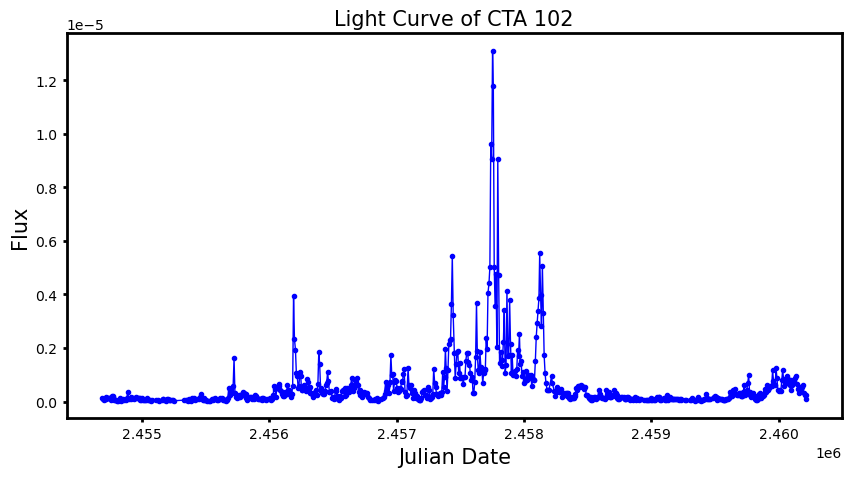

In [46]:
fig, g = plt.subplots(figsize=(10, 5))
fig.set_facecolor('white')
g.plot(CTAdata['Julian Date'], CTAdata['Photon Flux [0.1-100 GeV](photons cm-2 s-1)'],'b-o',linewidth=1, markersize = 3)
g.set_ylabel('Flux',fontsize=15)
g.set_xlabel('Julian Date',fontsize=15)
plt.title('Light Curve of CTA 102',fontsize=15)
for spine in ['top', 'right','bottom','left']:
    g.spines[spine].set_linewidth(2)
g.tick_params(labelsize=10,length=3,width=2)